In [1]:
############
# This script compares in-situ measurements at stations in the Seyhan basin, Turkey, with measurments extracted 
# those points via CHIRPS 
############

In [2]:
##### load necessary packages 

import json 
import csv
import pandas as pd 
from pandas.io.json import json_normalize
import json
from datetime import datetime
import re
import numpy as np
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
import matplotlib.pyplot as plt
import datetime
import os
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from matplotlib.dates import DateFormatter
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()
import math
from functools import reduce
import pandas as pd
import numpy as np
import pytz
from sklearn.linear_model import LinearRegression
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import datetime
import os
import matplotlib.pyplot as plt
from matplotlib.dates import DateFormatter
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()
from matplotlib.dates import date2num
import math
from functools import reduce
import sklearn
from standard_precip.spi import SPI
from standard_precip.utils import plot_index

In [3]:
########## define standard fig size 

# get current size
fig_size = plt.rcParams["figure.figsize"]
print ("Current size:", fig_size)
# let's make the plots a bit bigger than the default
# set figure width to 14 and height to 6
fig_size[0] = 14
fig_size[1] = 6
plt.rcParams["figure.figsize"] = fig_size
plt.tight_layout()
plt.rcParams['font.size'] = '16'
print ("Current size:", fig_size)

Current size: [6.0, 4.0]
Current size: [14, 6]


<Figure size 1008x432 with 0 Axes>

In [4]:
##### list of station names 


stationlist = ['D18M019', 'D18M018', 'D18M013', 'D18M012', 'D18M011', 'D18M004', 'D18M003', '17981', '17936', '17934', '17906', '17840', '17837', '17802', '17351','06902', '06893', '06560', '06204']





/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:338: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


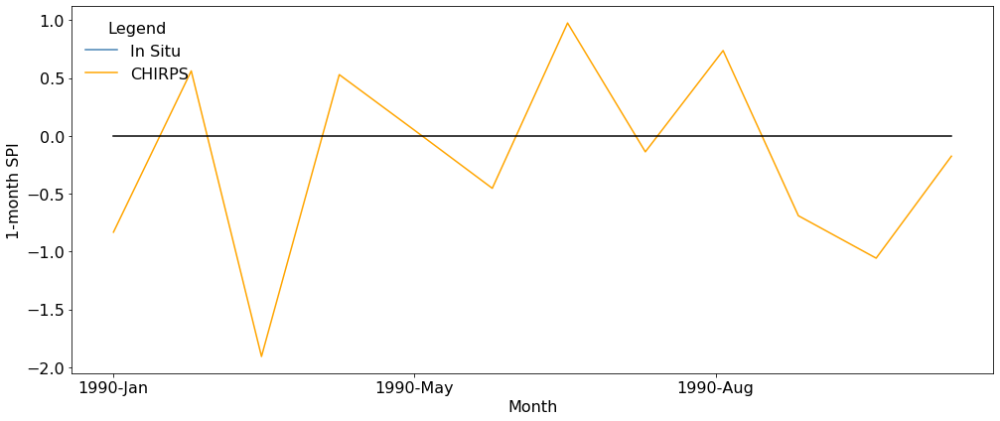

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:385: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


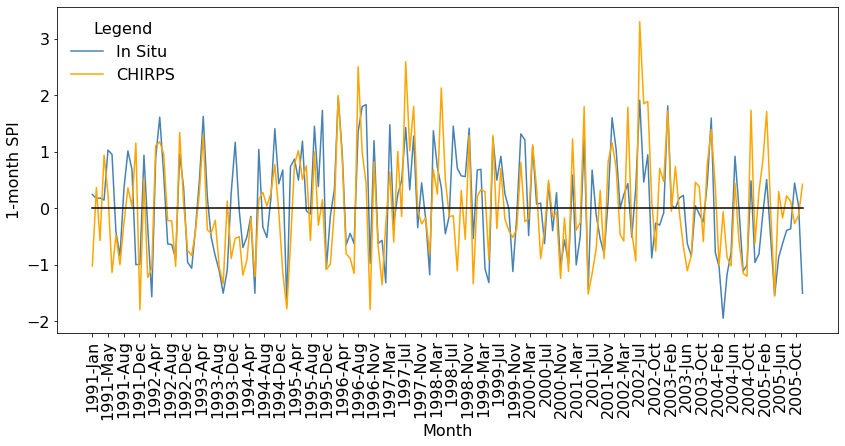

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:440: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


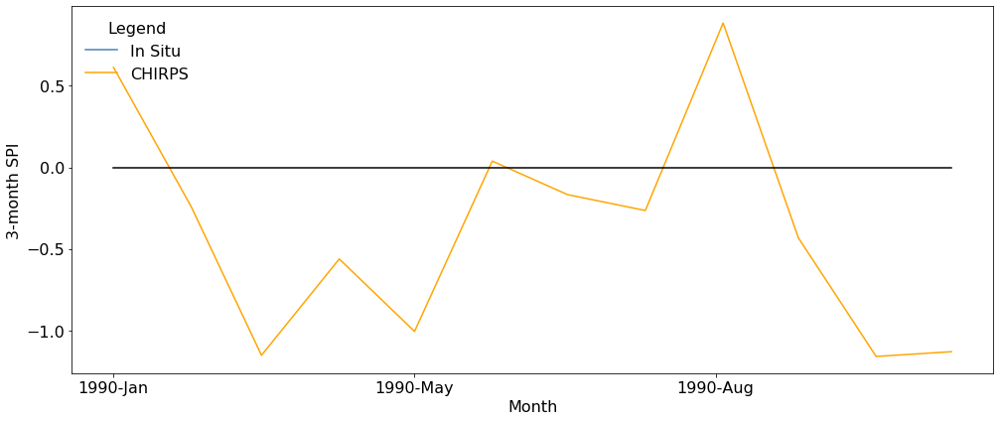

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:488: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


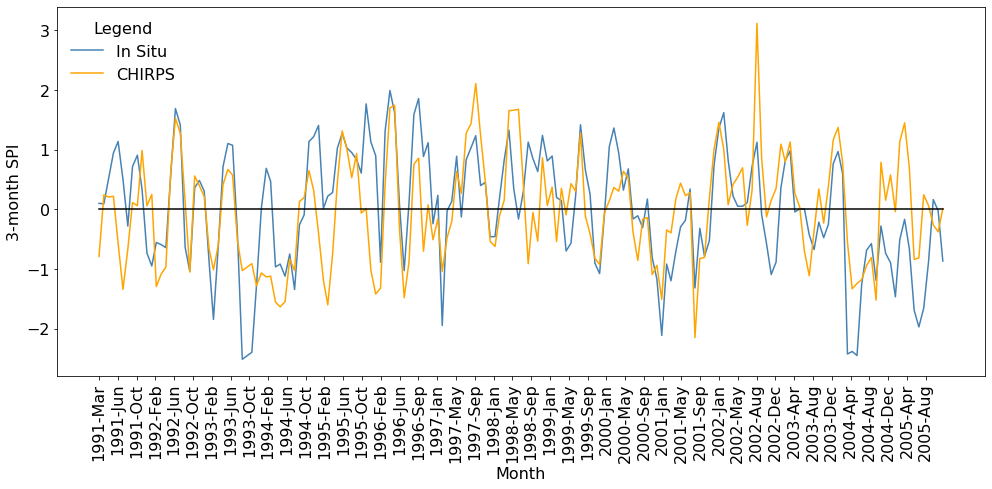

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


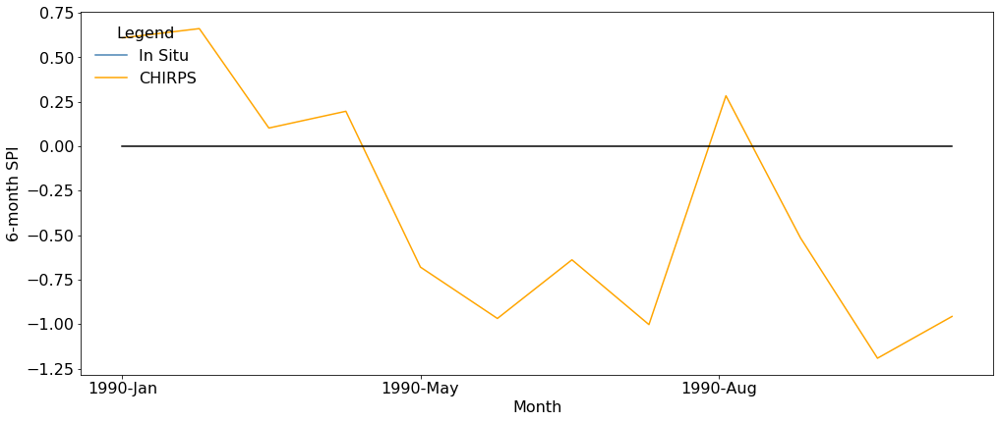

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:591: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


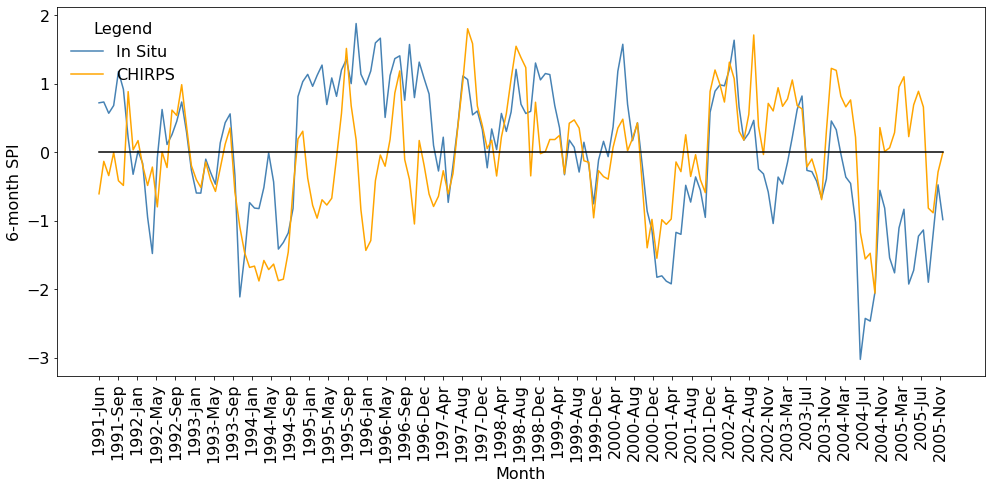

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:646: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


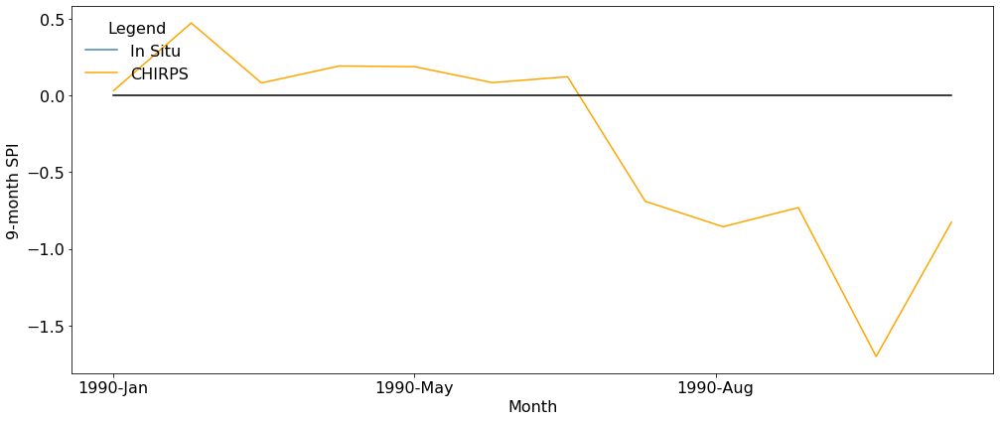

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:694: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


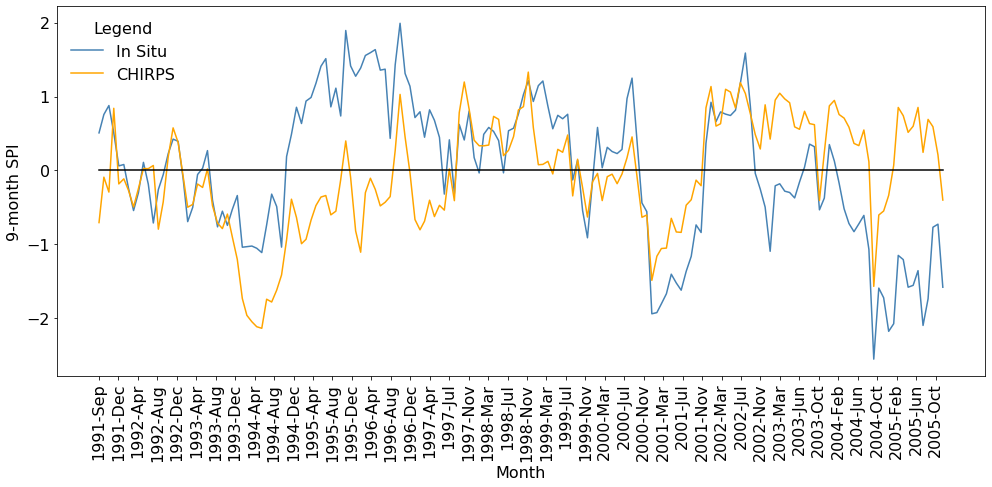

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:749: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


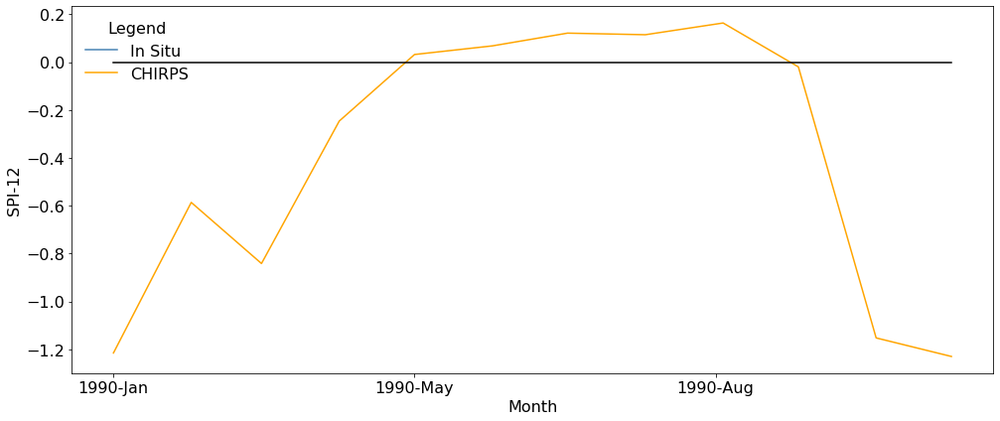

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:798: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


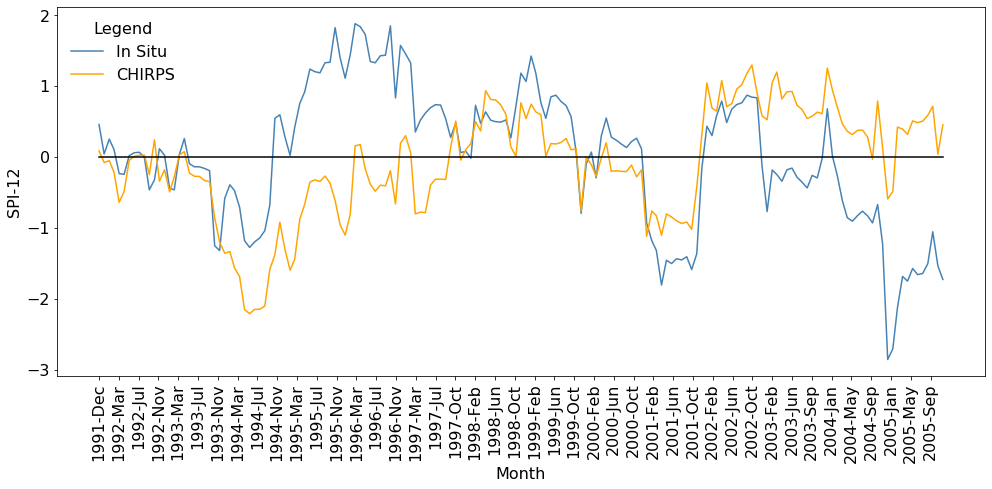

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


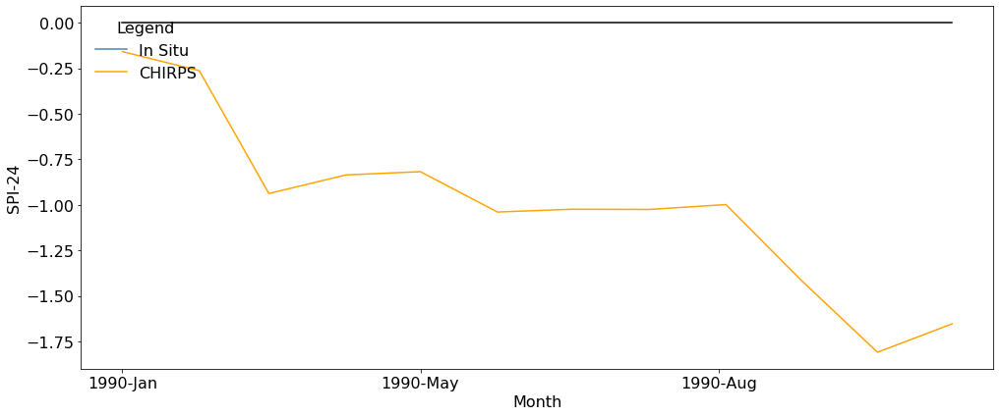

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


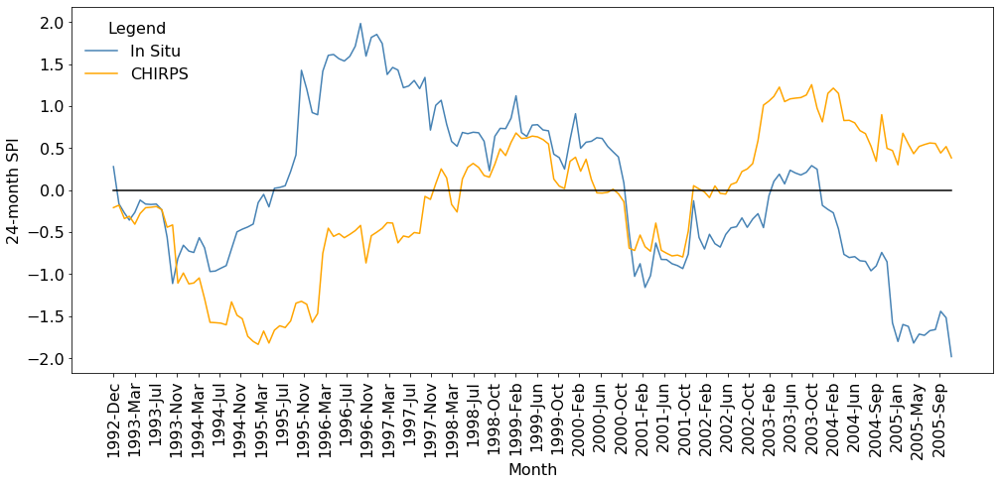

D18M019
done
 


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:338: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


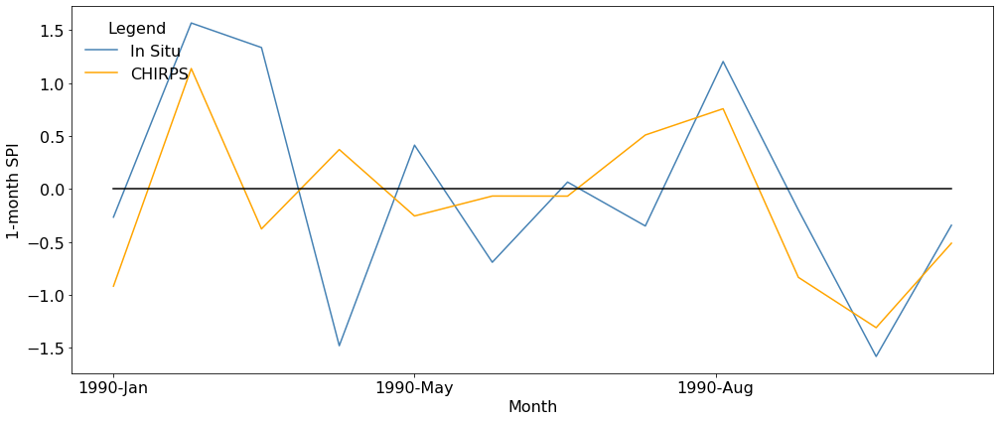

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:385: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


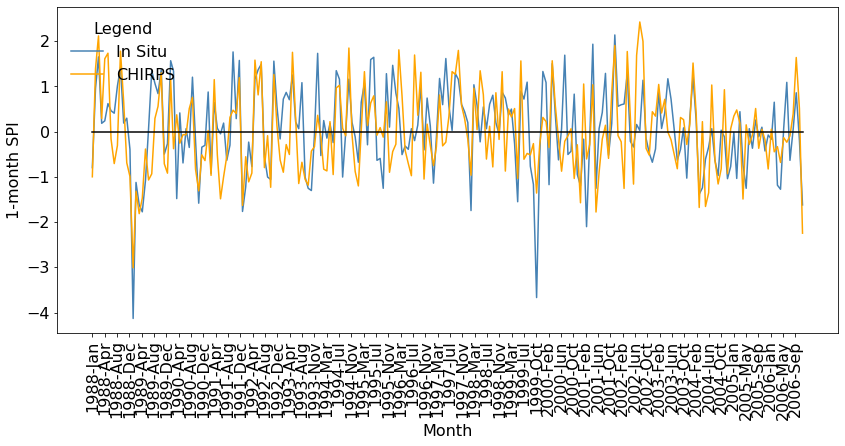

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:440: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


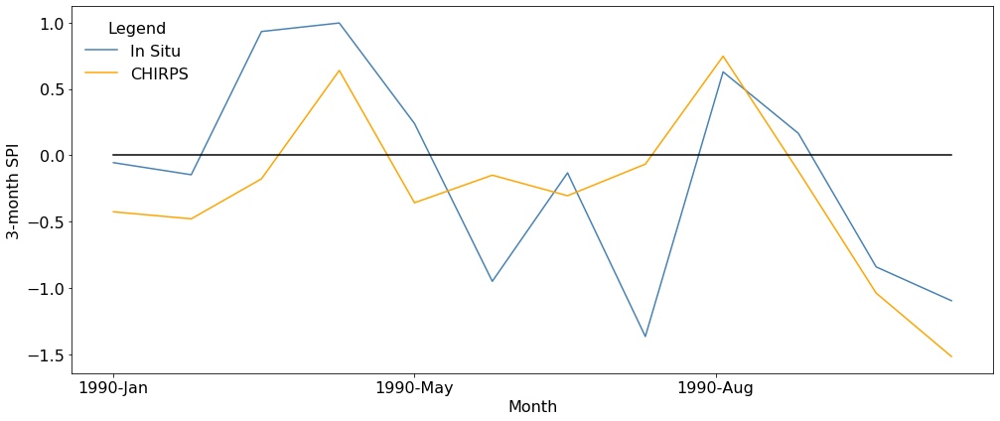

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:488: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


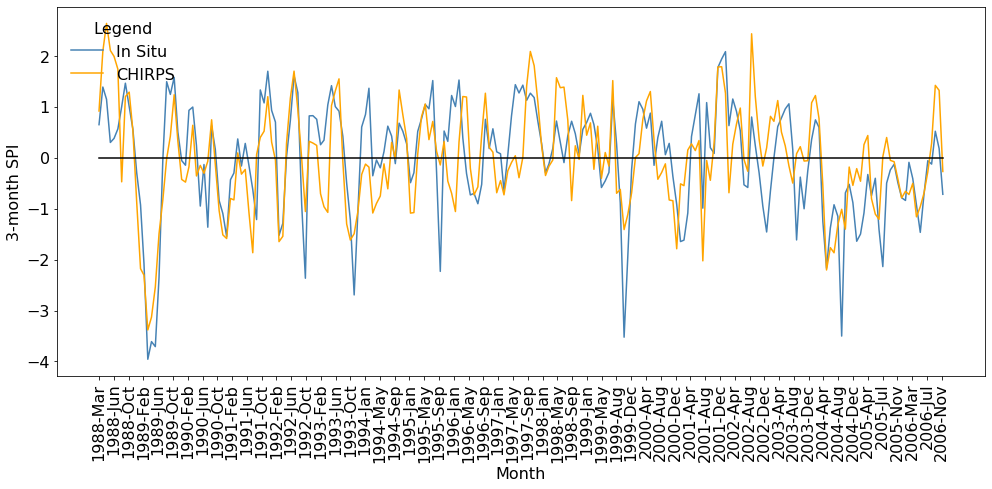

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


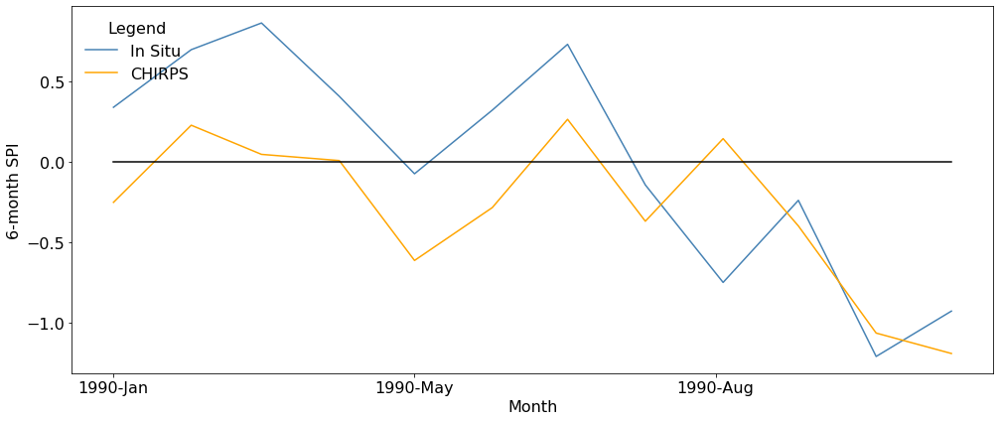

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:591: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


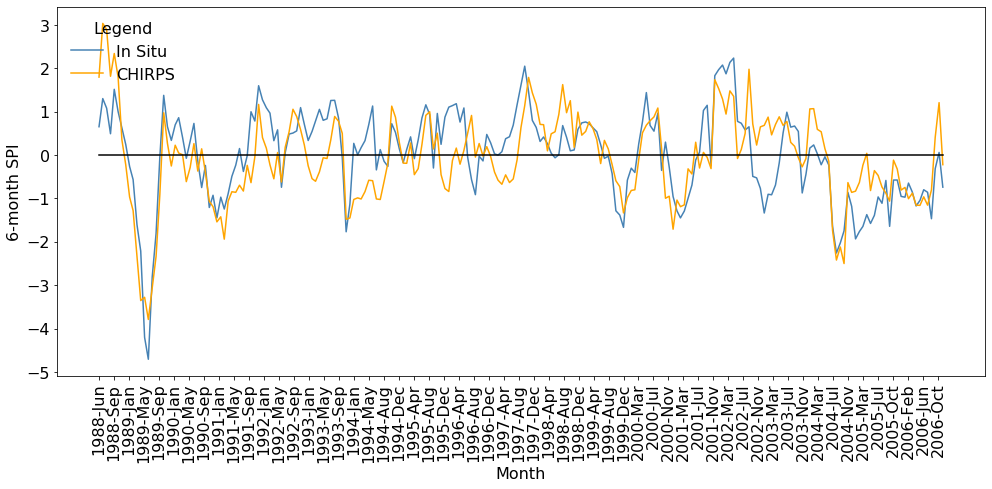

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:646: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


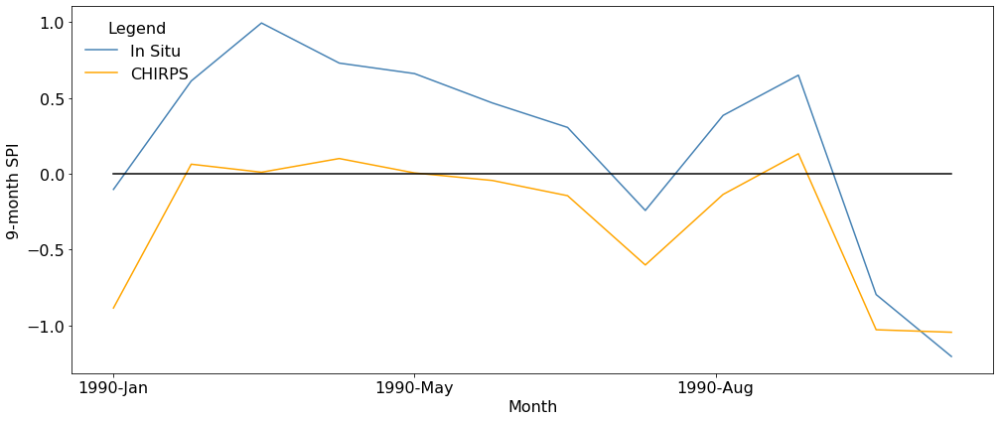

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:694: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


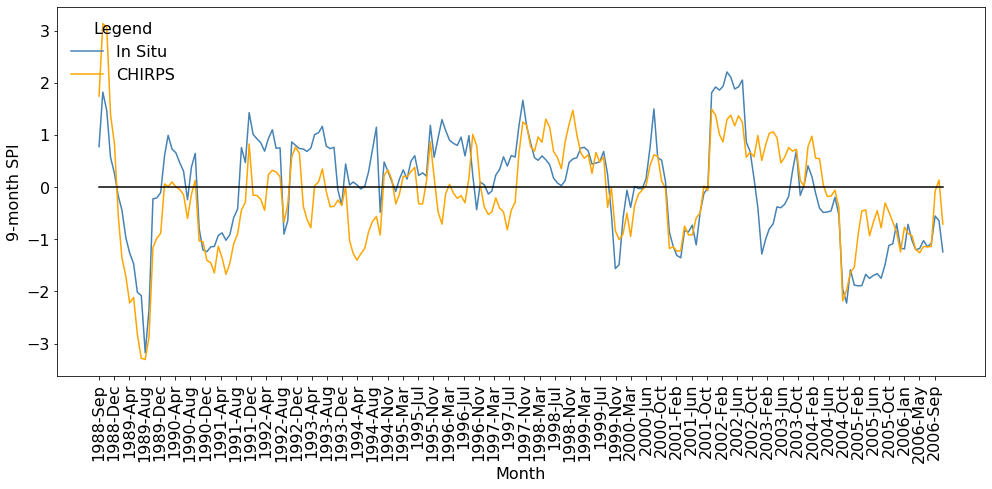

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:749: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


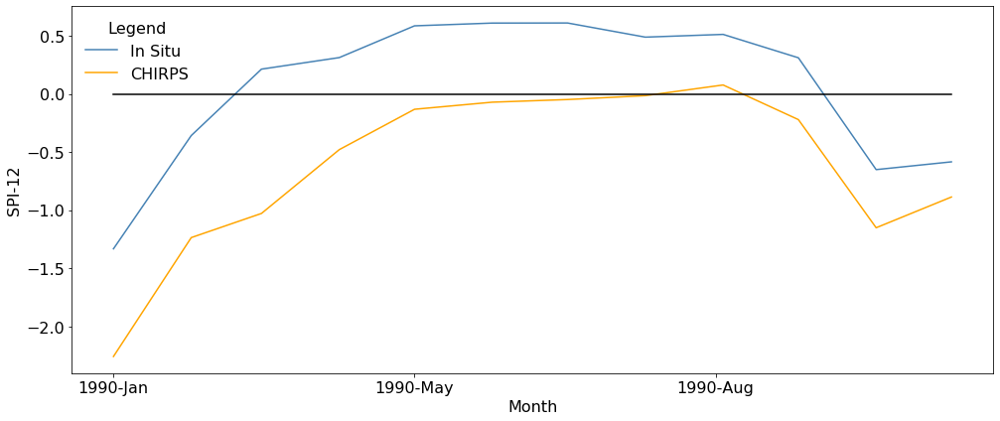

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:798: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


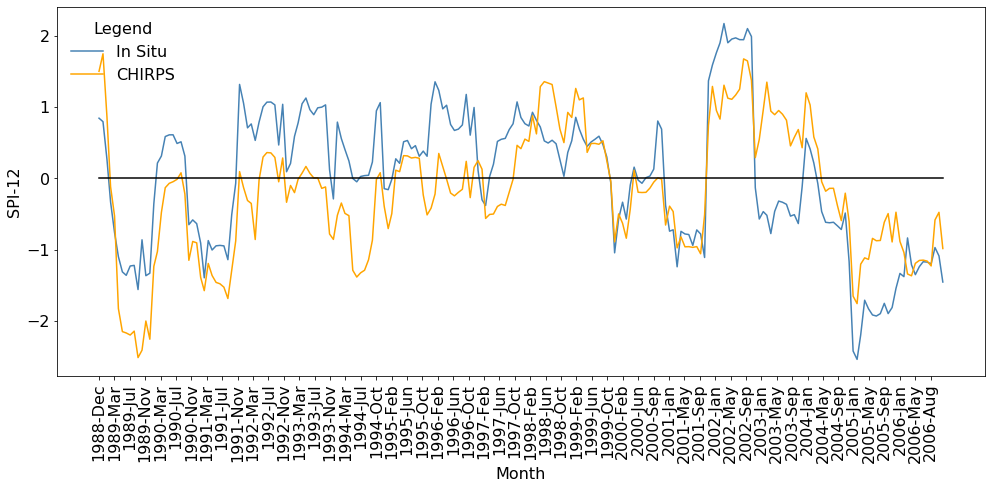

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


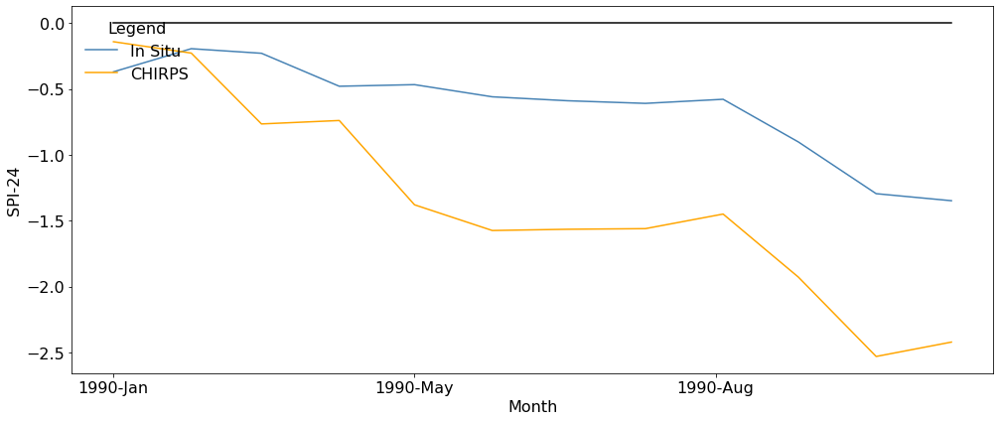

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


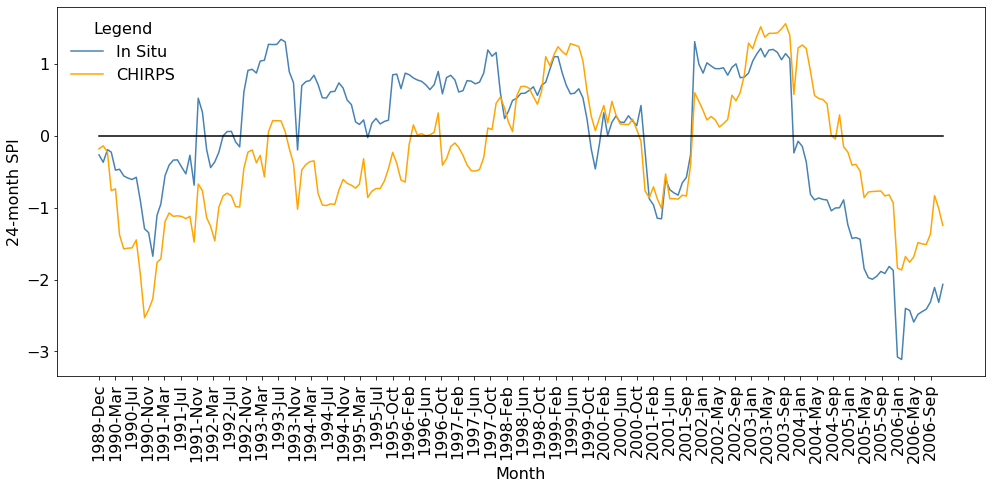

D18M018
done
 


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:338: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


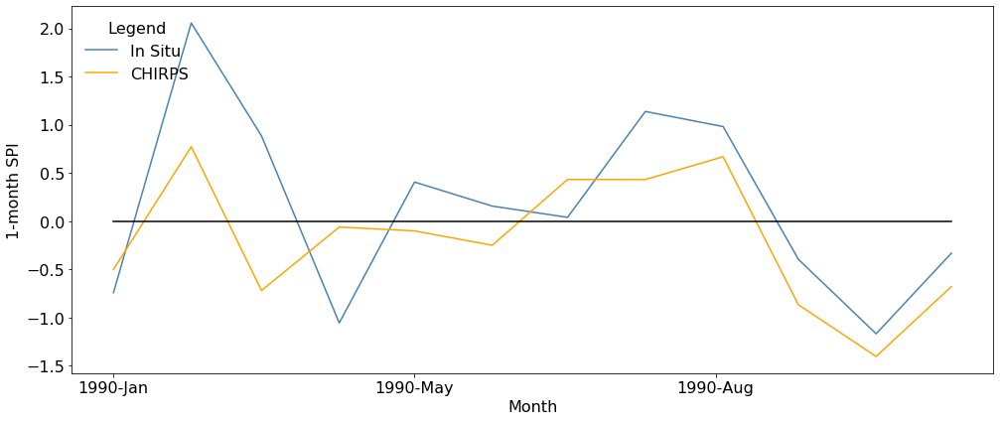

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:385: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


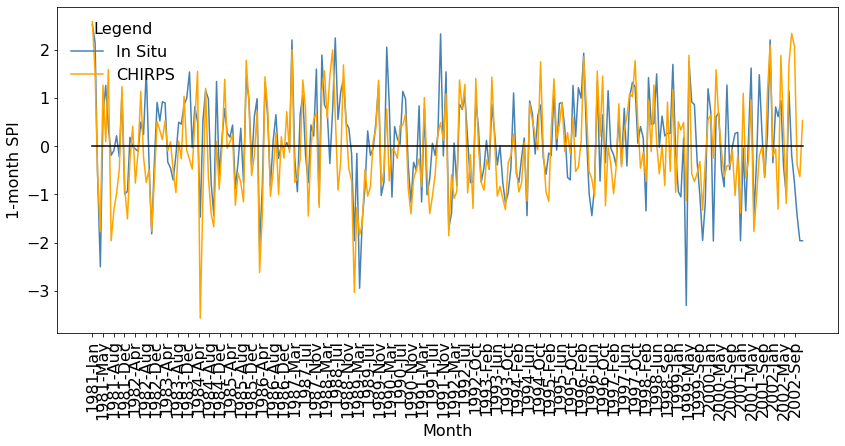

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:440: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


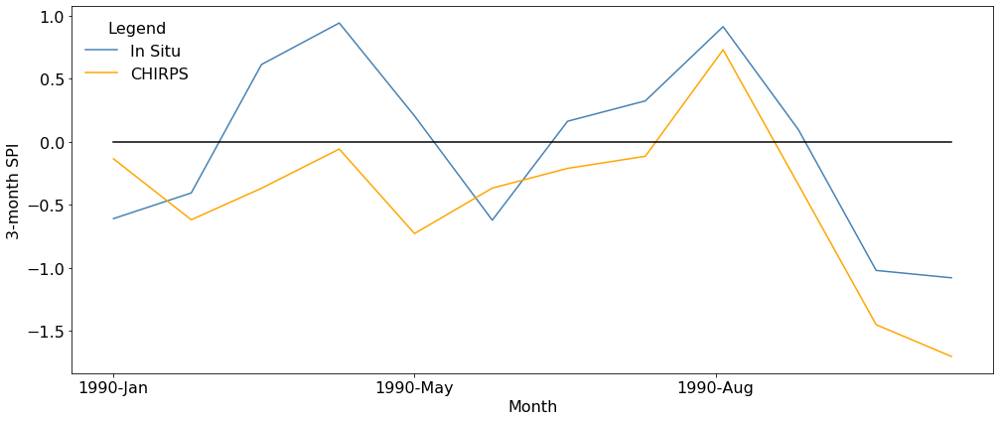

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:488: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


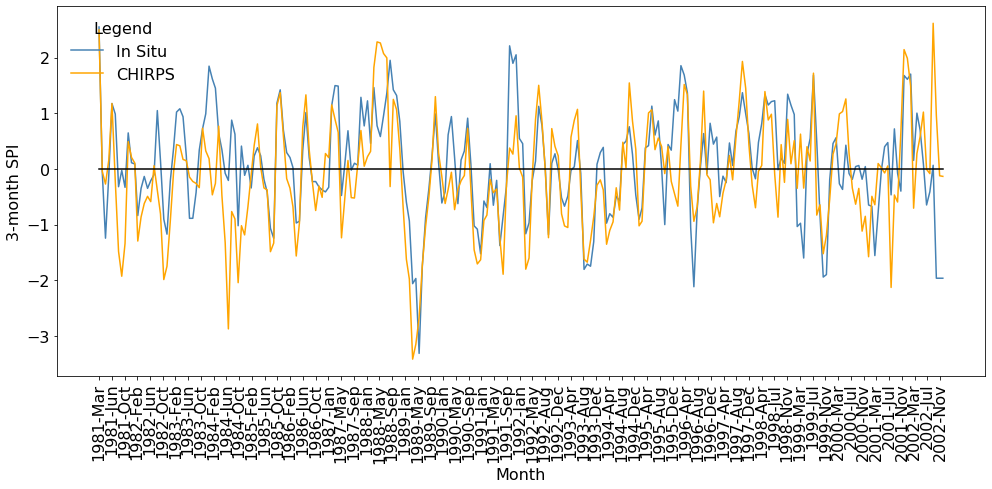

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


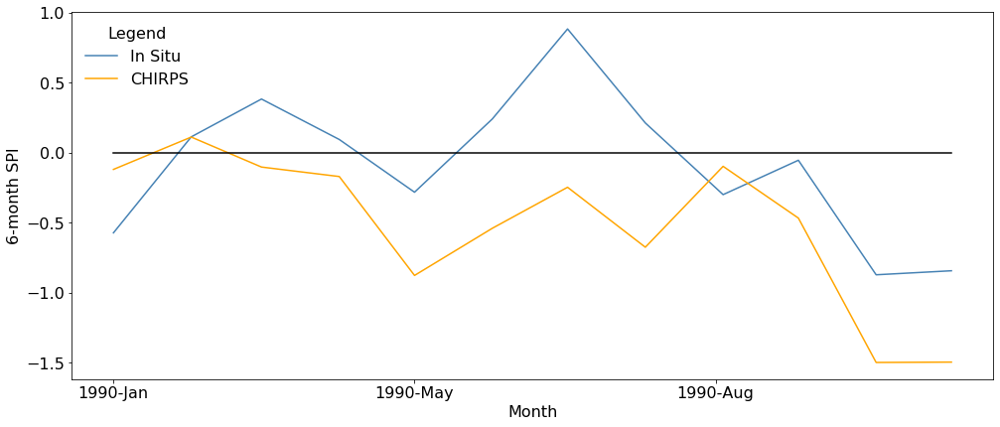

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:591: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


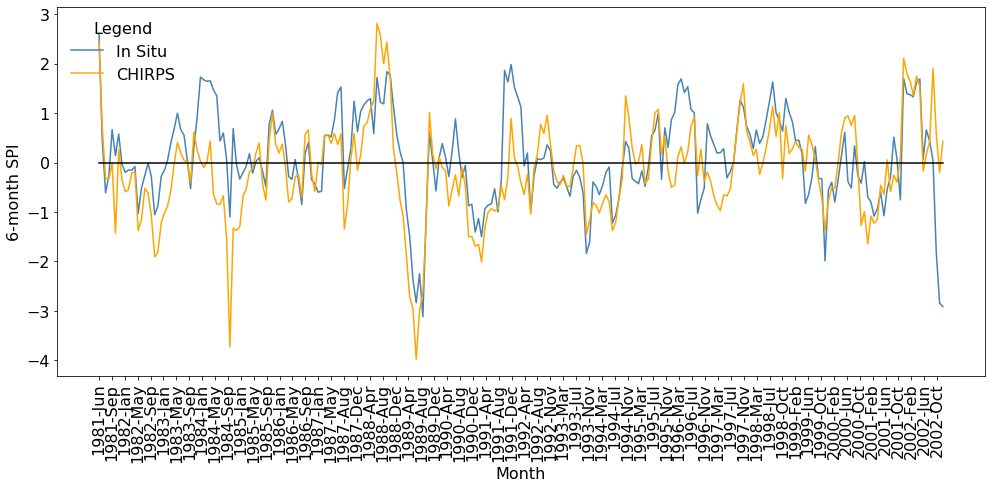

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:646: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


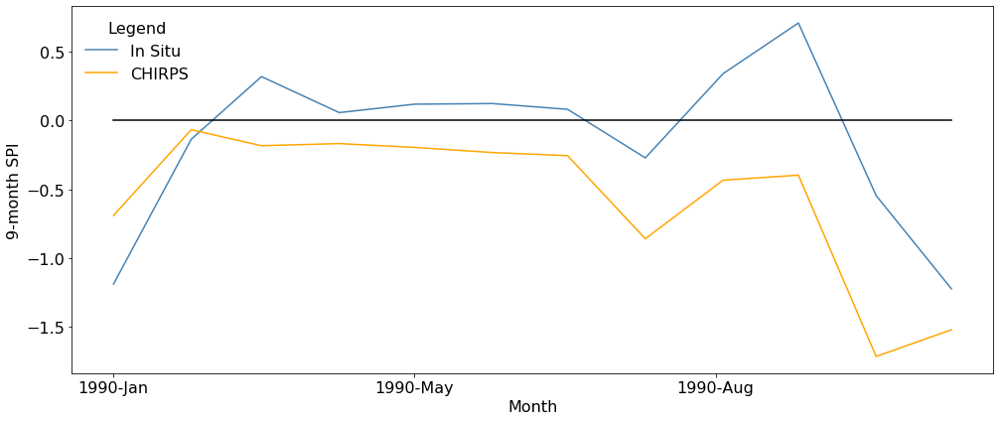

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:694: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


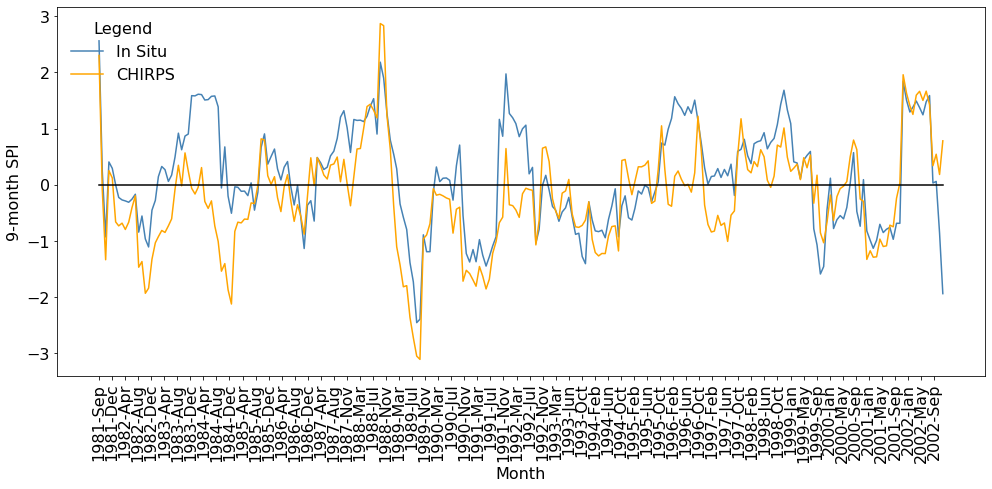

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:749: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


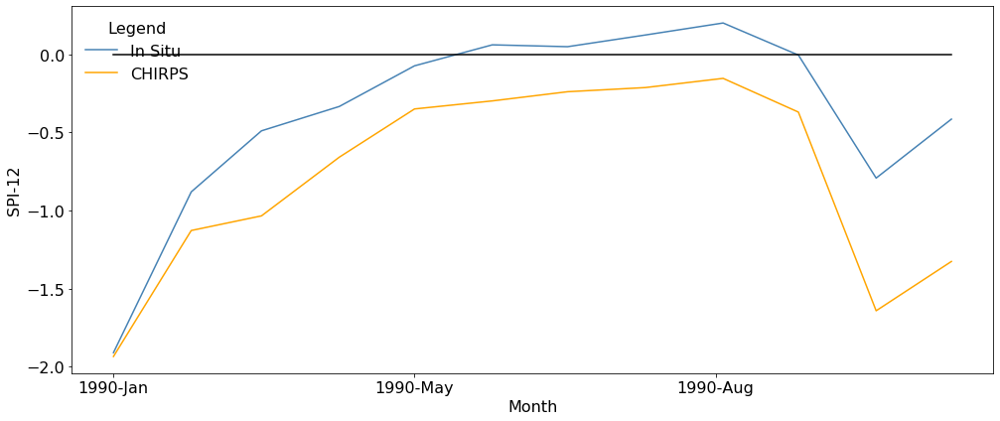

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:798: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


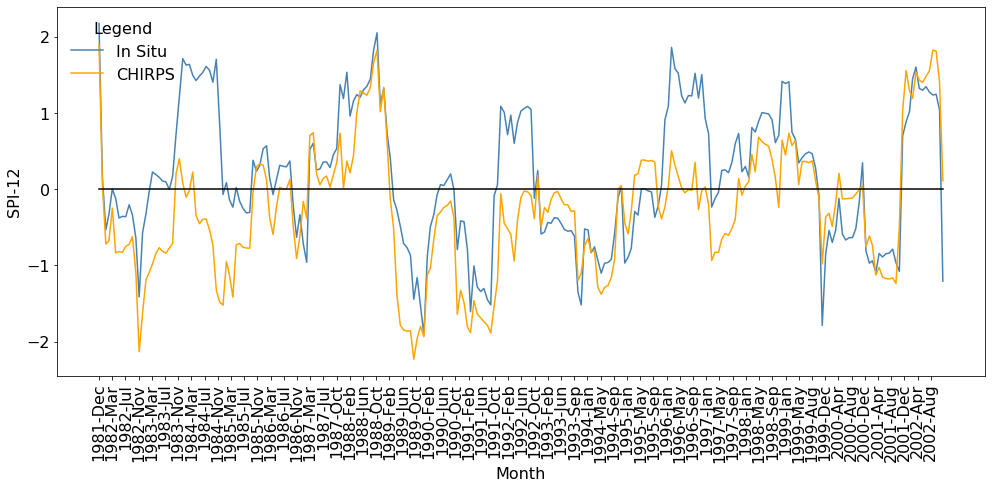

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


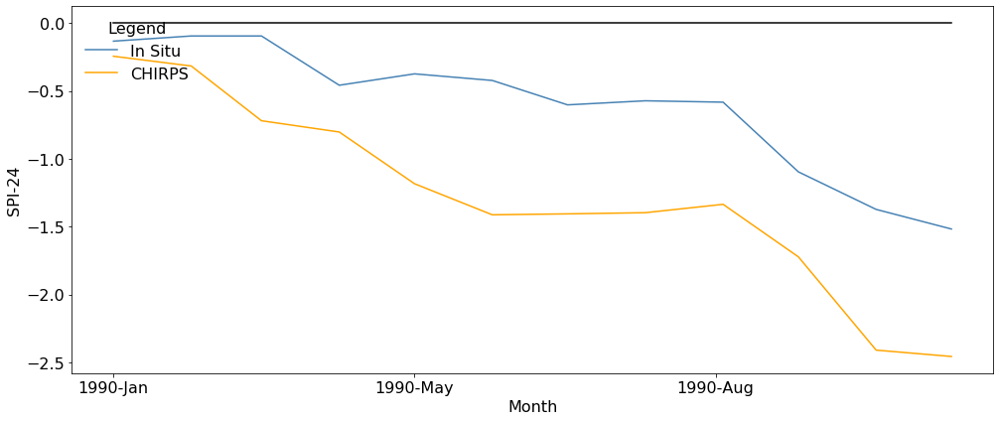

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


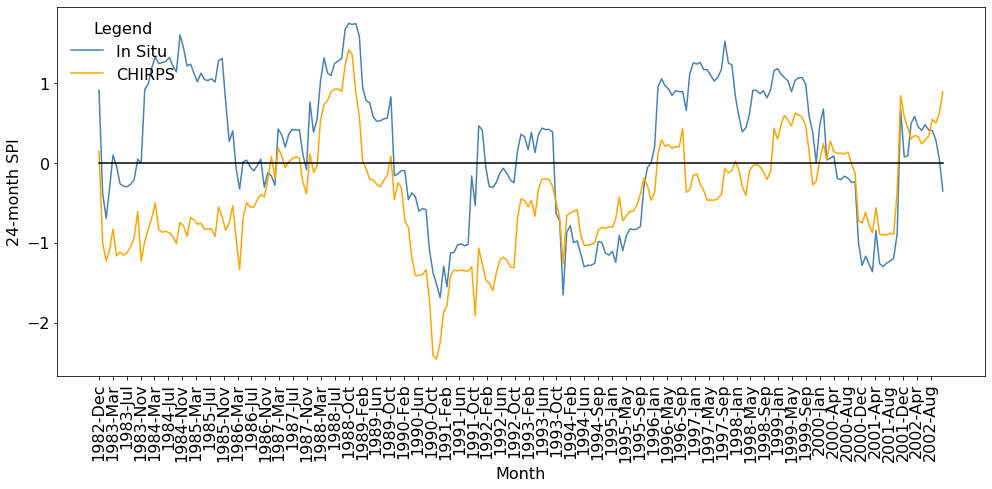

D18M013
done
 


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:338: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


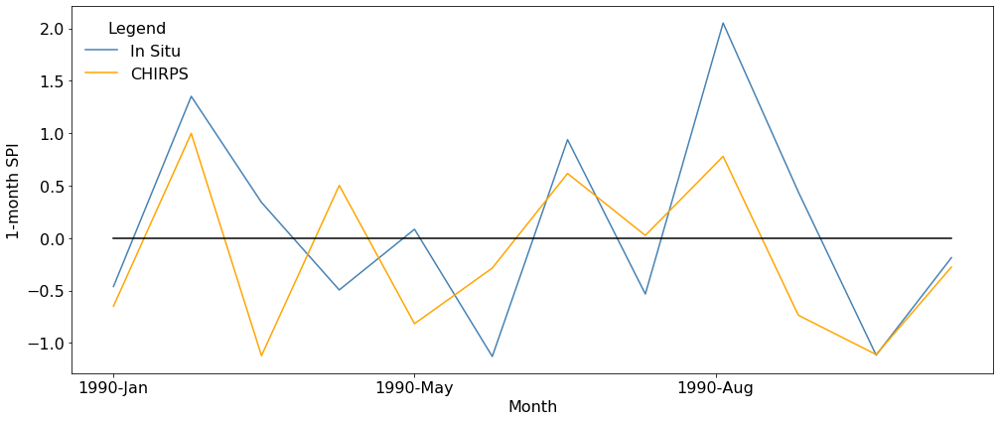

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:385: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


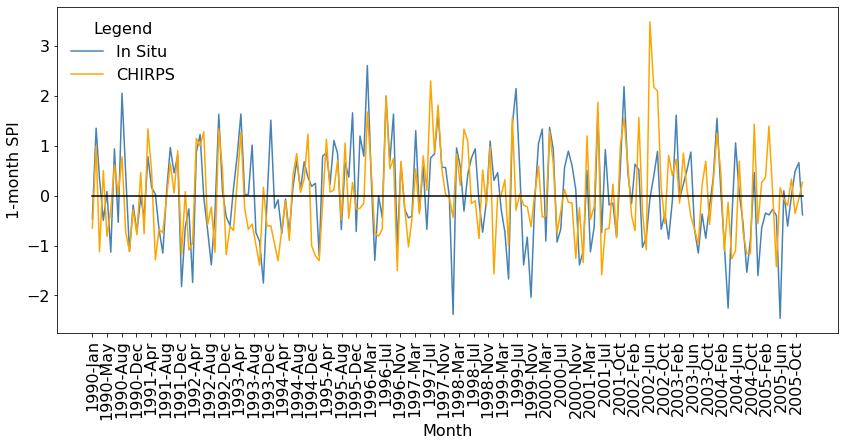

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:440: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


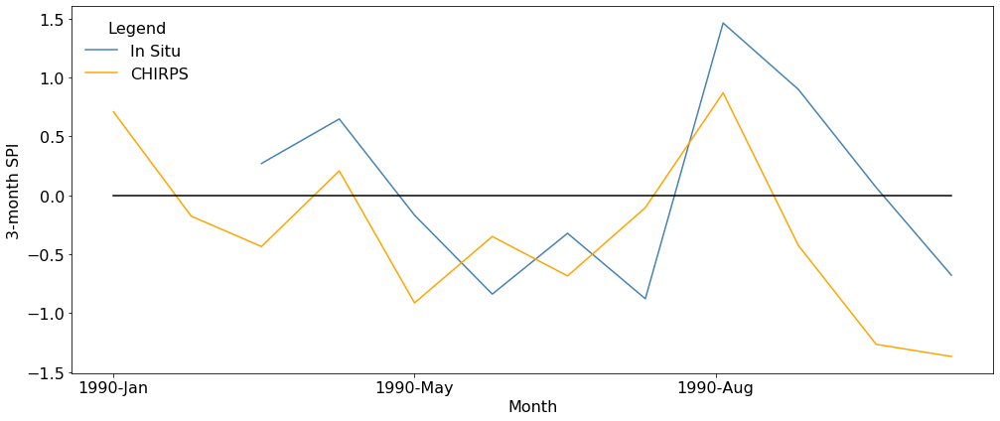

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:488: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


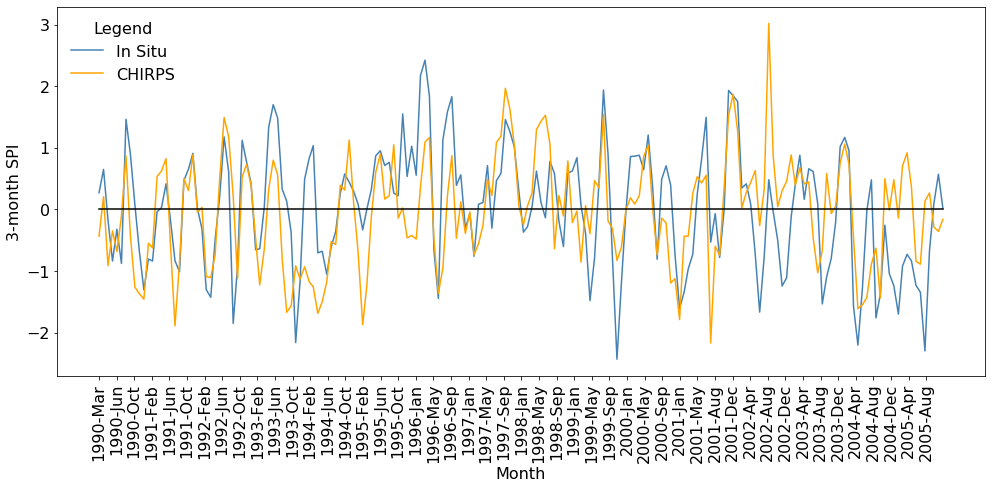

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


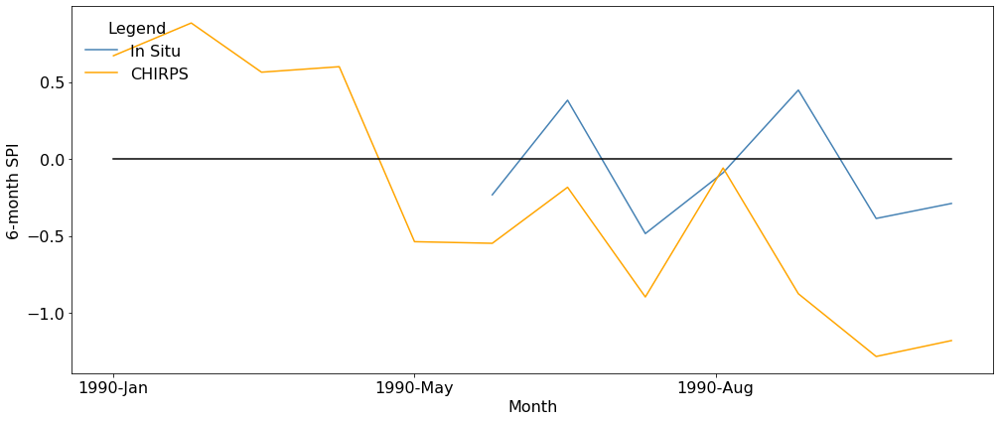

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:591: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


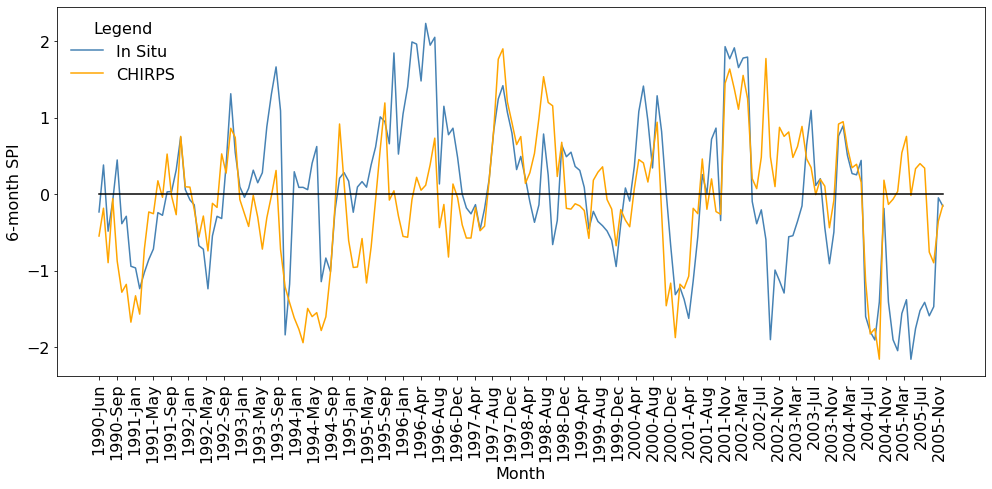

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:646: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


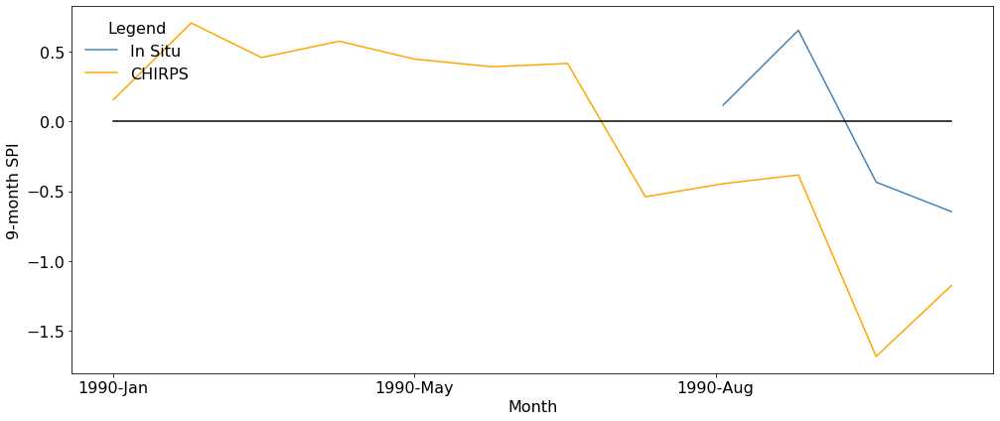

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:694: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


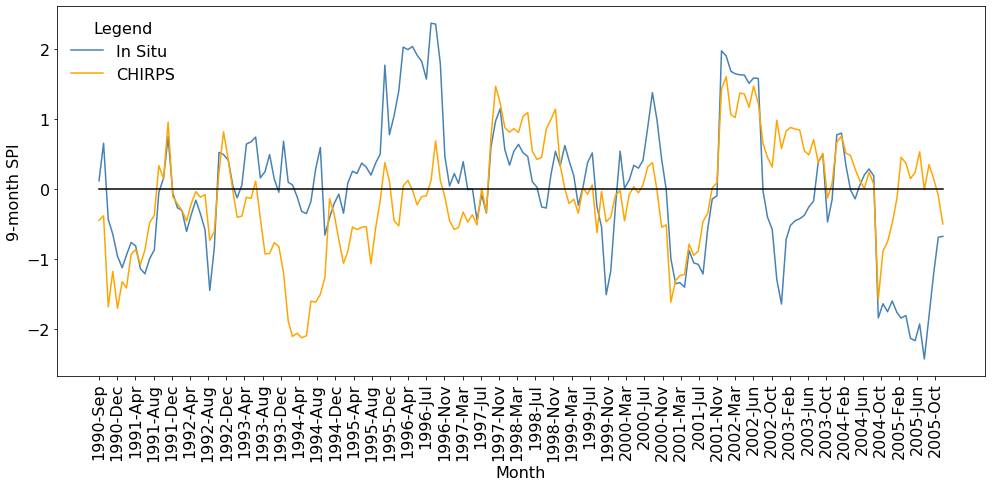

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:749: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


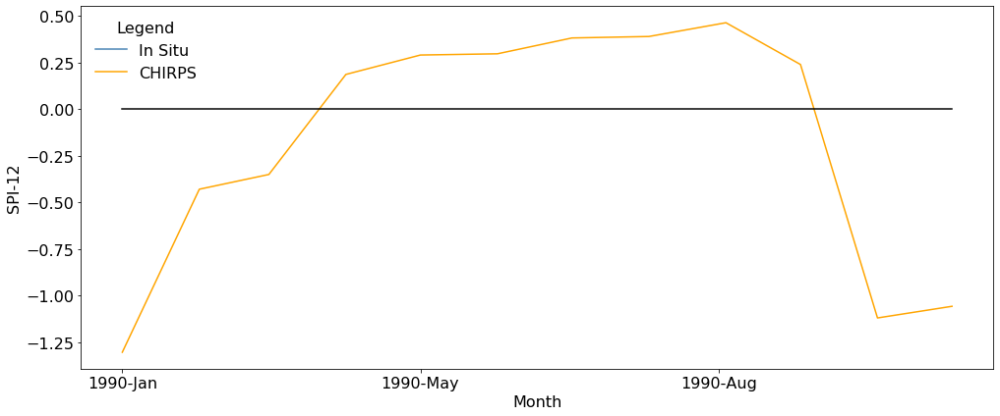

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:798: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


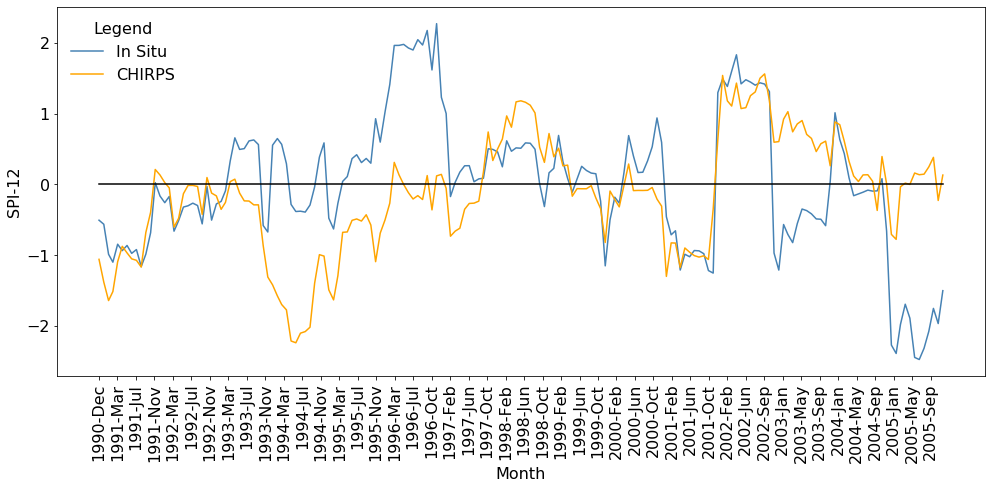

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


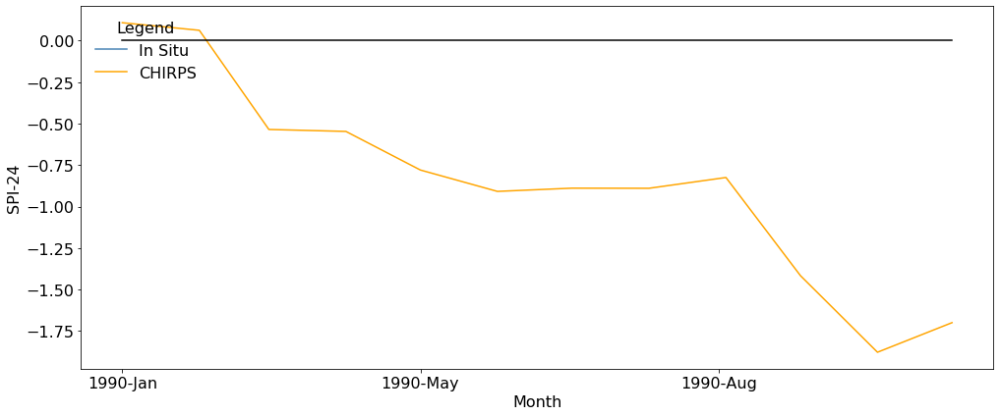

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


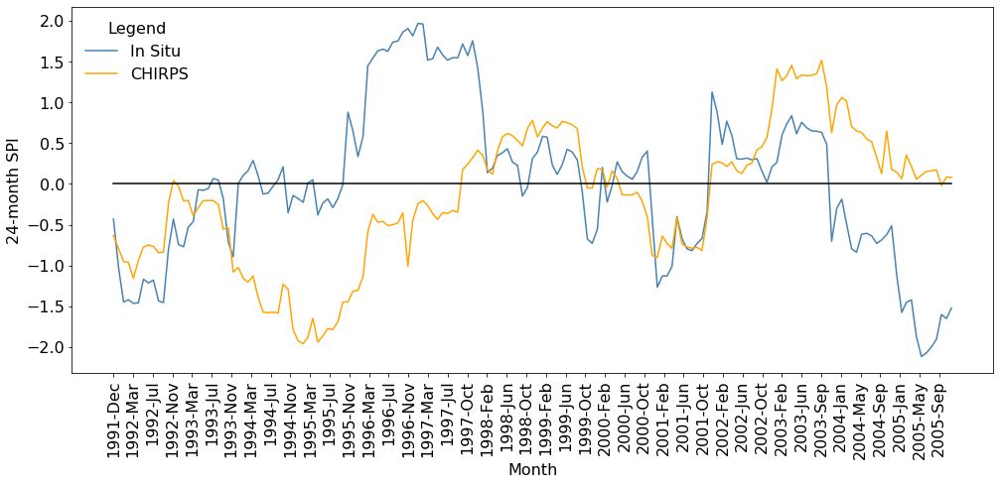

D18M012
done
 


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:338: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


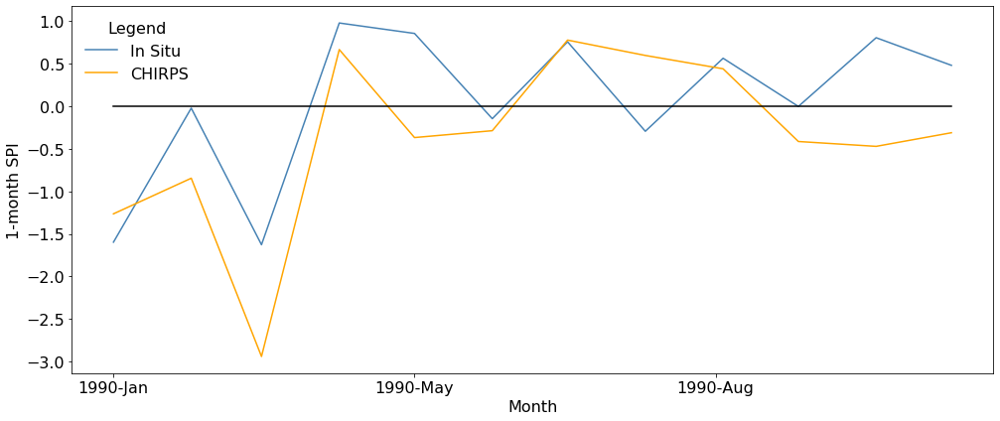

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:385: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


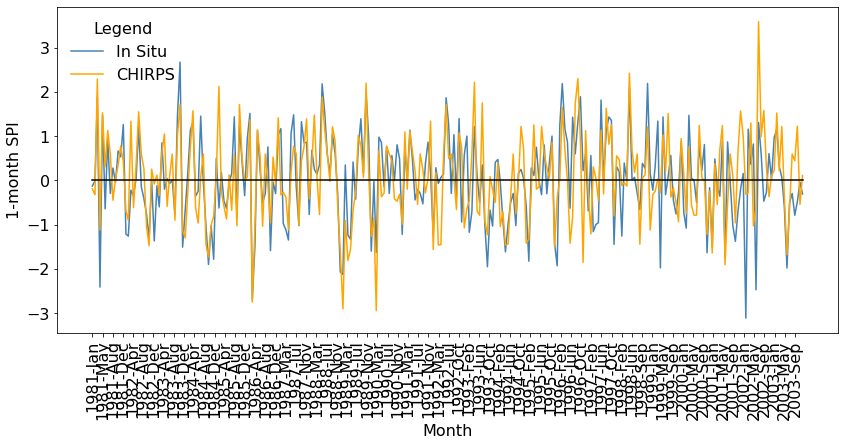

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:440: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


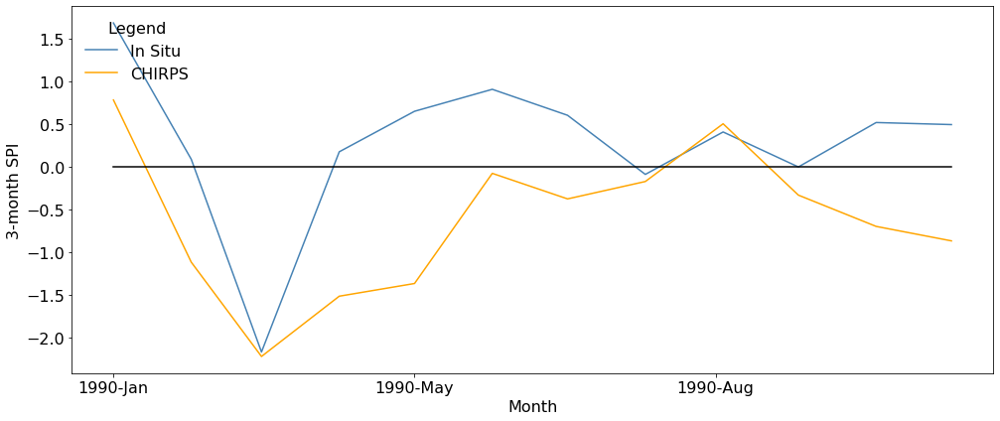

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:488: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


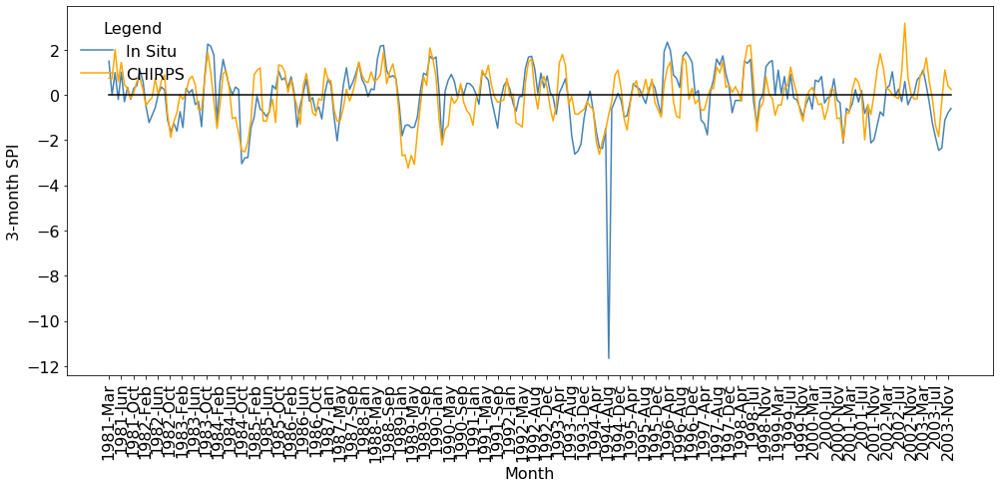

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


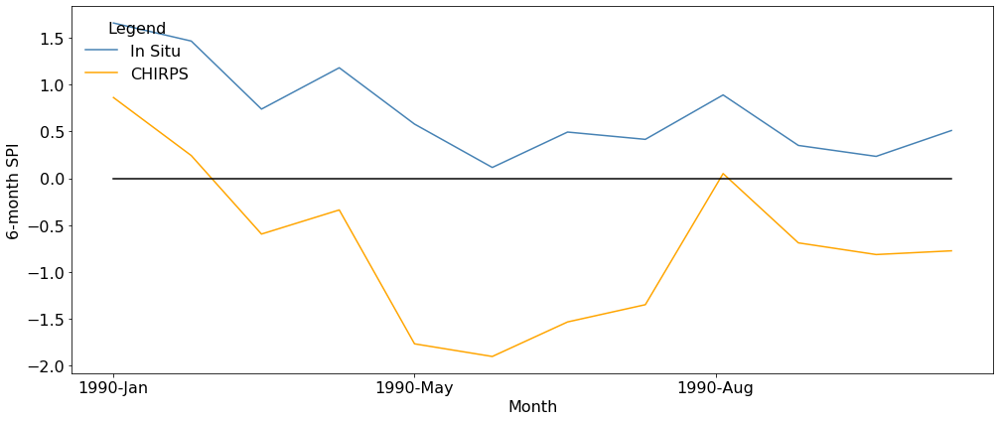

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:591: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


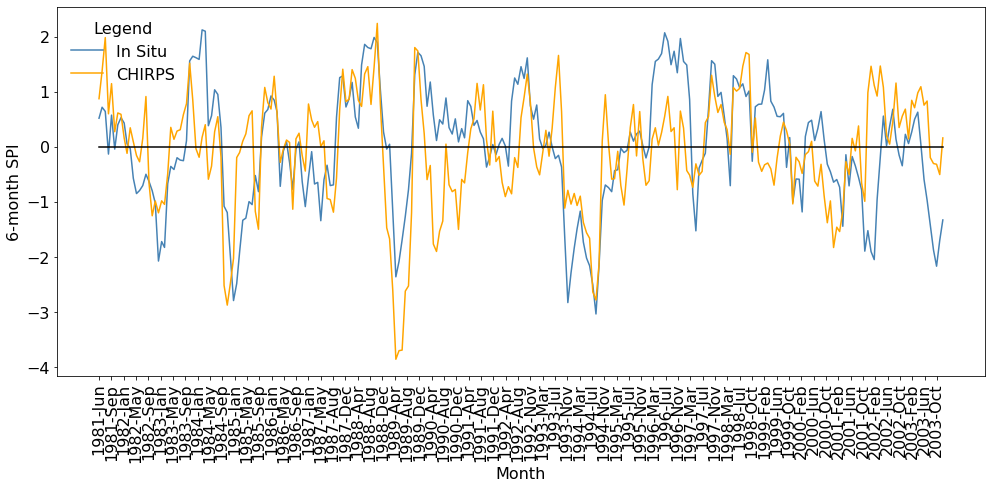

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:646: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


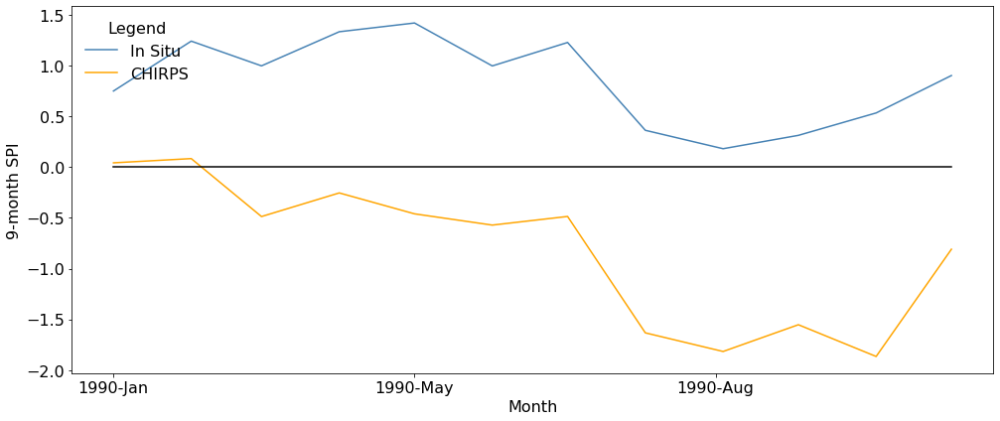

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:694: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


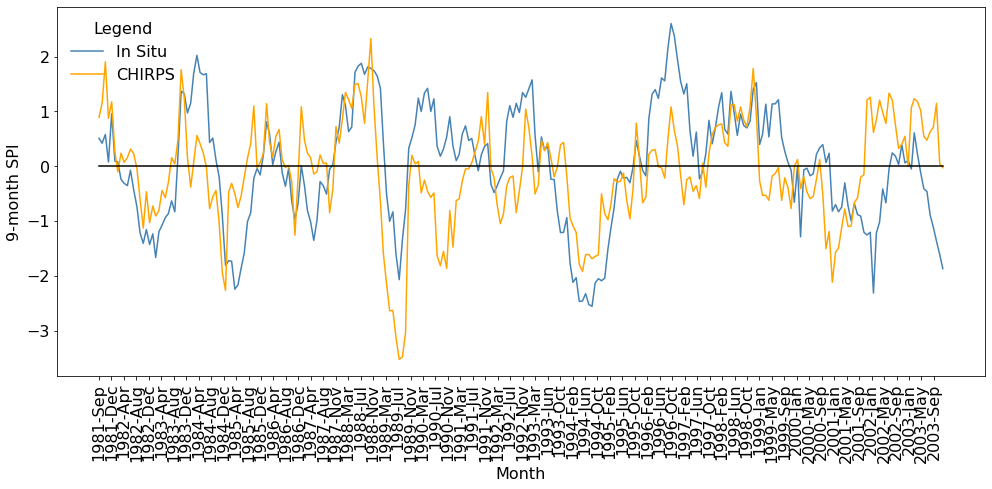

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:749: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


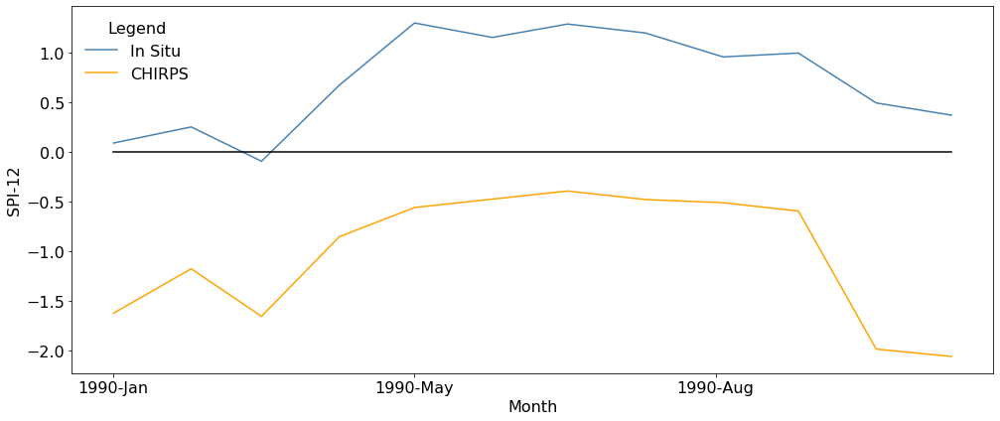

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:798: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


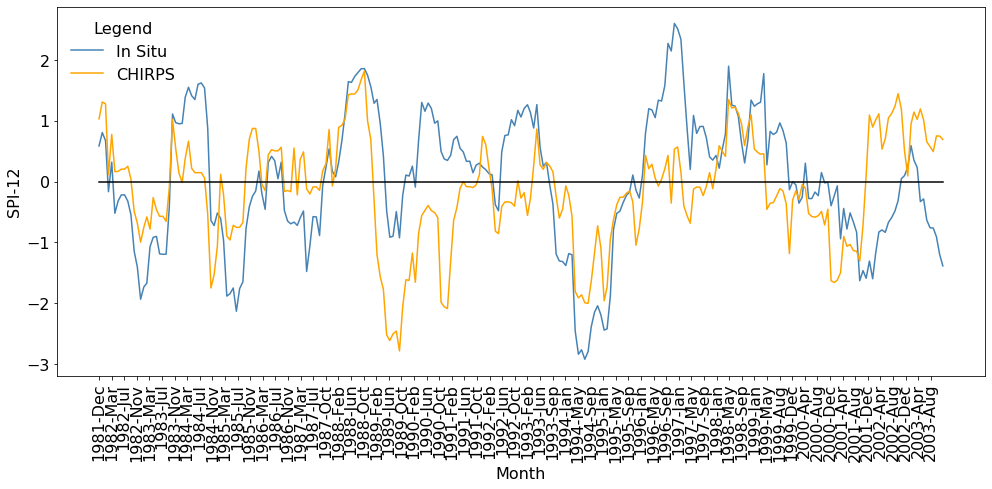

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


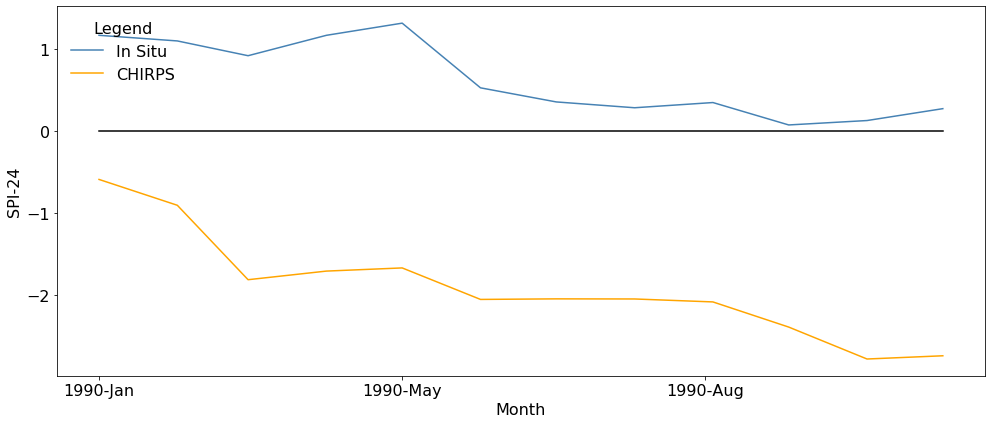

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


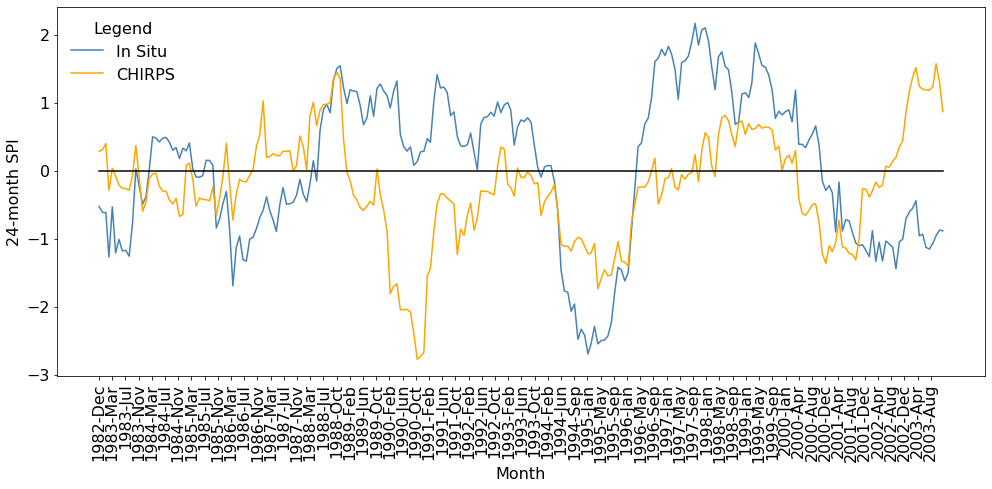

D18M011
done
 


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:338: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


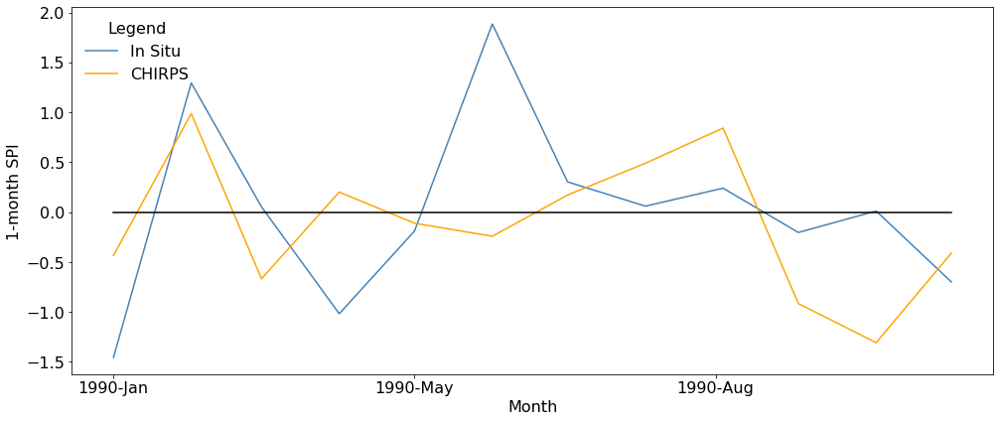

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:385: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


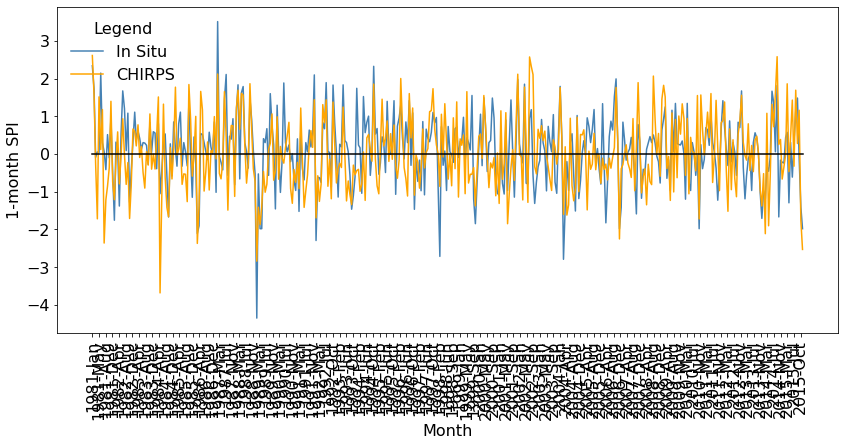

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:440: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


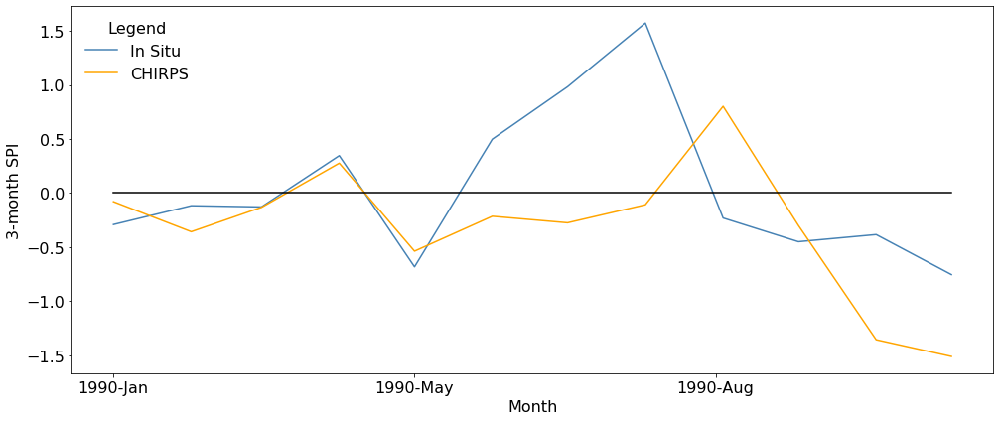

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:488: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


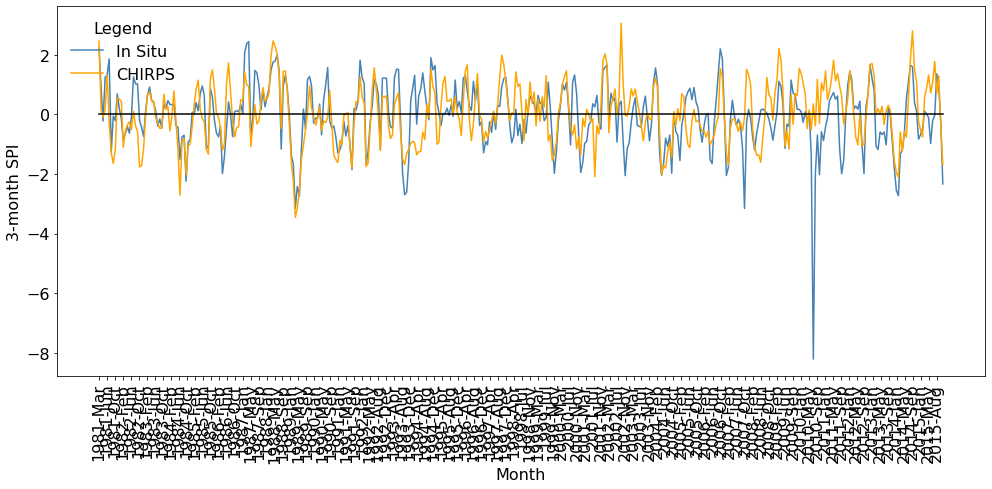

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


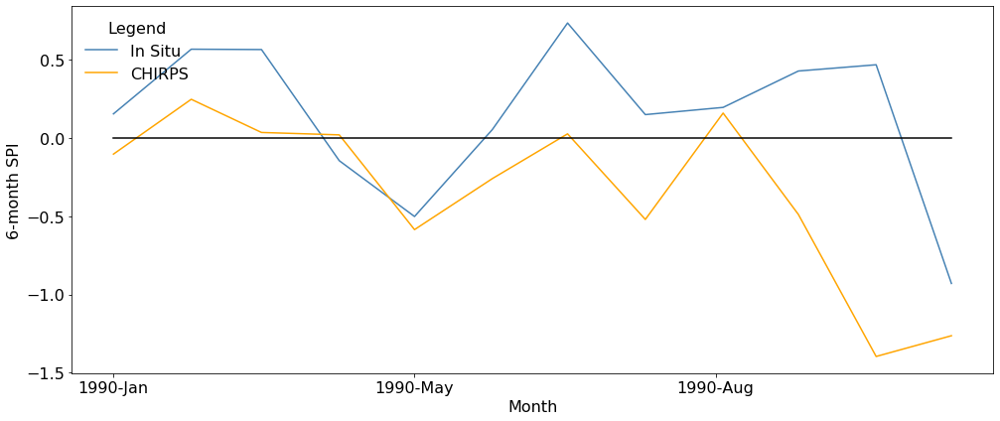

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:591: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


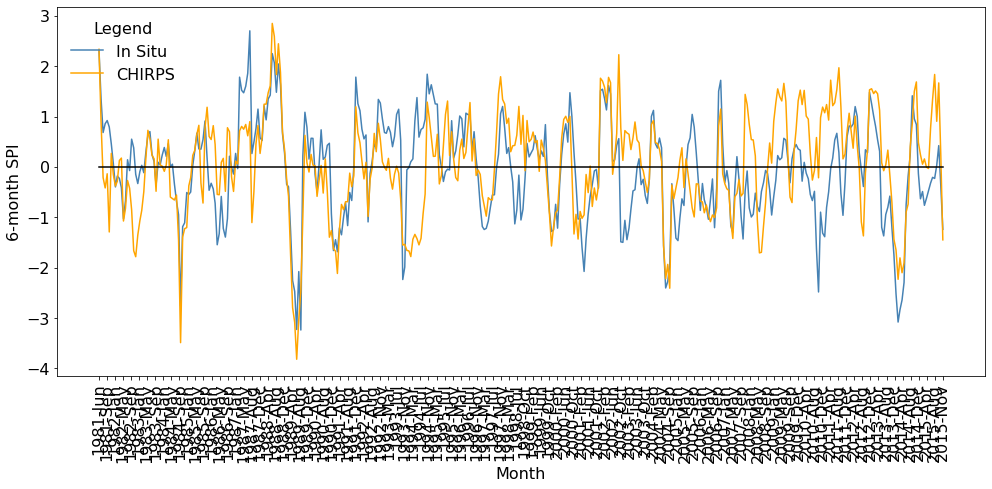

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:646: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


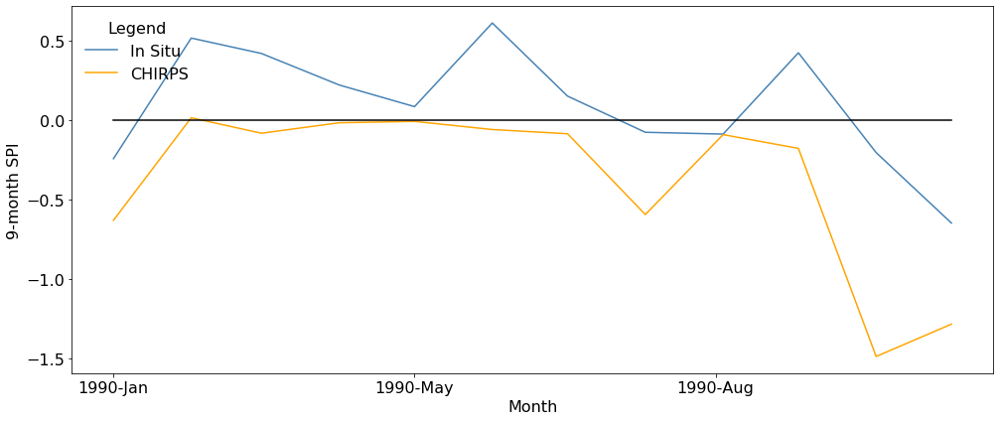

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:694: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


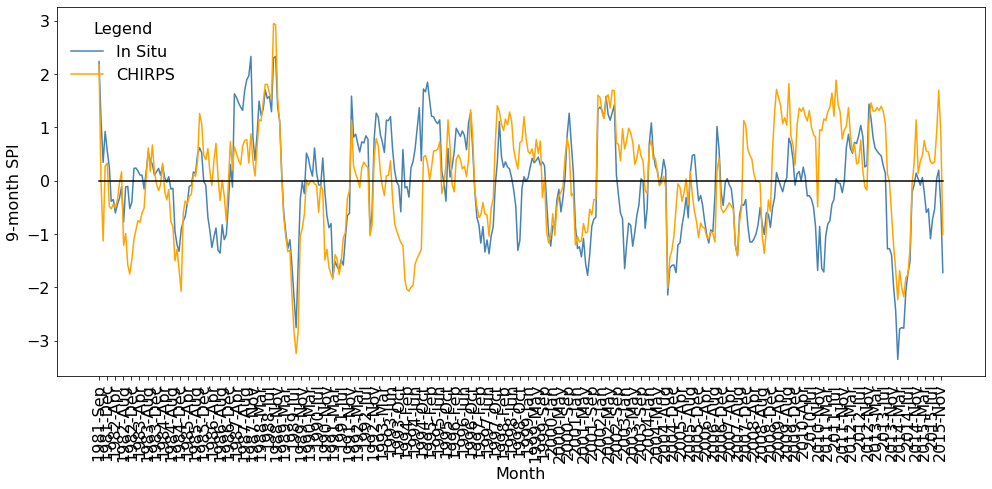

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:749: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


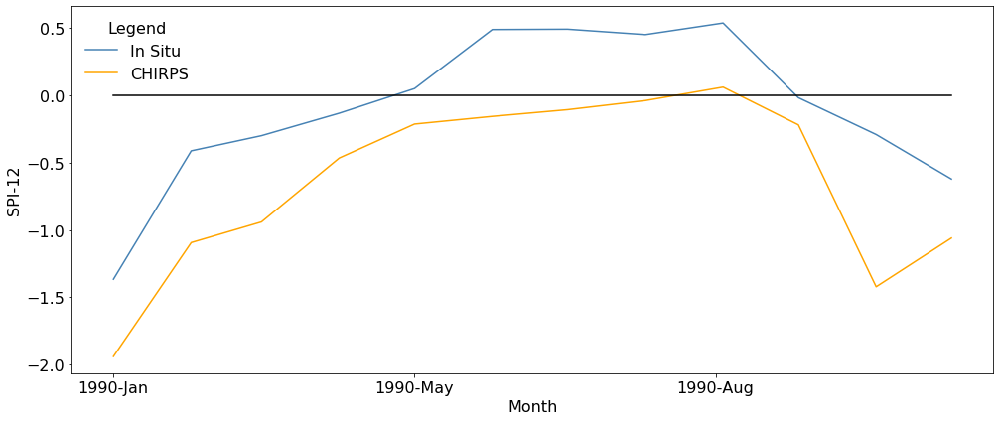

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:798: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


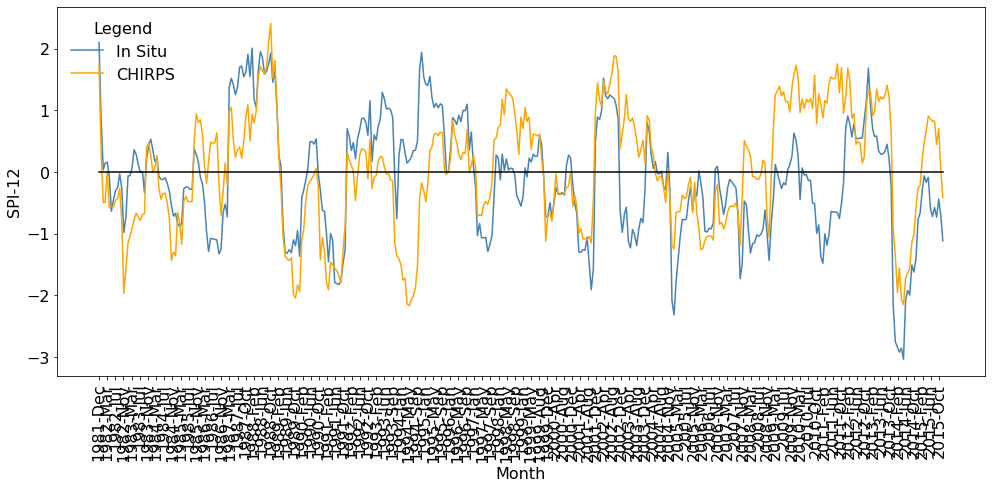

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


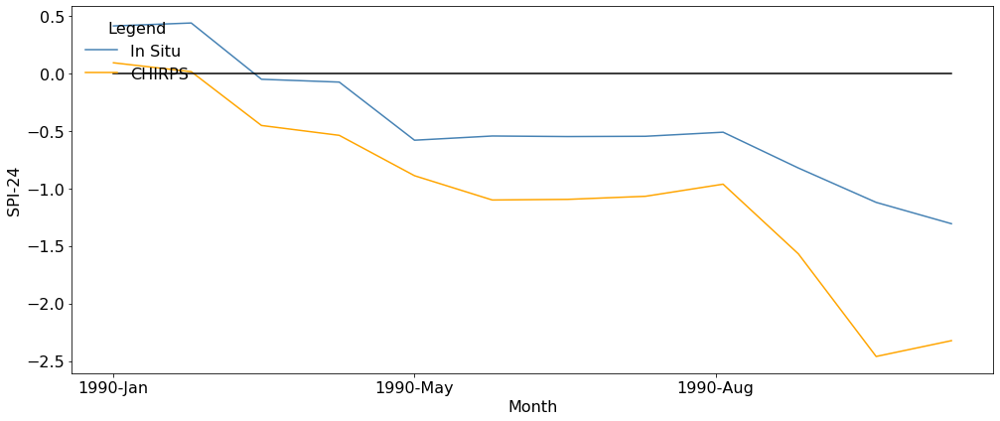

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


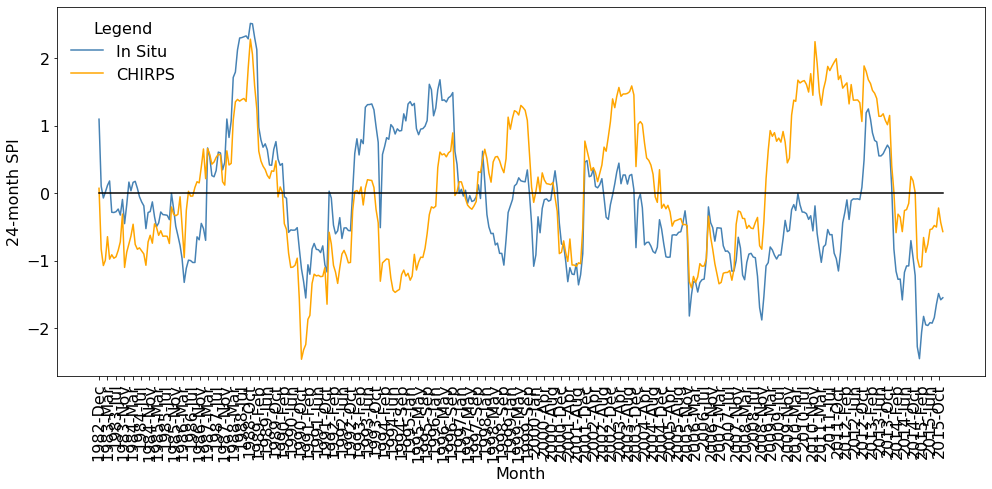

D18M004
done
 


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:338: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


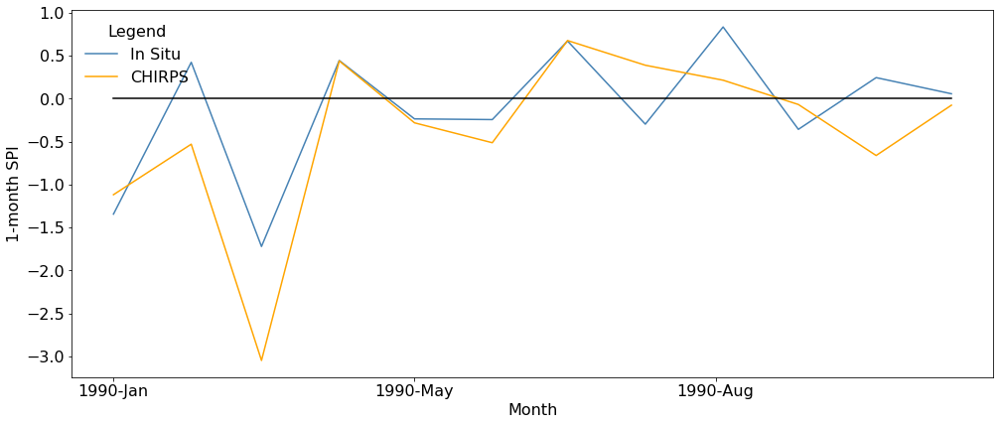

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:385: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


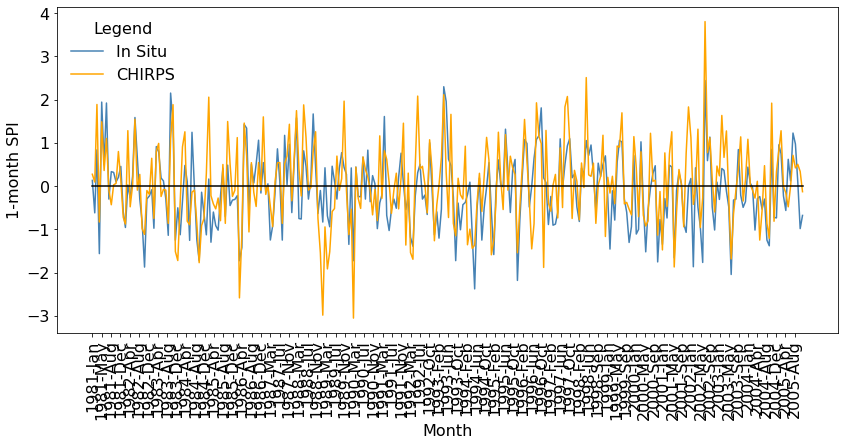

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:440: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


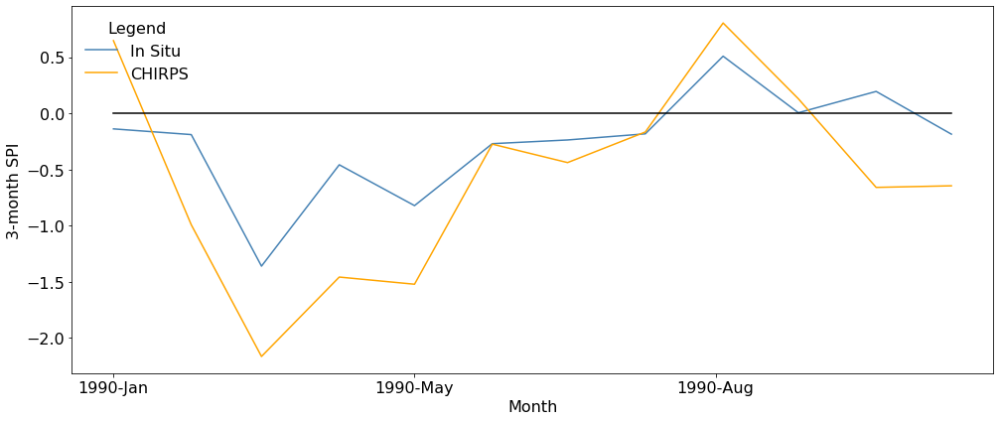

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:488: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


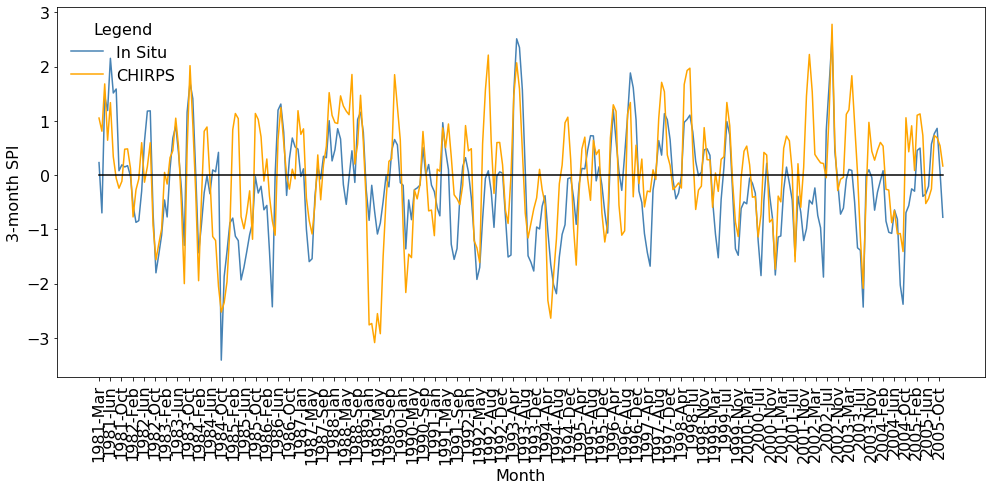

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


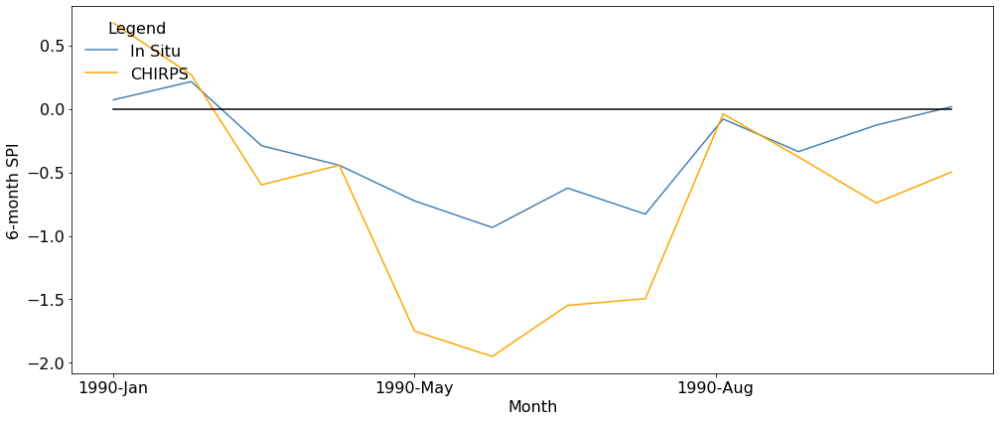

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:591: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


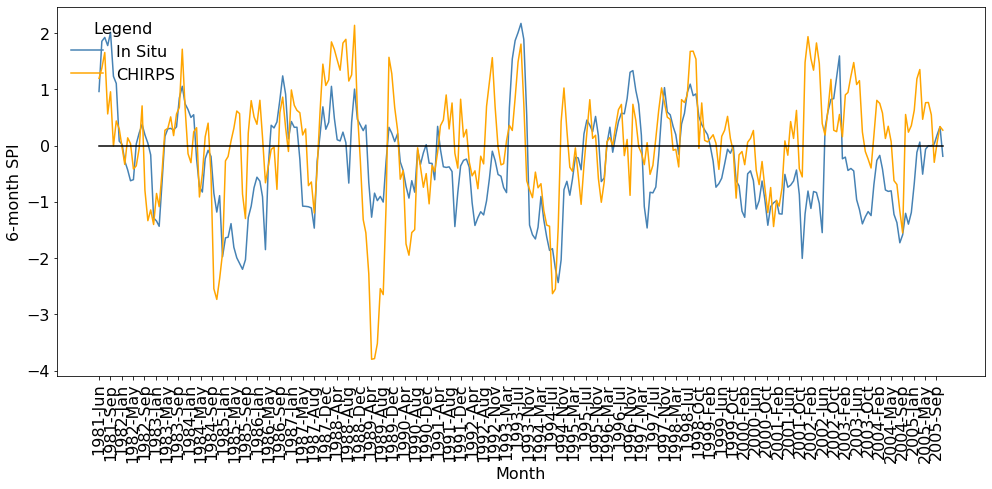

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:646: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


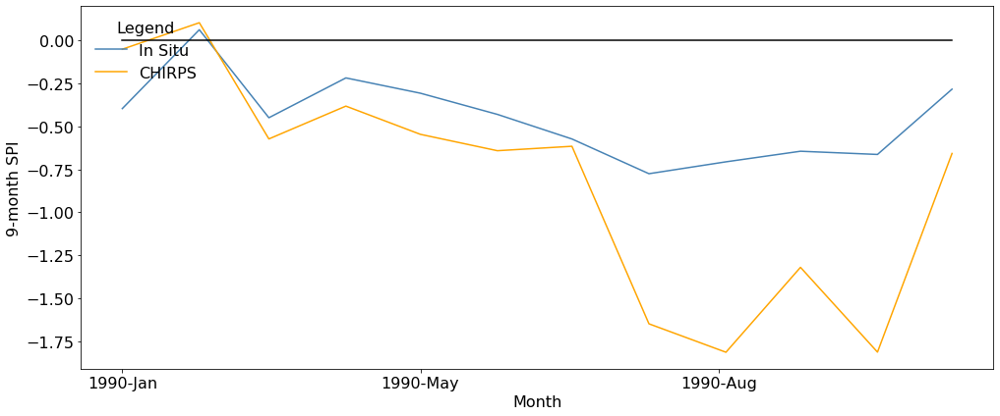

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:694: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


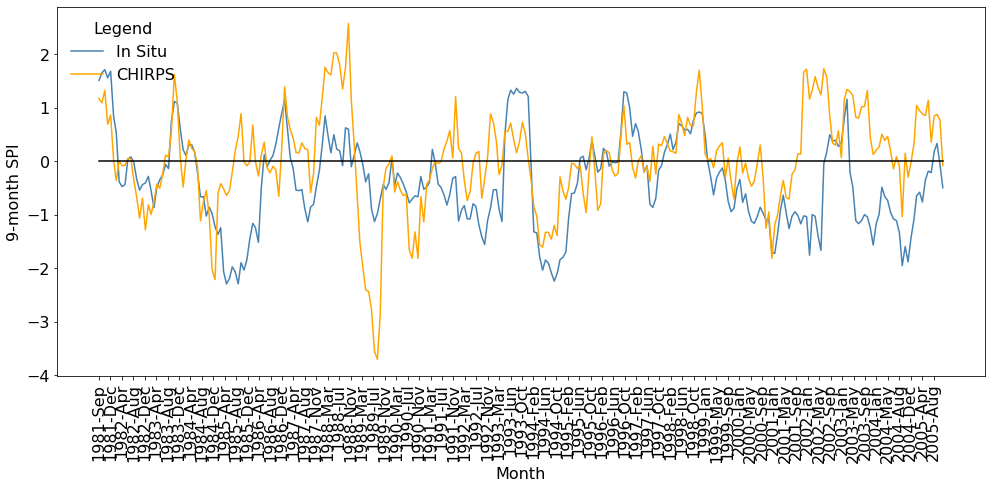

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:749: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


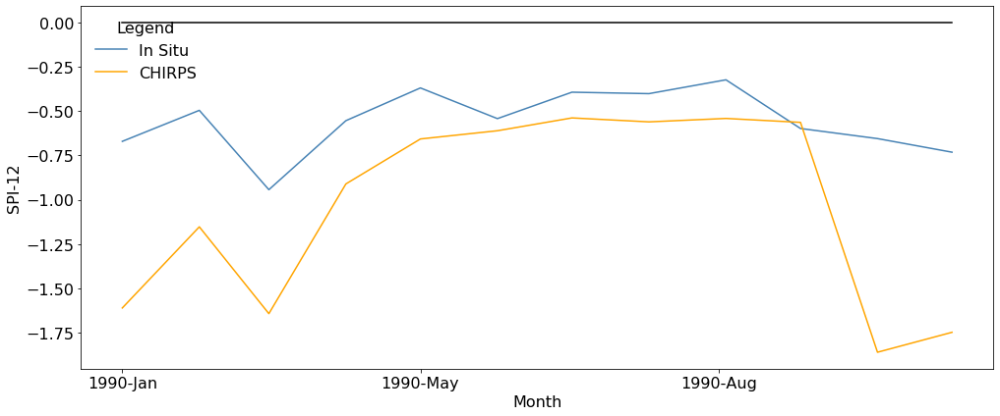

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:798: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


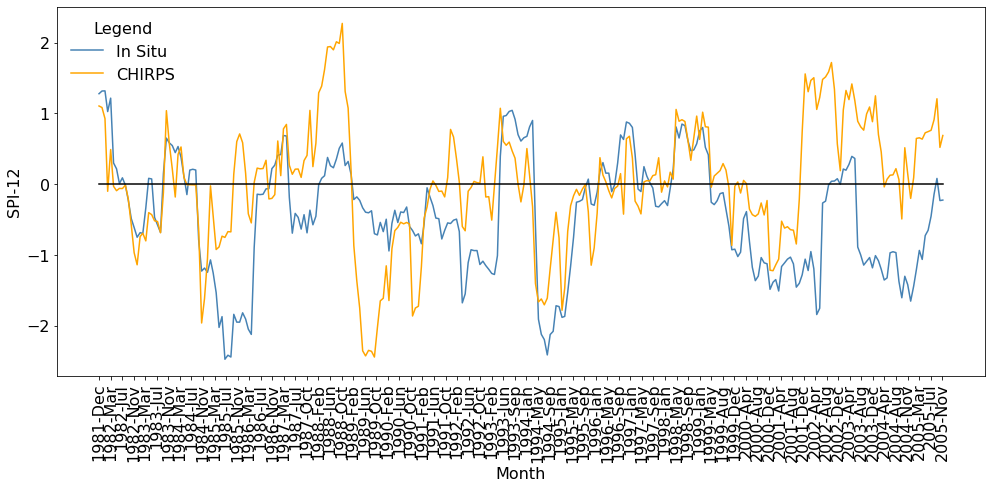

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


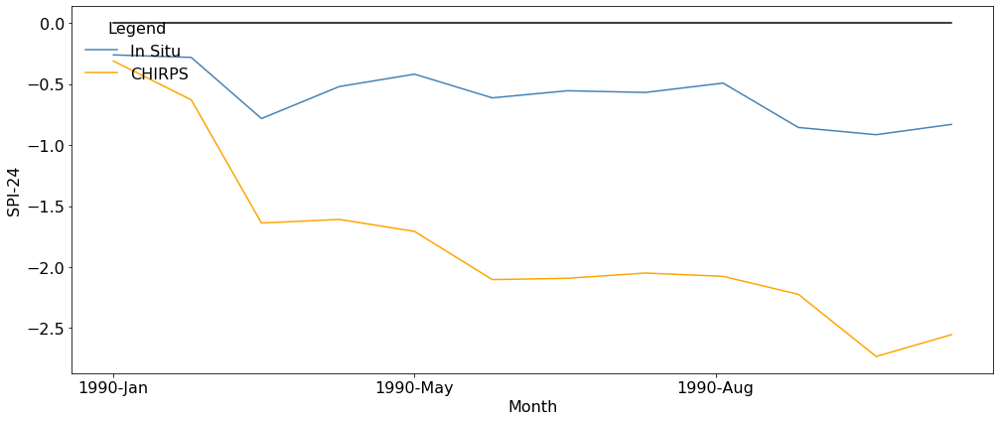

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


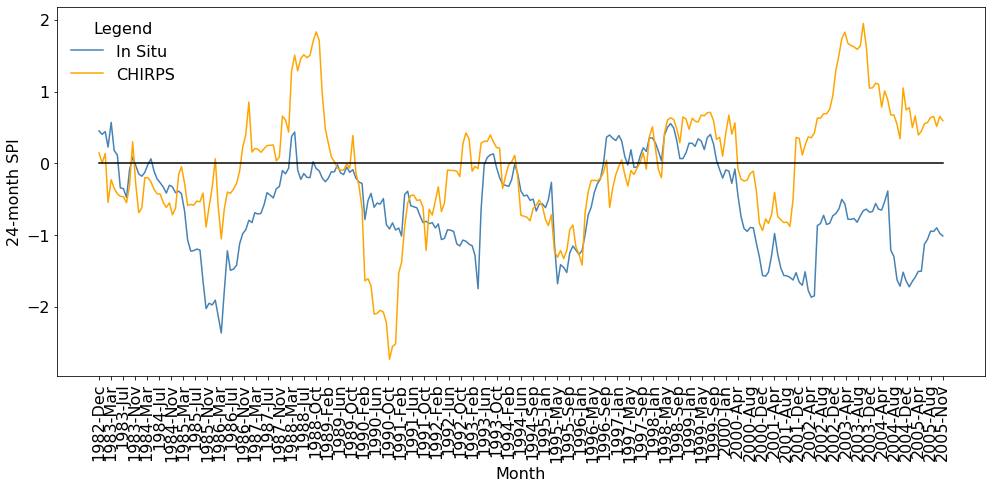

D18M003
done
 


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:338: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


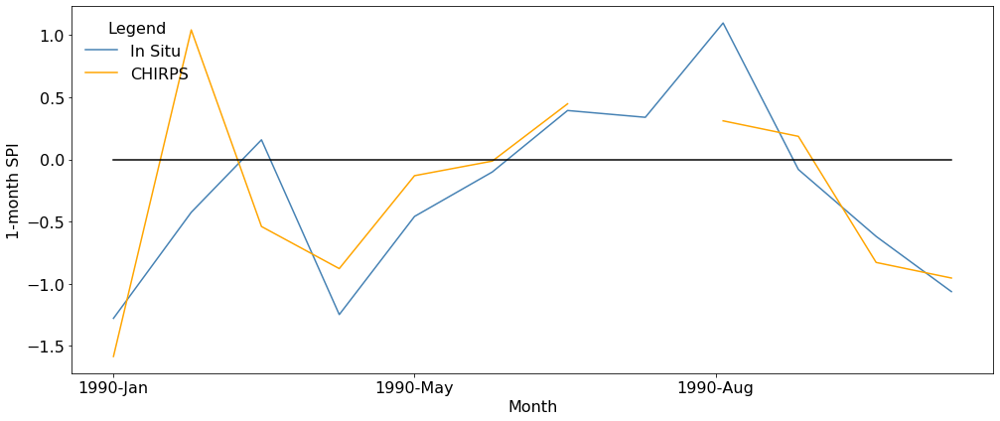

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:385: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


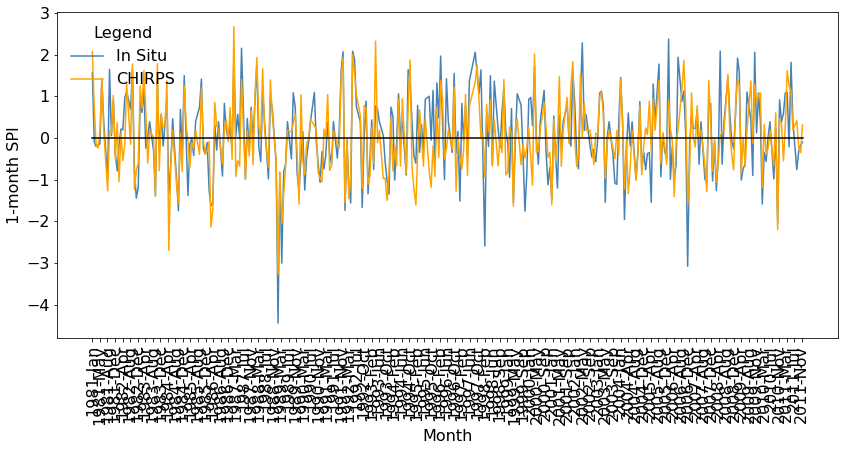

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:440: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


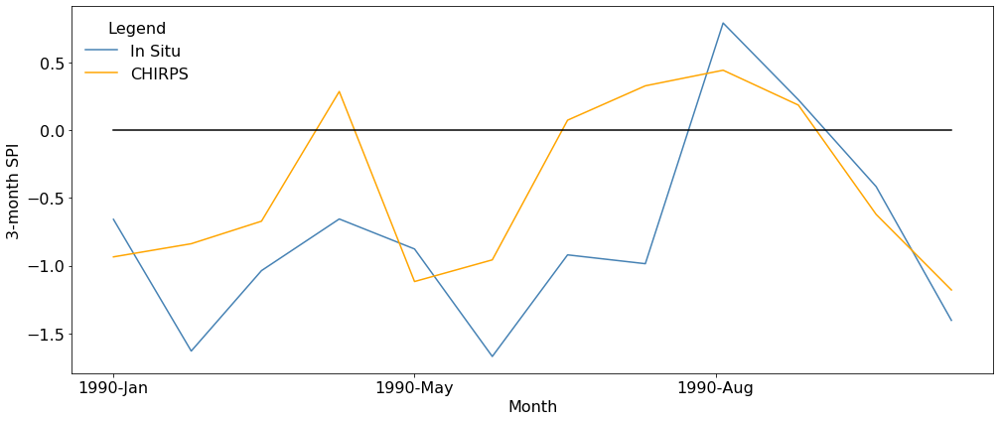

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:488: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


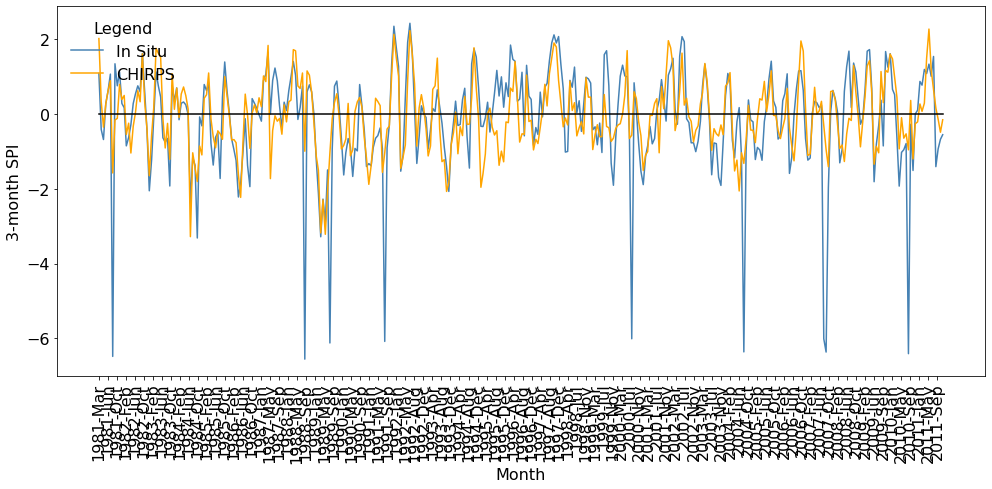

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


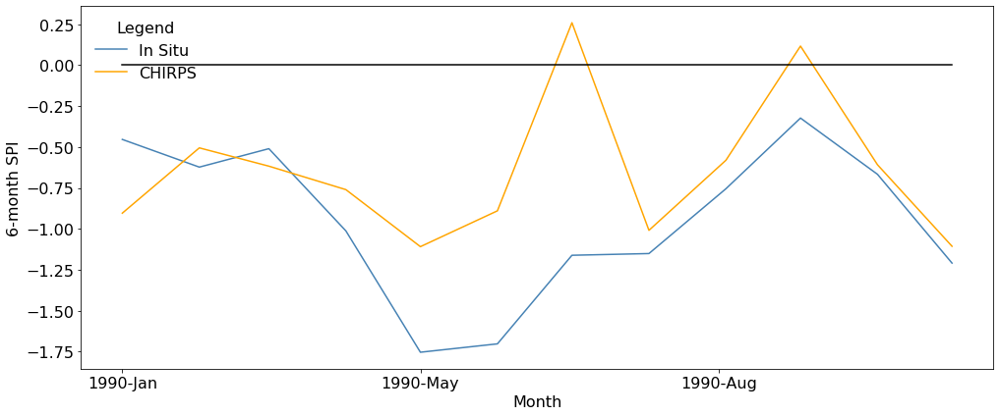

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:591: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


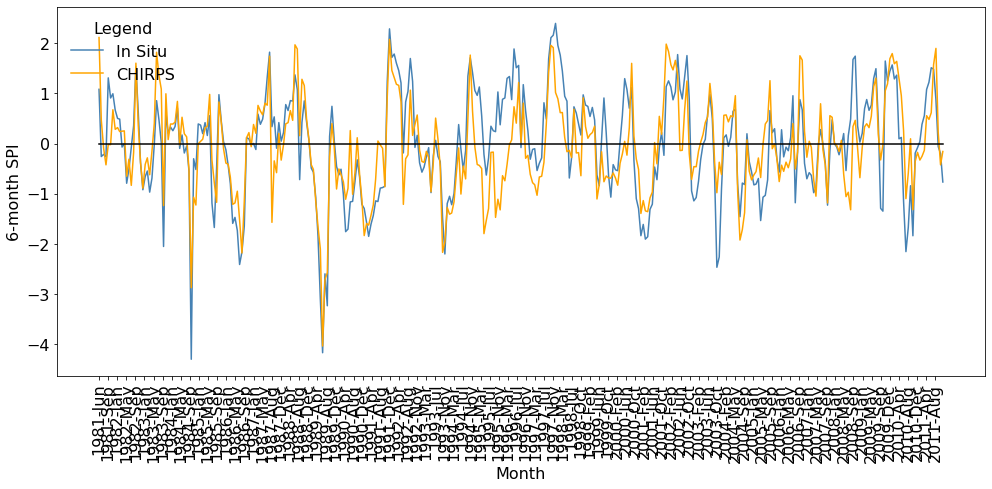

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:646: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


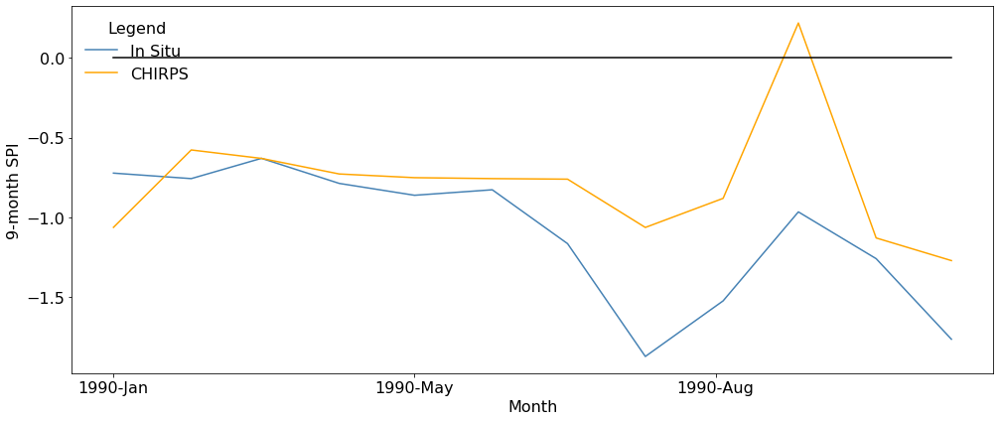

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:694: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


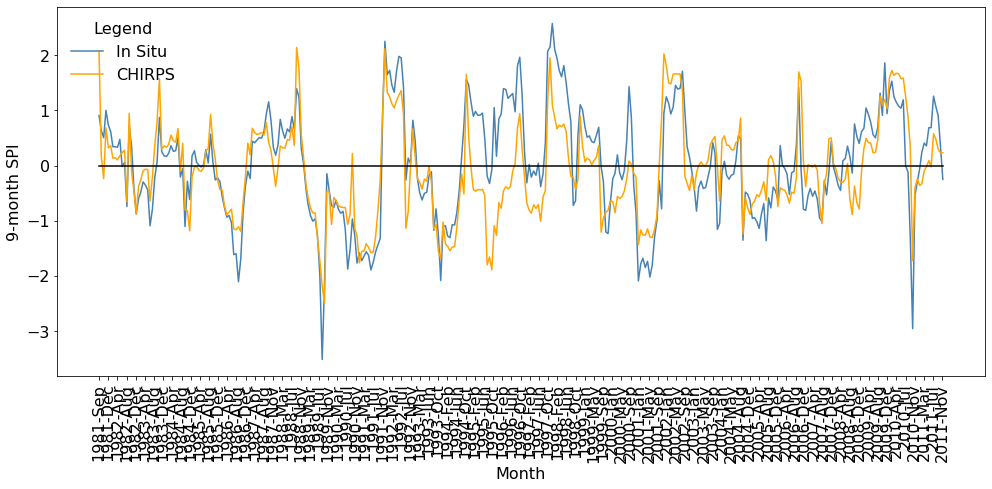

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:749: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


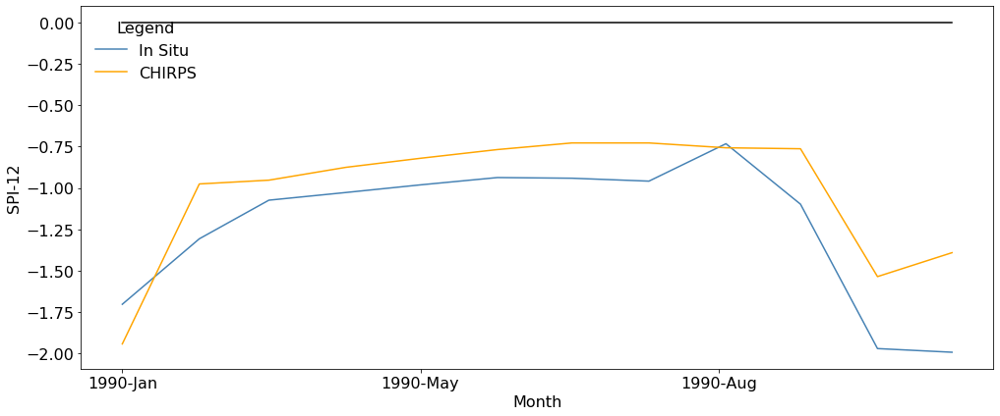

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:798: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


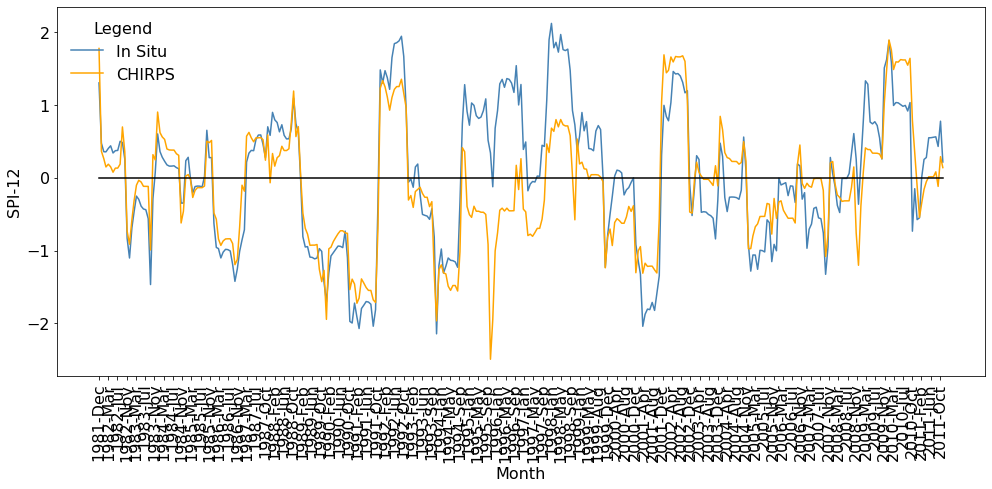

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


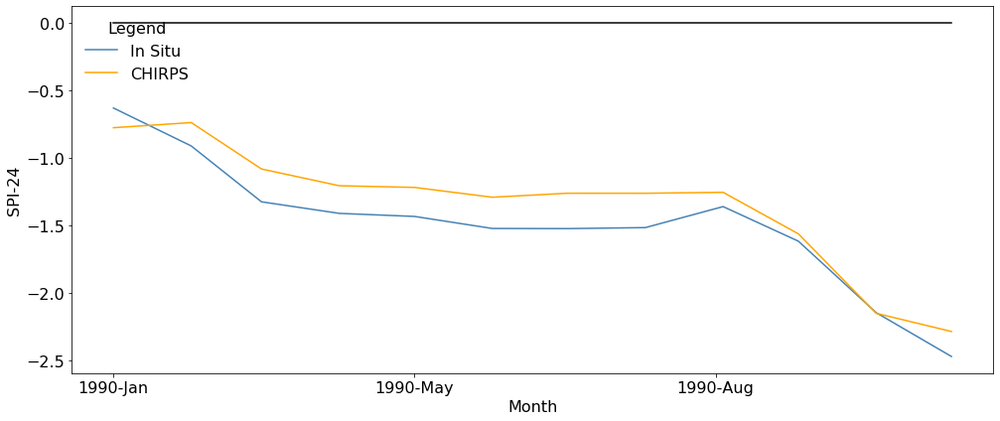

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


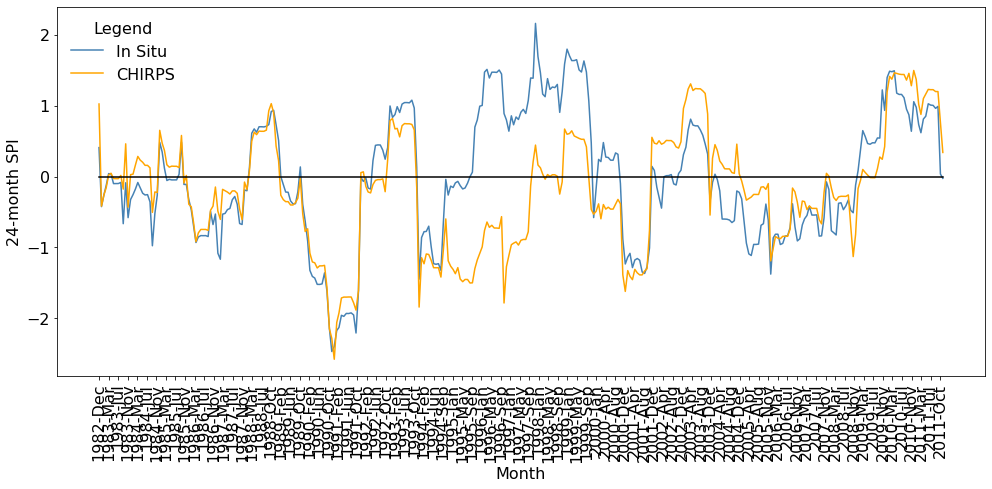

17981
done
 


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:338: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


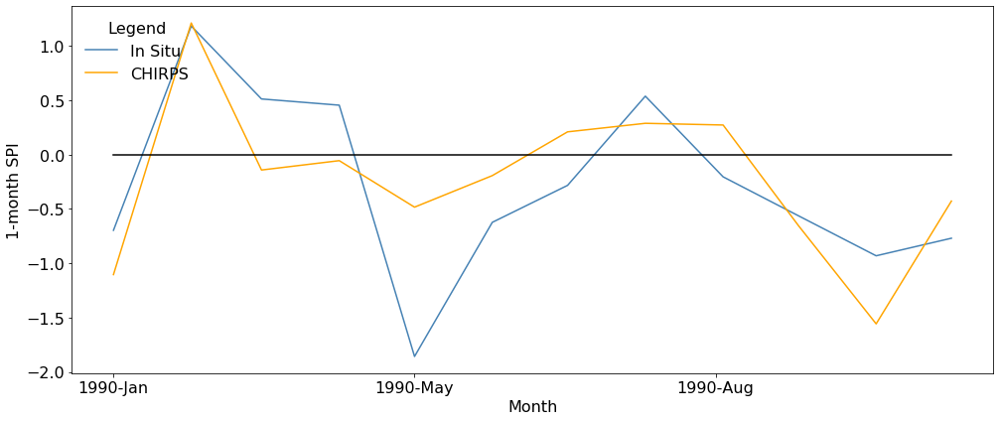

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:385: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


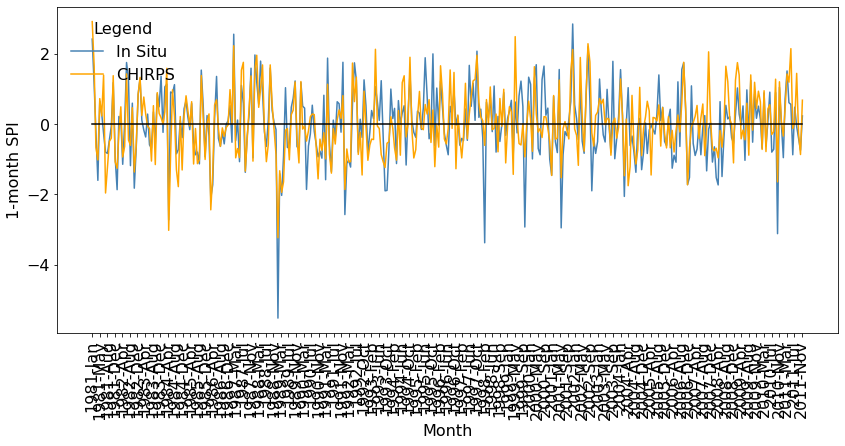

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:440: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


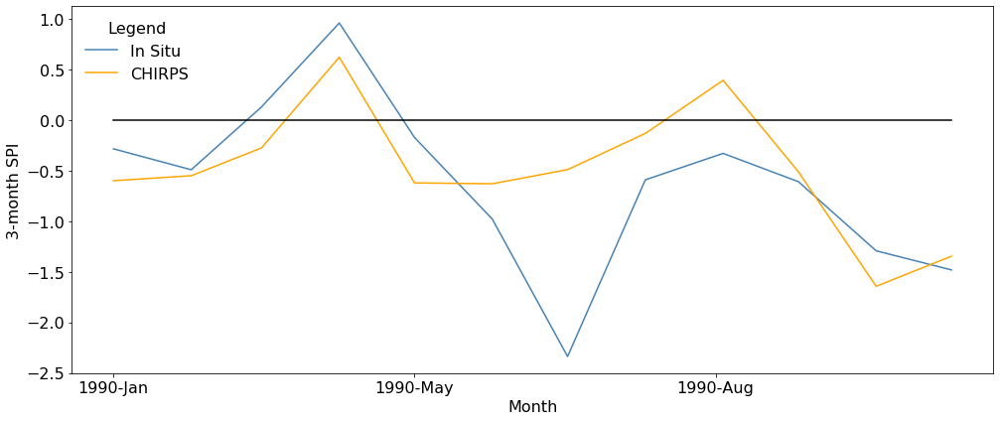

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:488: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


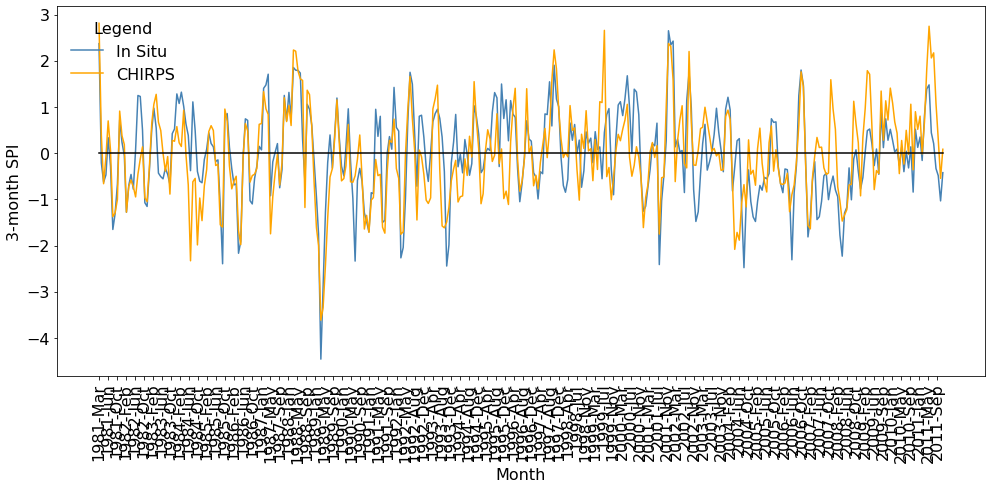

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


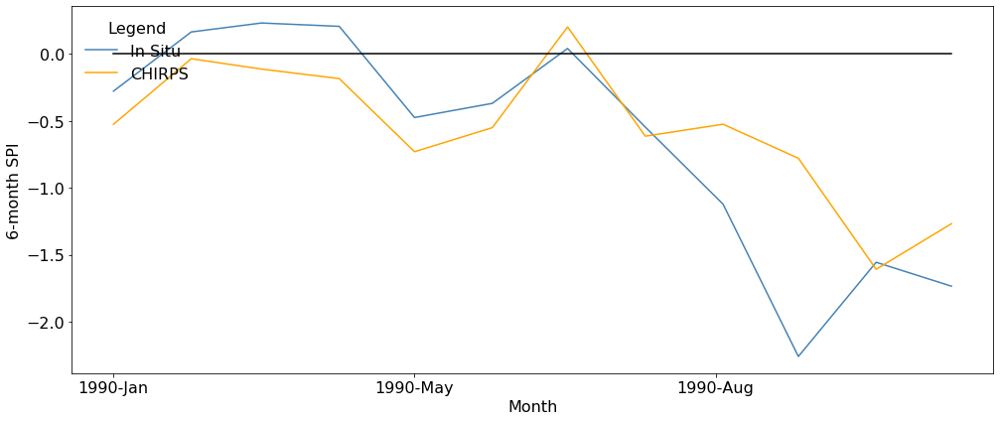

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:591: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


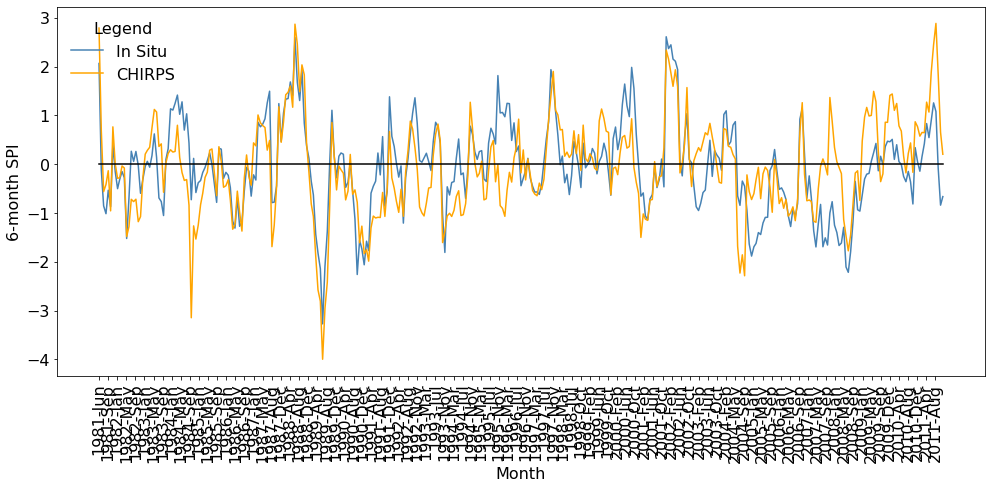

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:646: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


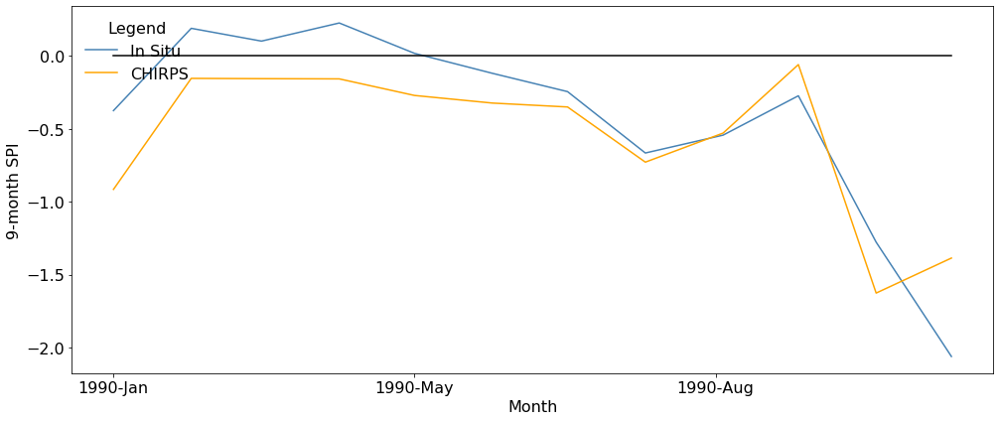

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:694: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


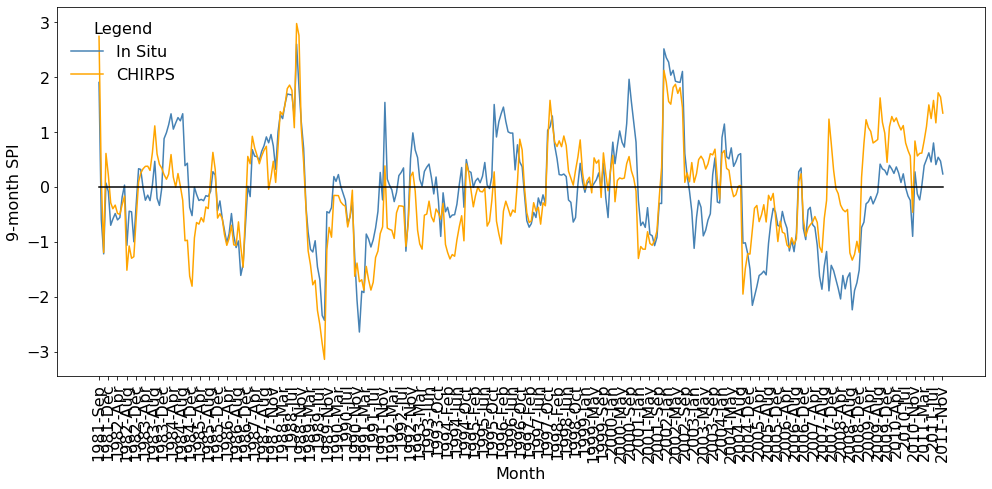

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:749: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


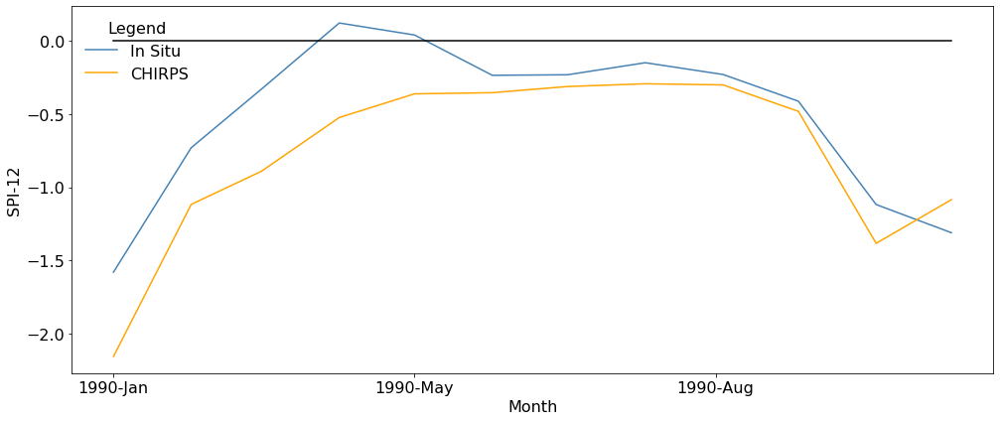

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:798: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


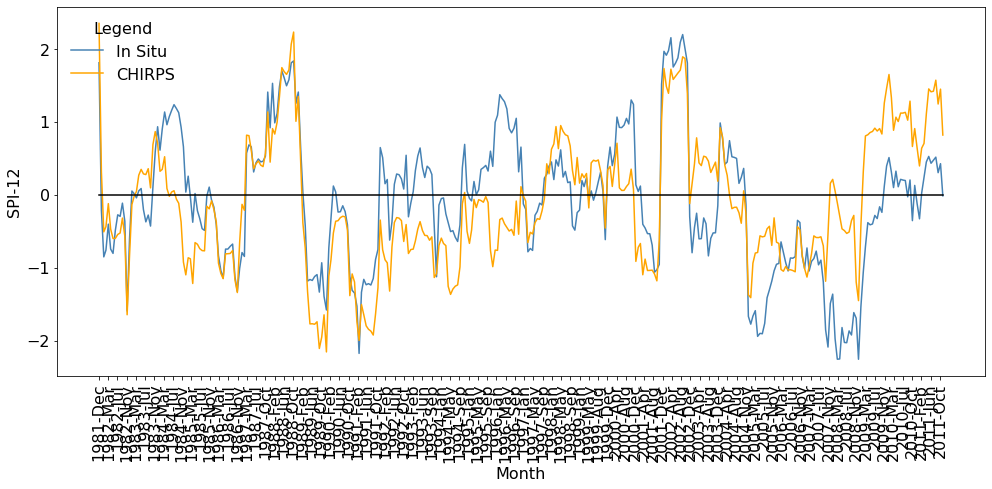

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


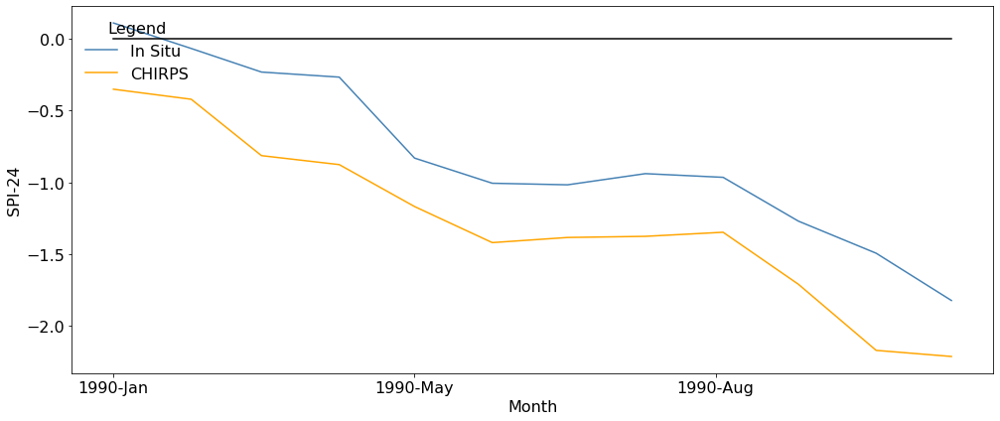

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


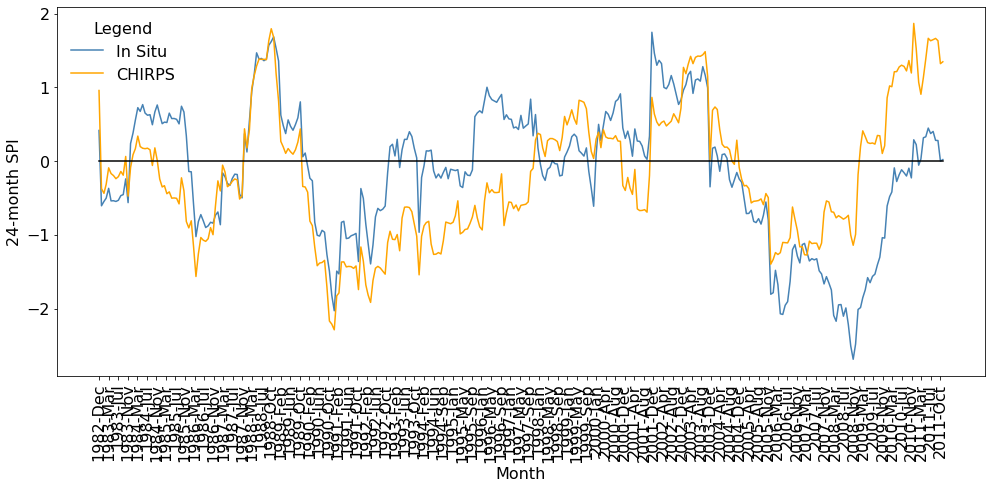

17936
done
 


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:338: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


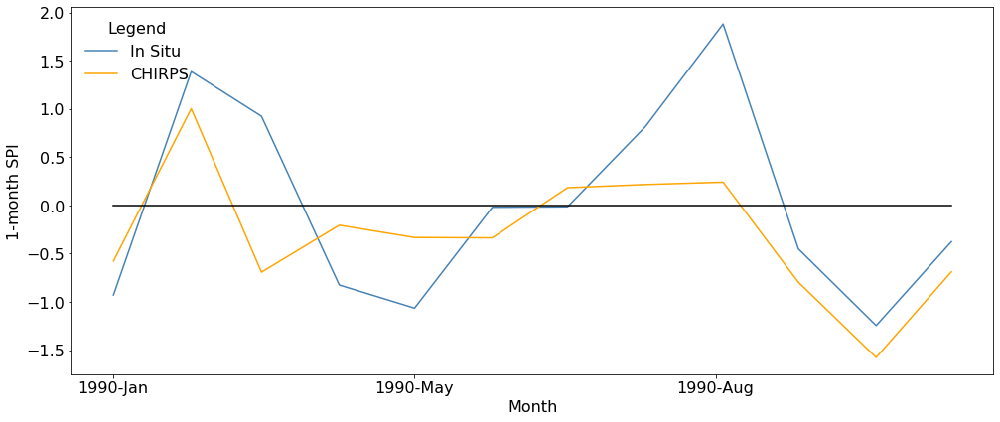

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:385: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


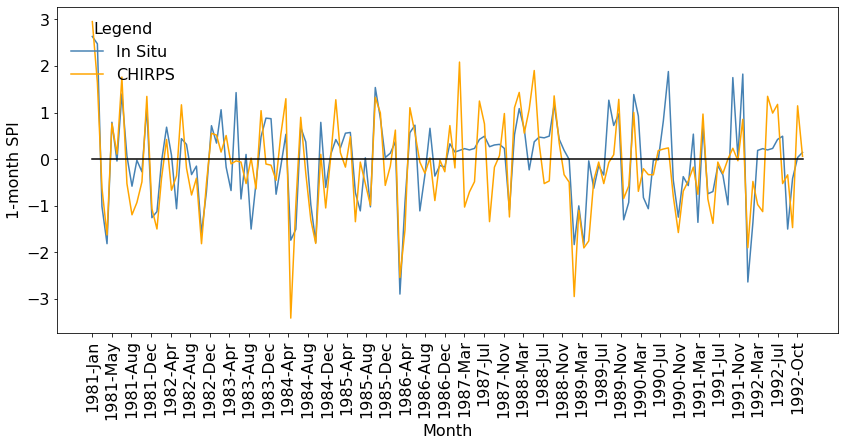

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:440: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


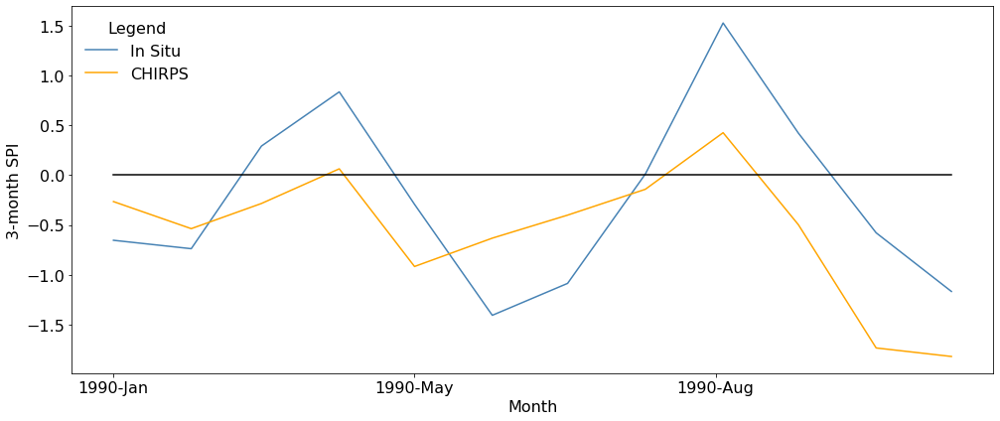

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:488: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


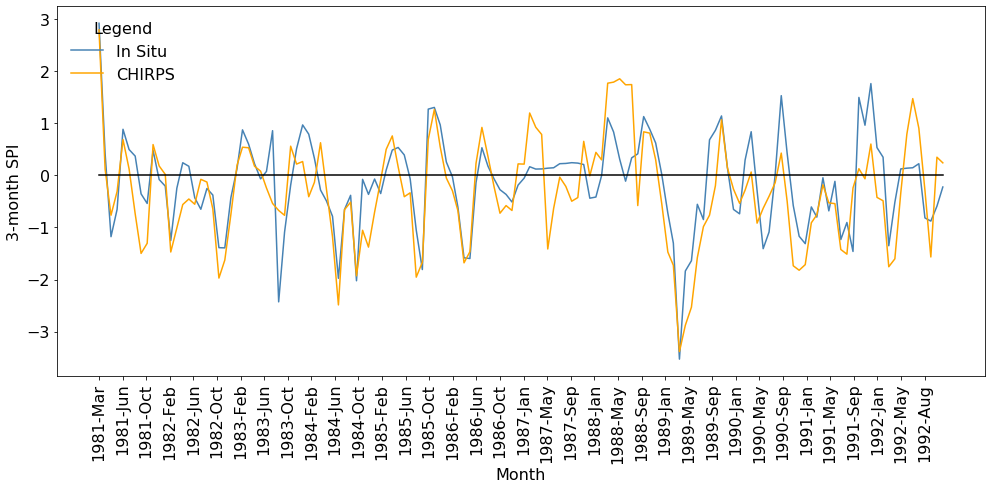

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


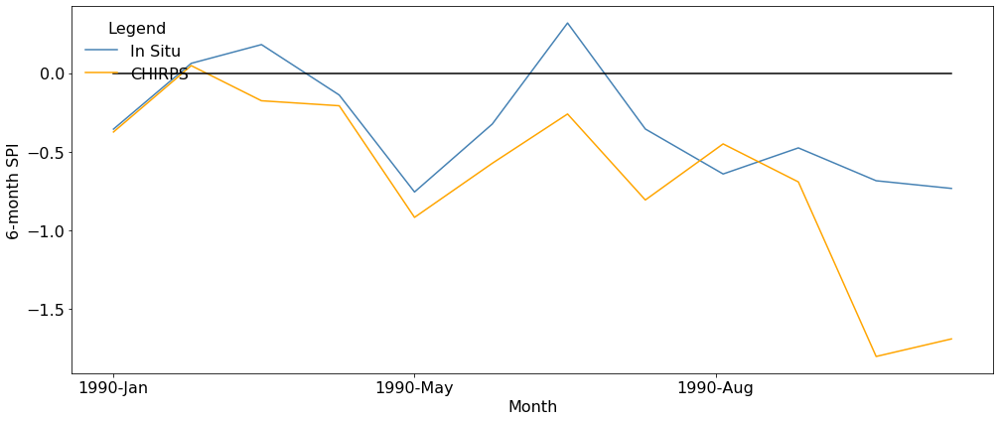

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:591: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


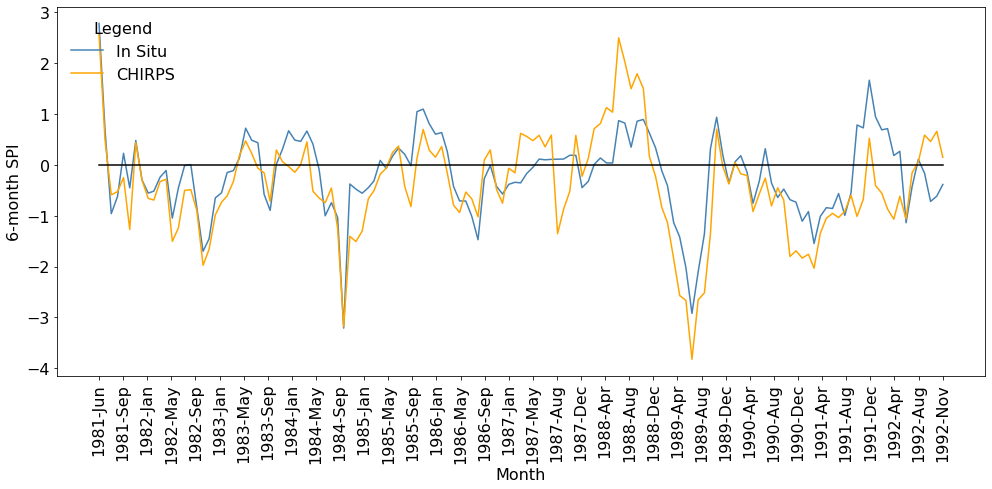

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:646: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


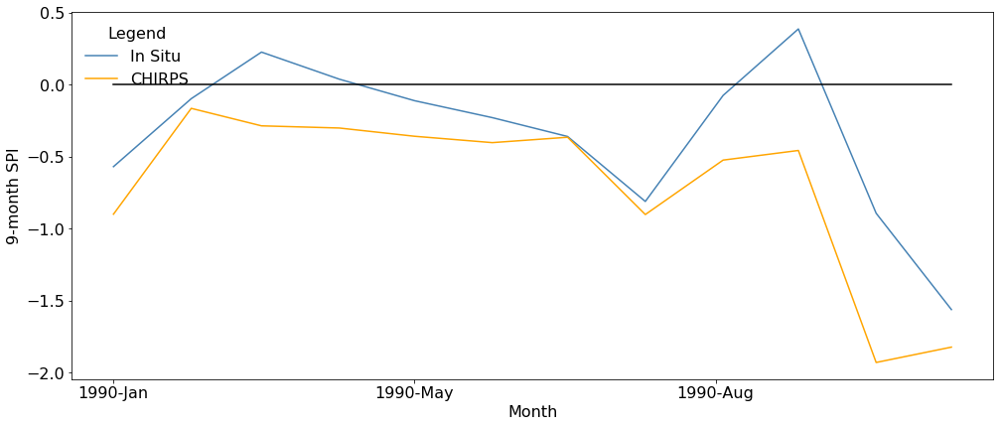

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:694: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


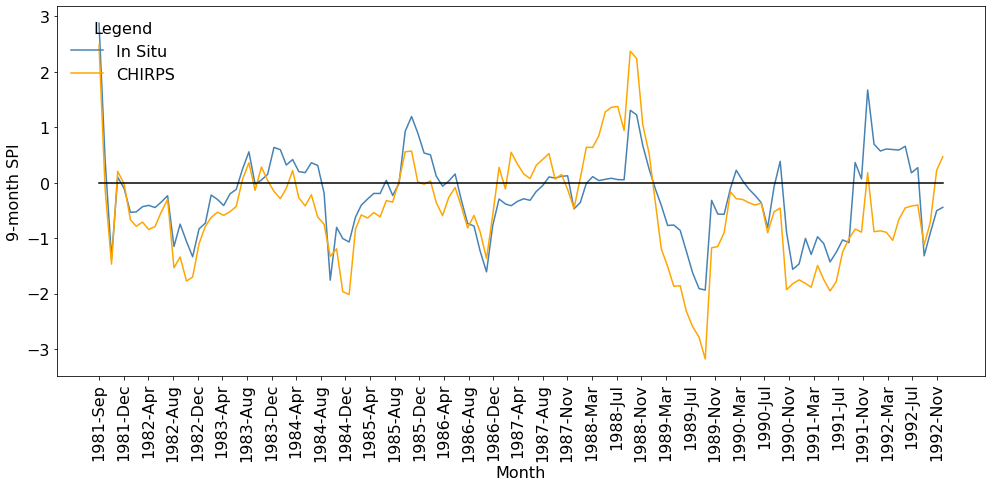

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:749: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


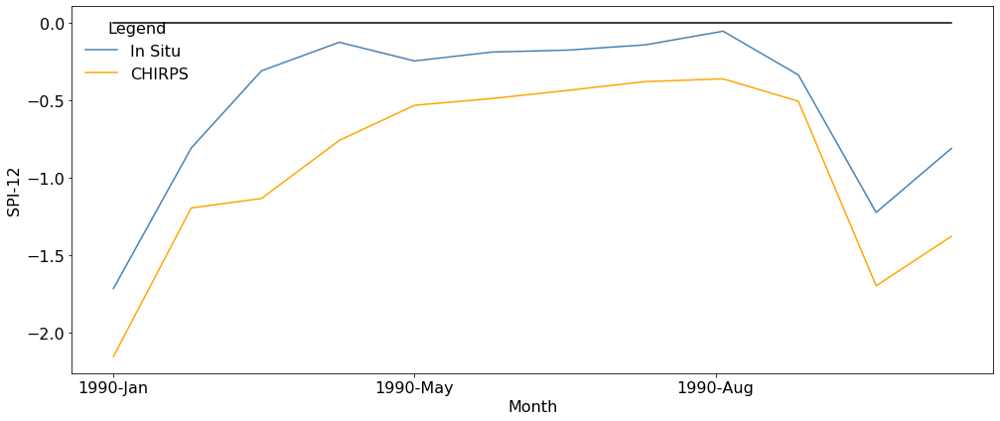

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:798: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


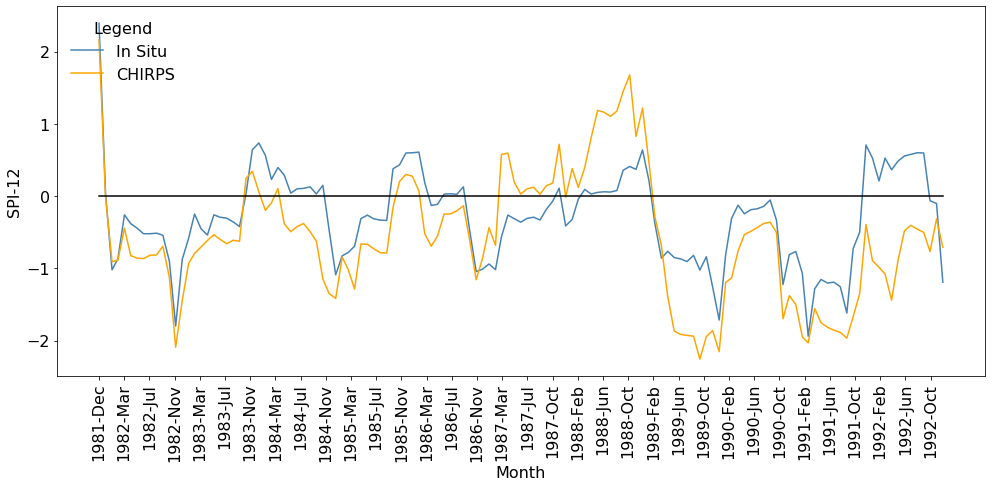

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


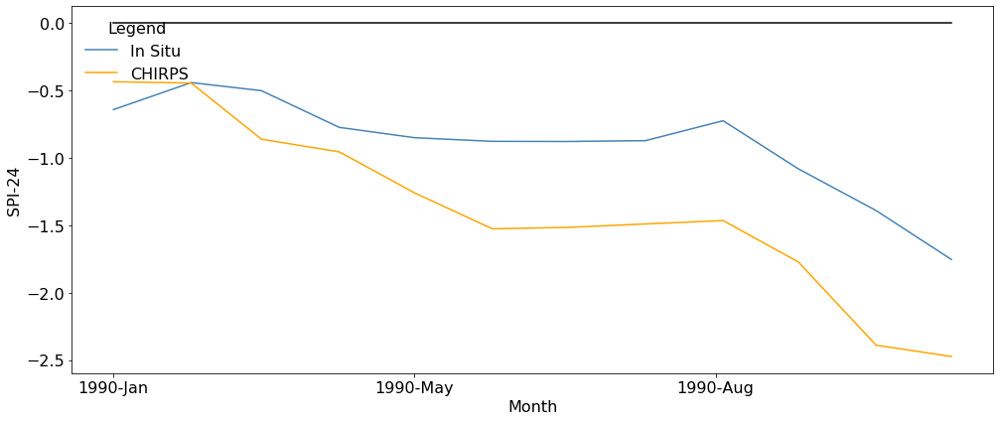

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


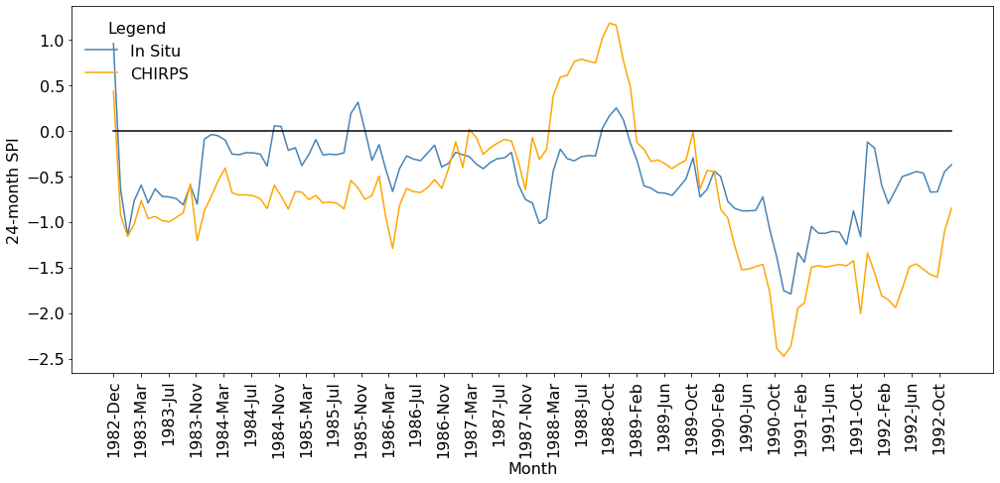

17934
done
 


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:338: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


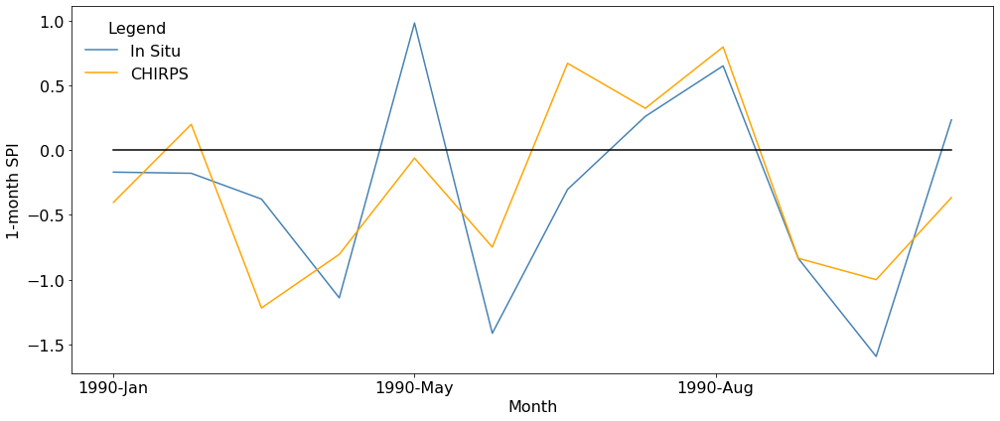

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:385: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


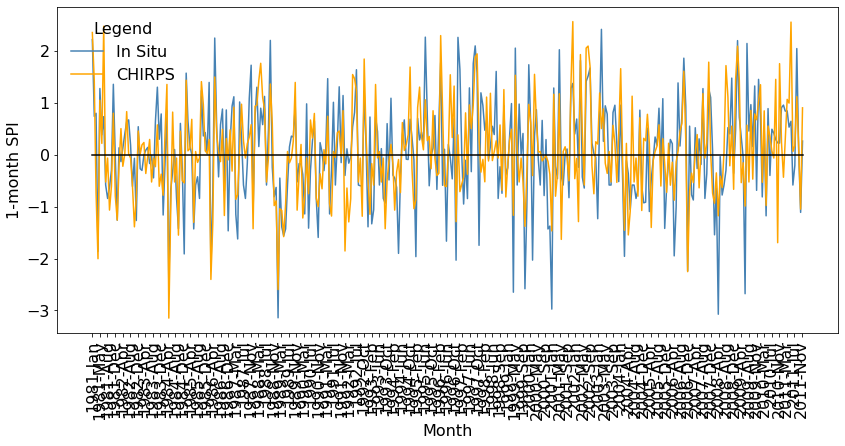

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:440: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


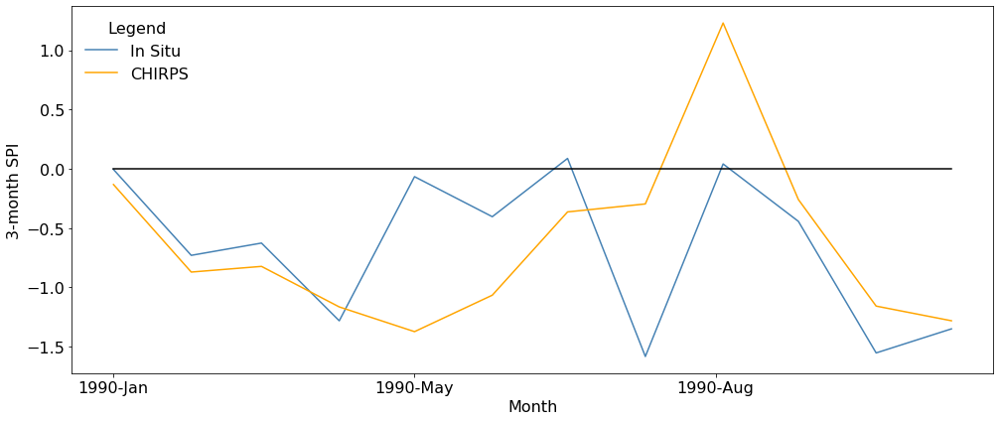

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:488: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


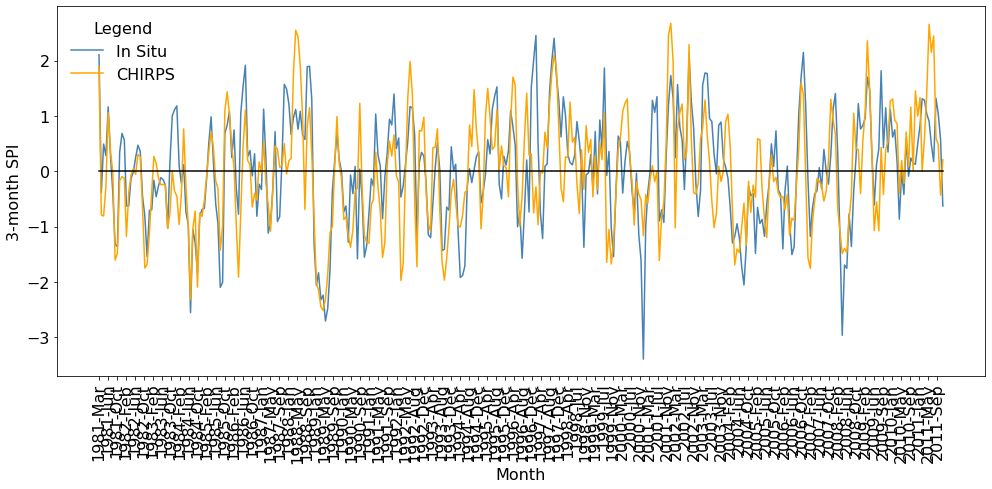

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


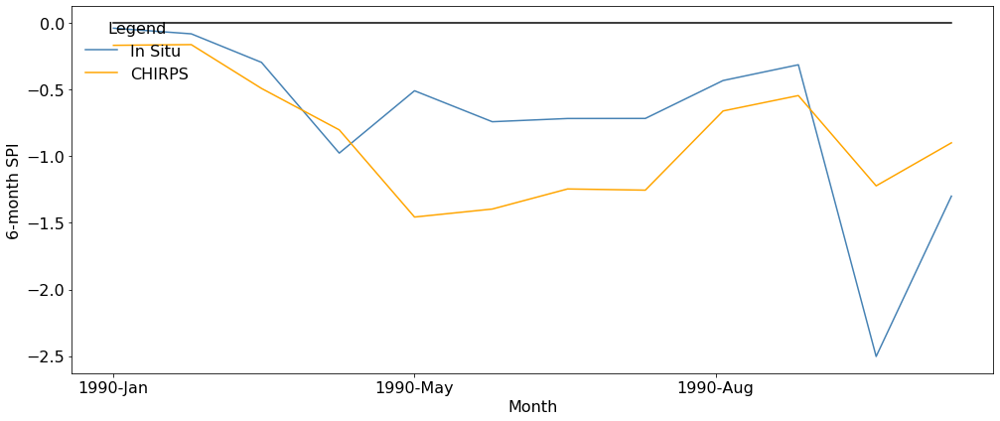

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:591: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


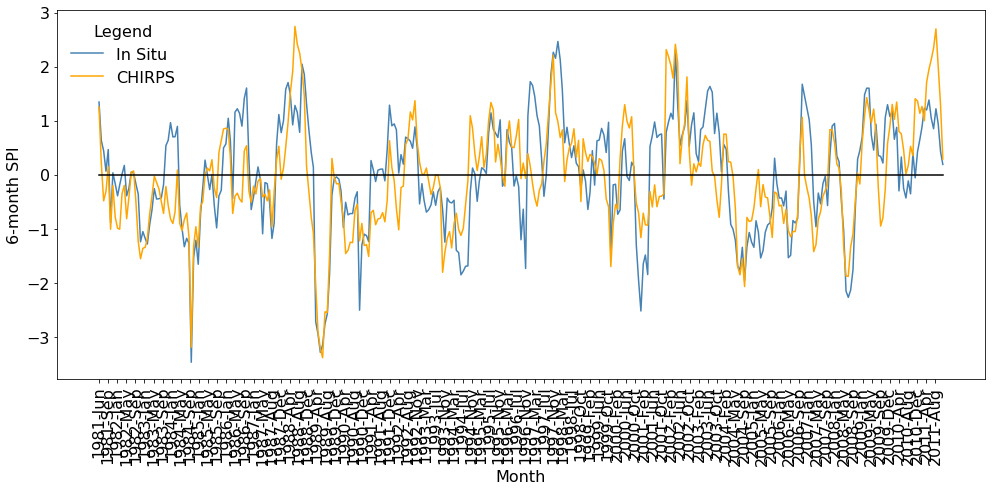

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:646: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


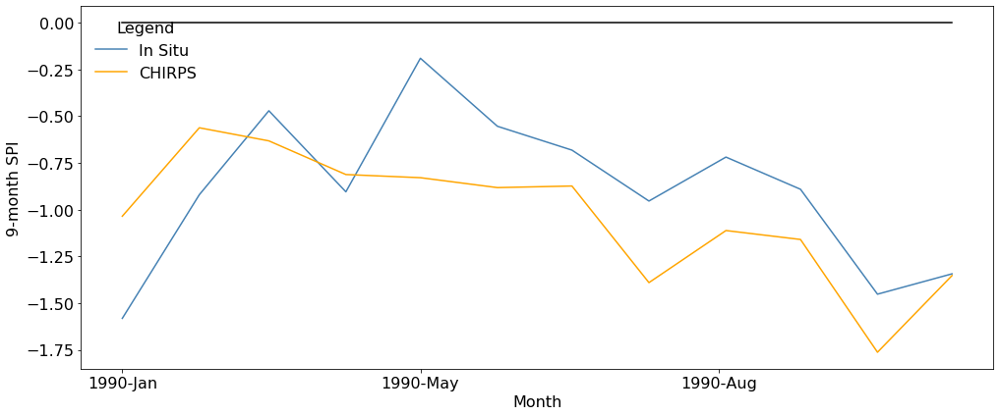

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:694: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


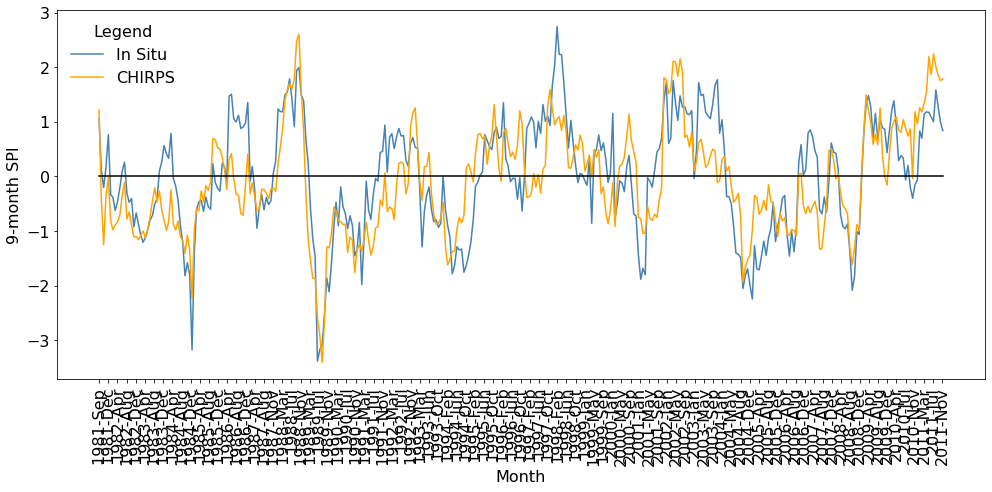

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:749: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


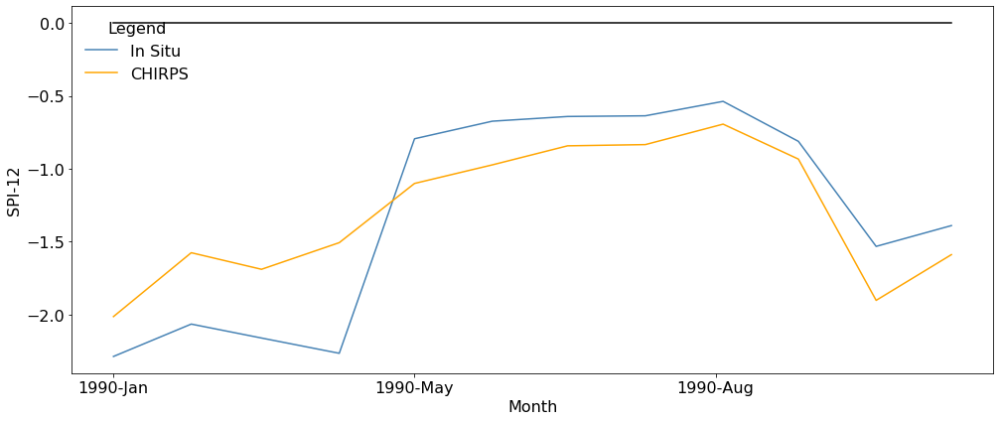

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:798: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


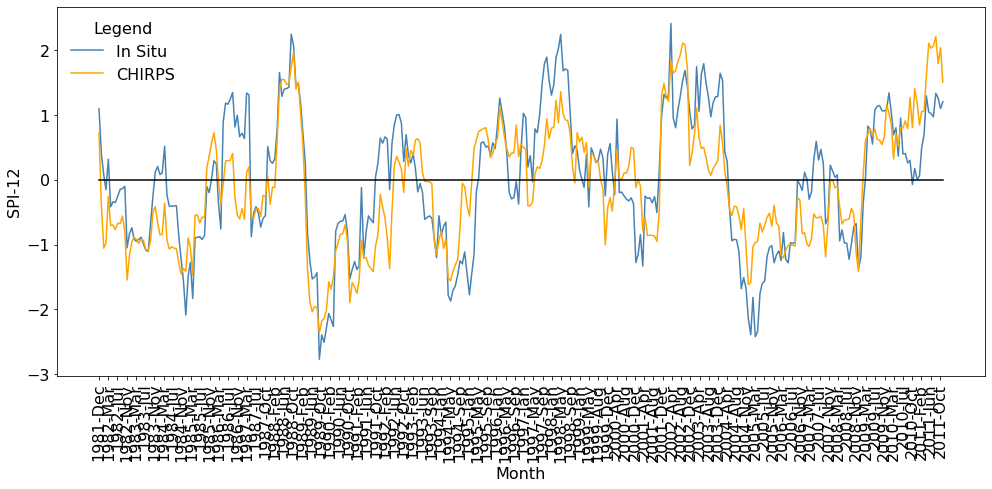

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


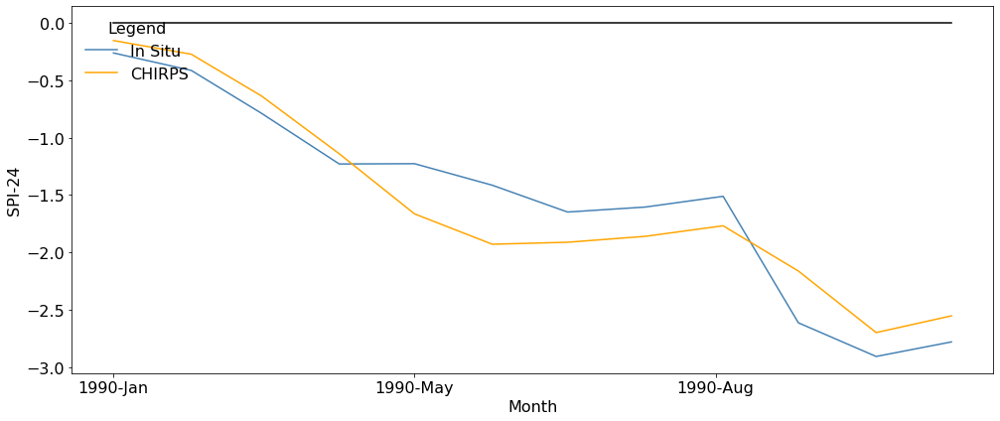

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


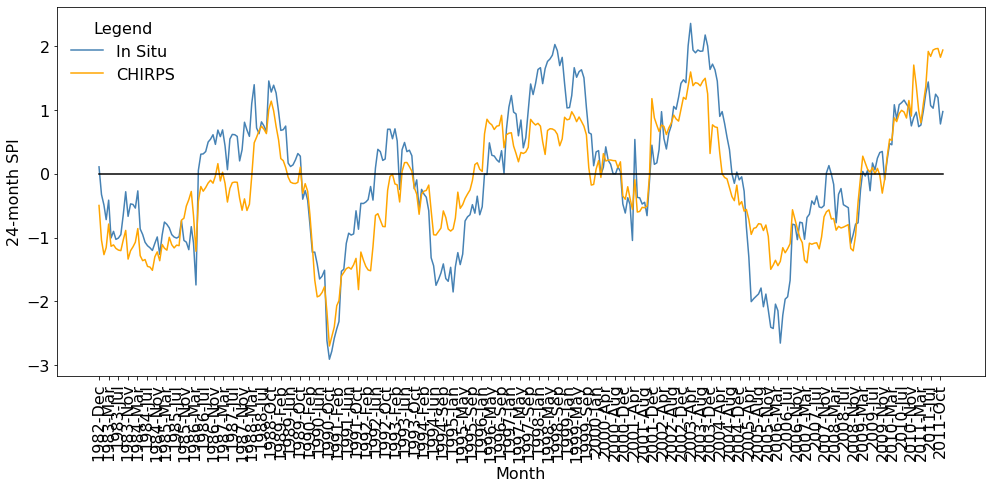

17906
done
 


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:338: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


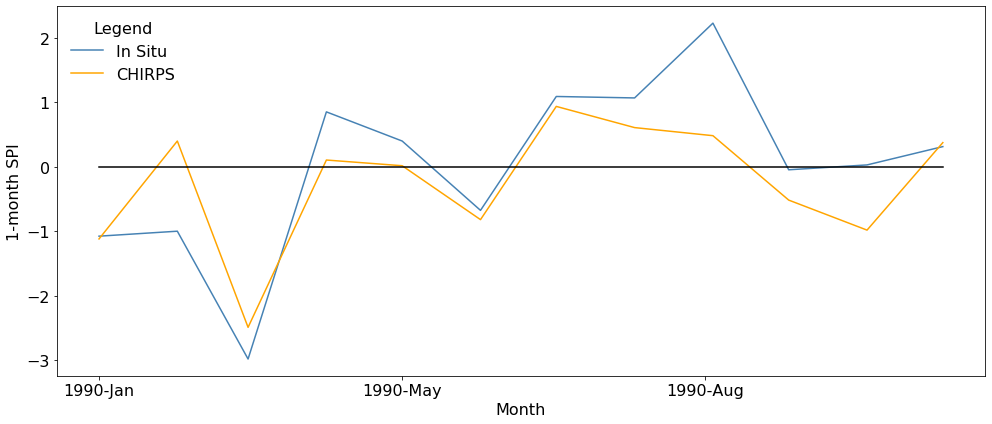

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:385: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


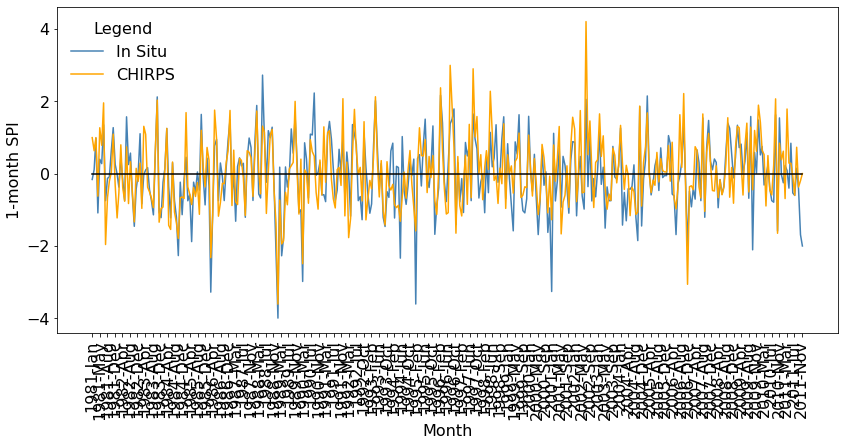

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:440: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


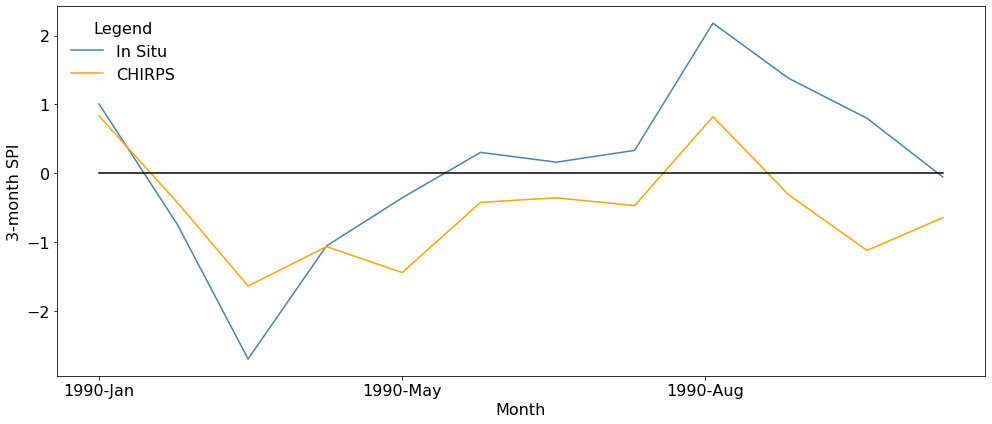

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:488: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


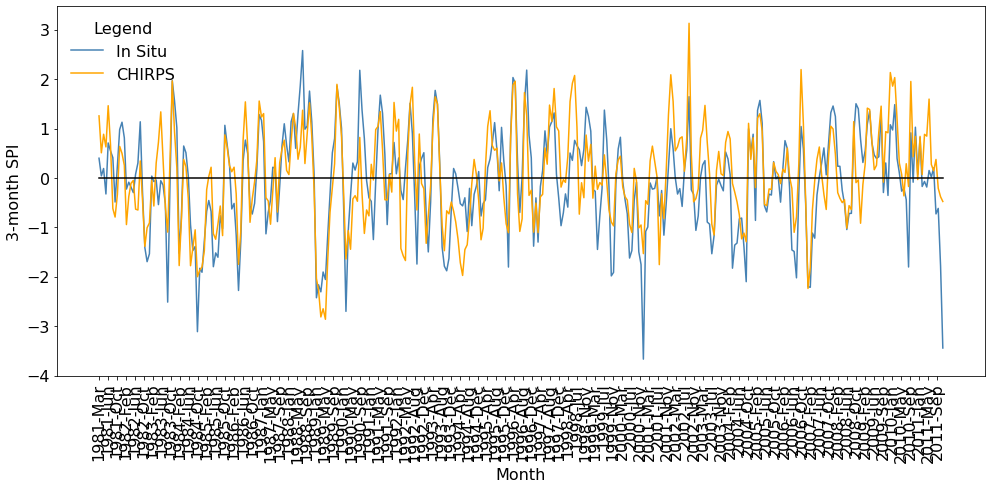

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


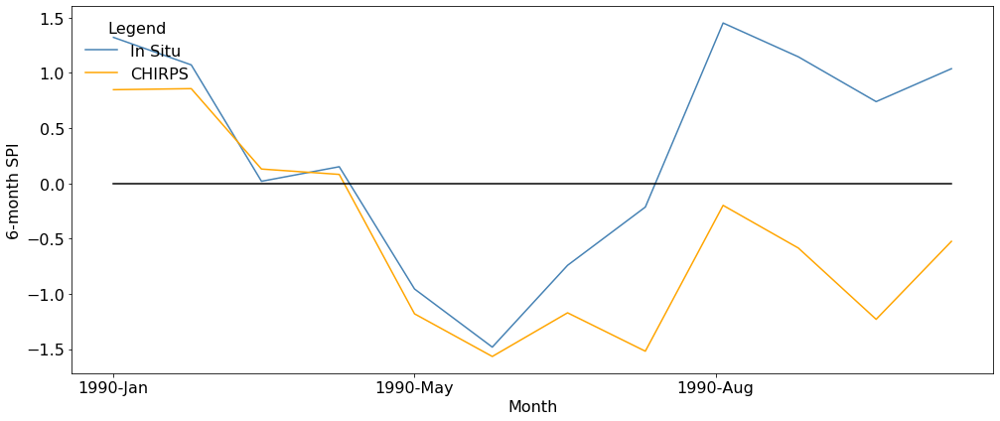

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:591: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


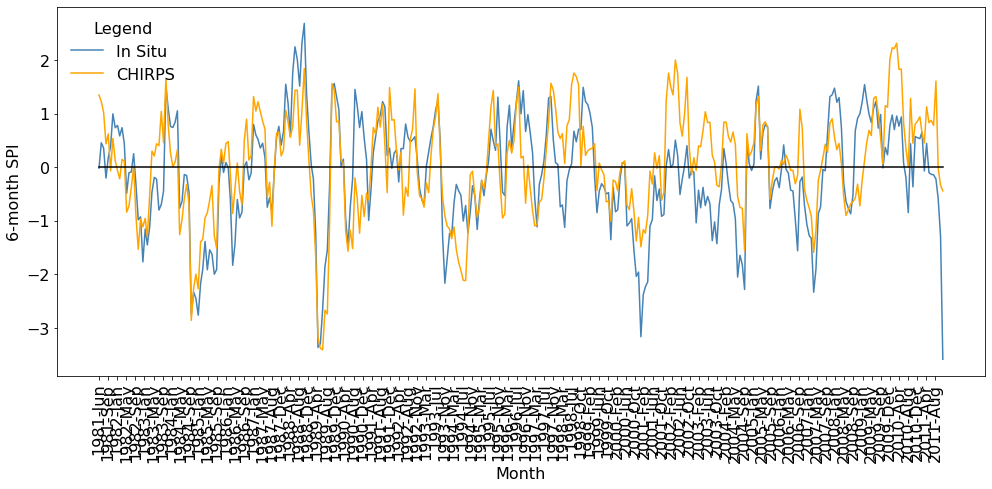

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:646: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


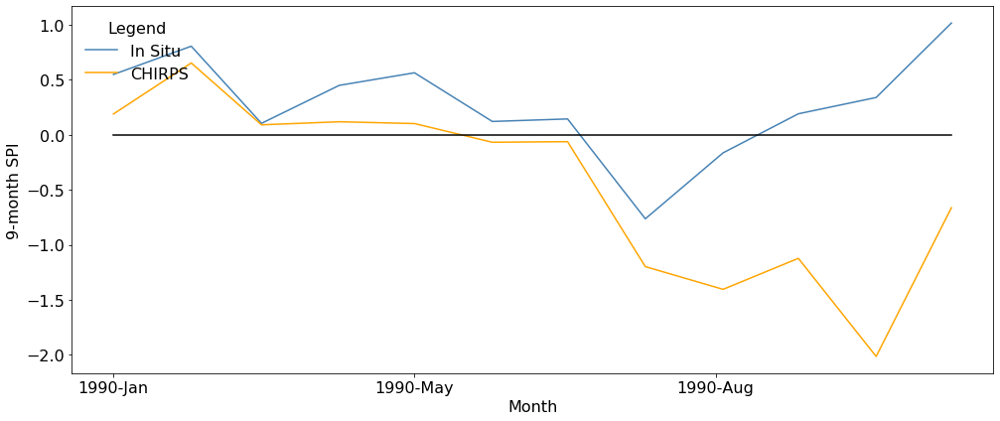

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:694: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


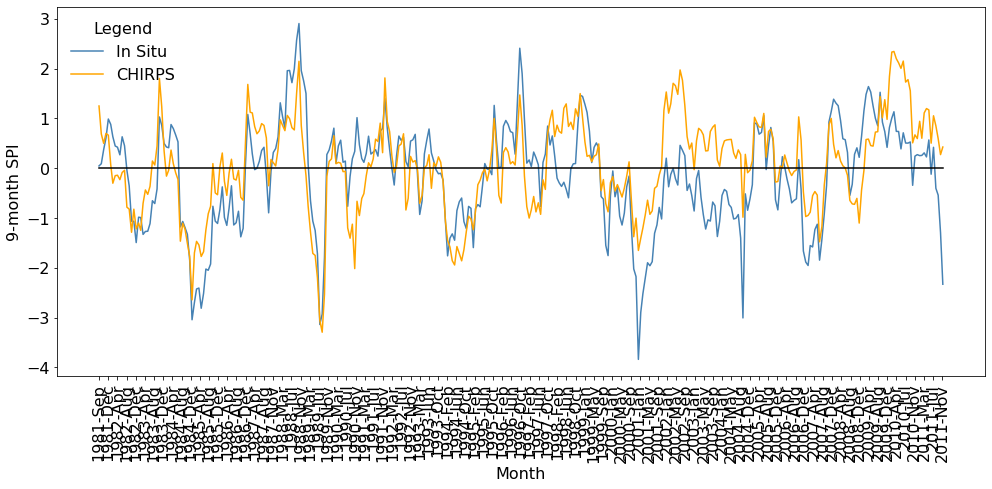

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:749: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


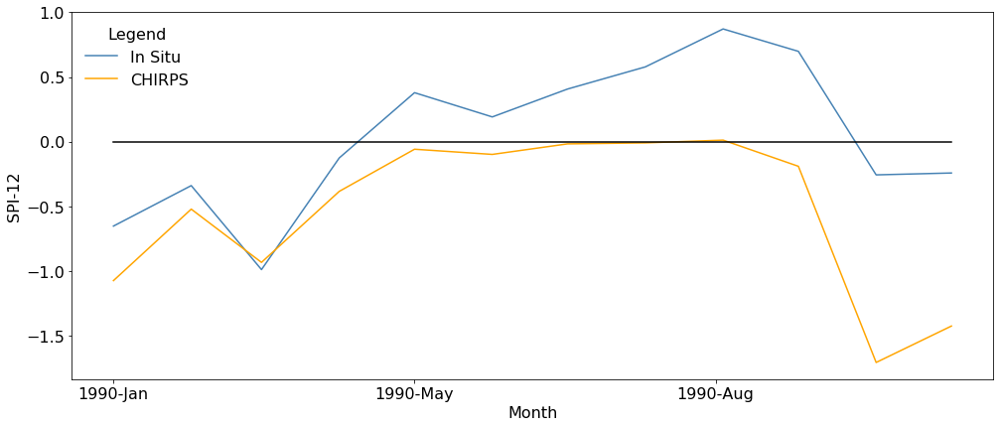

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:798: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


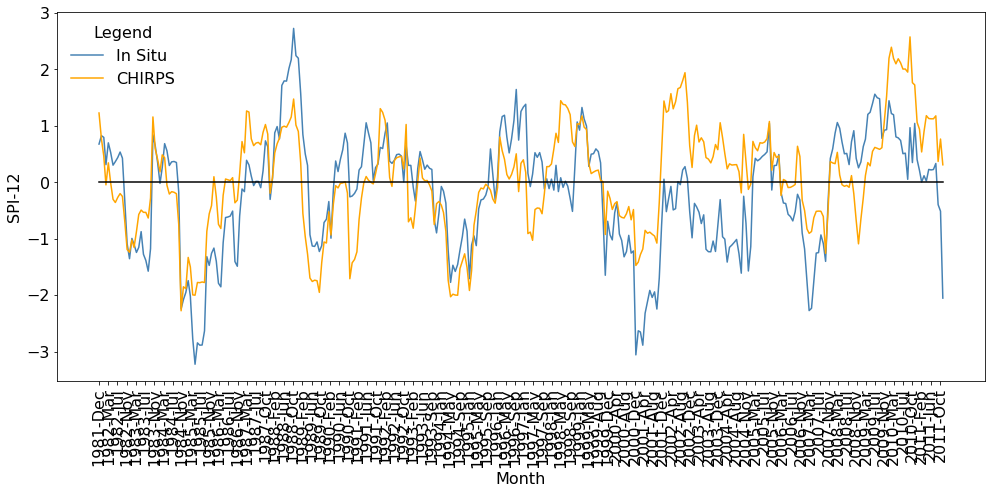

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


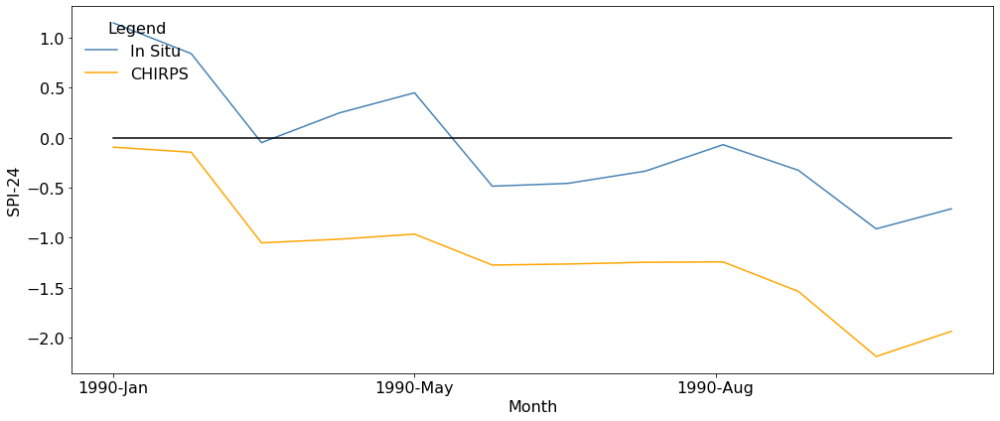

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


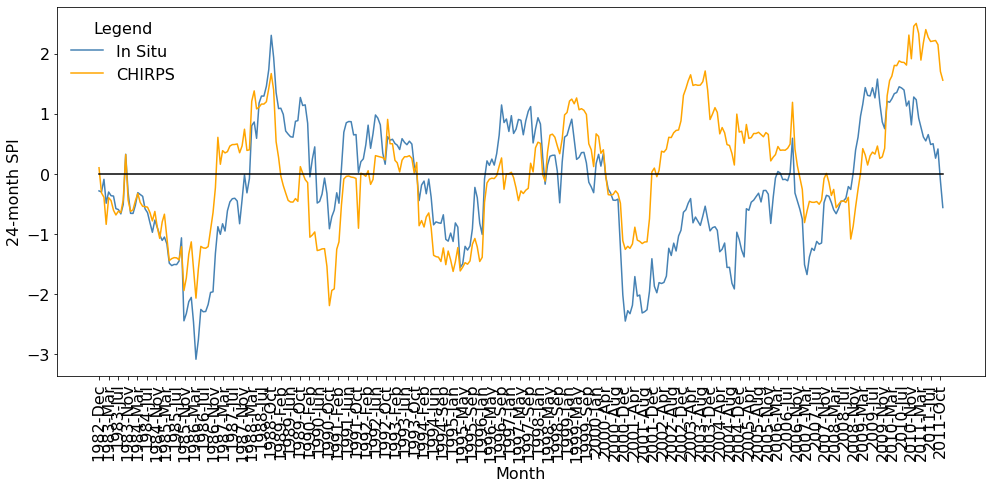

17840
done
 


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:338: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


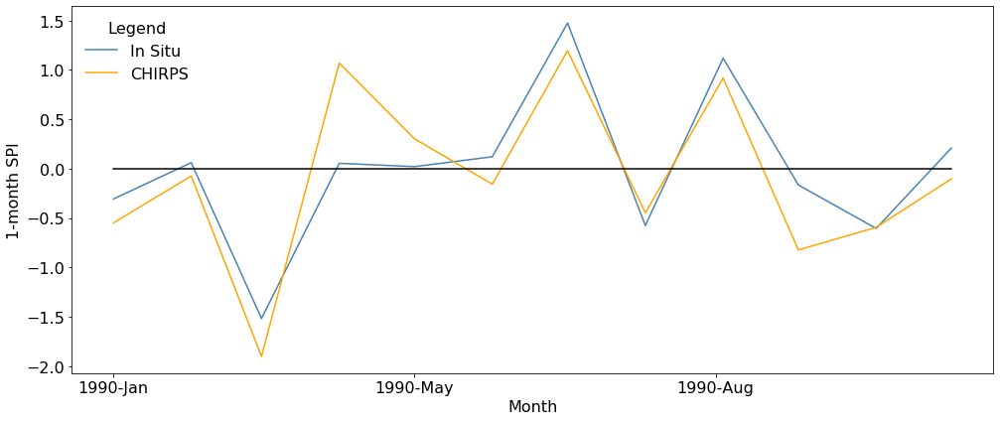

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:385: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


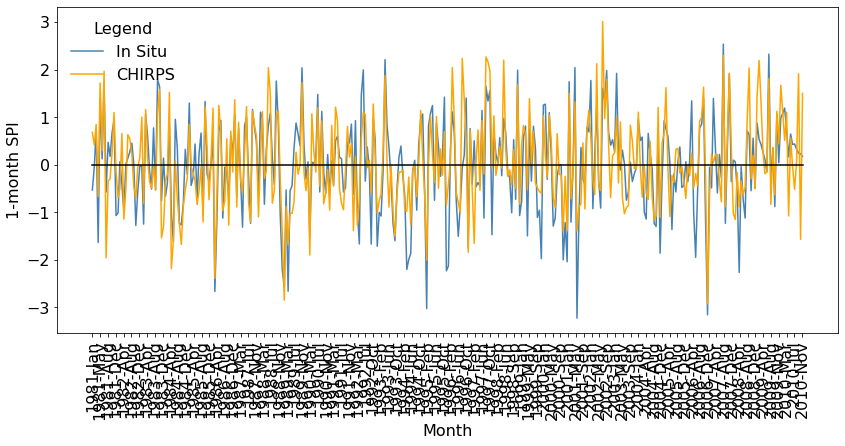

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:440: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


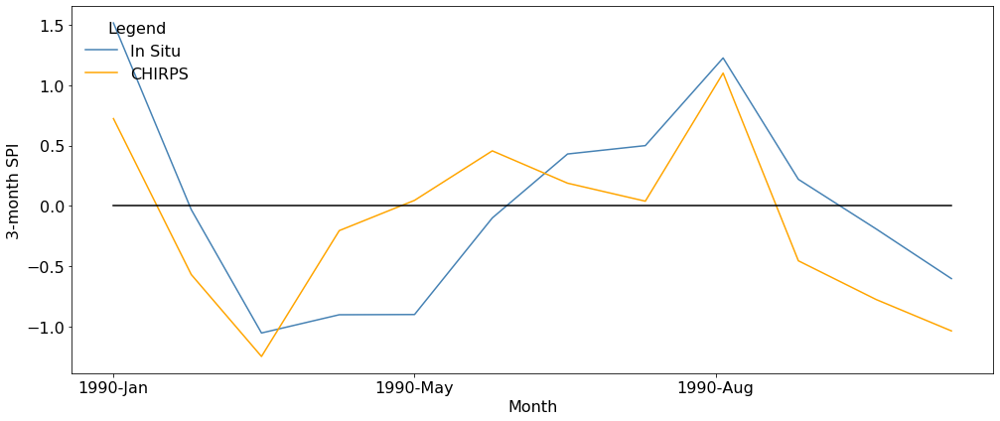

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:488: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


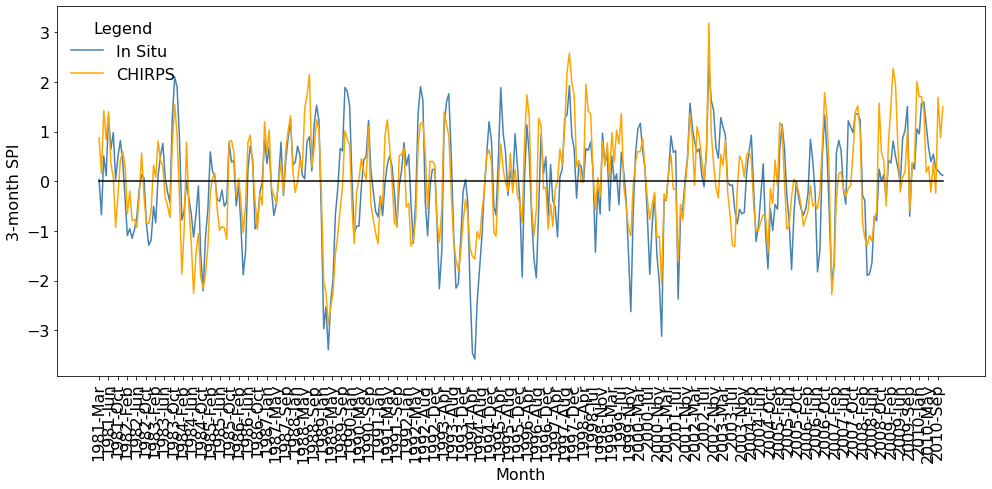

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


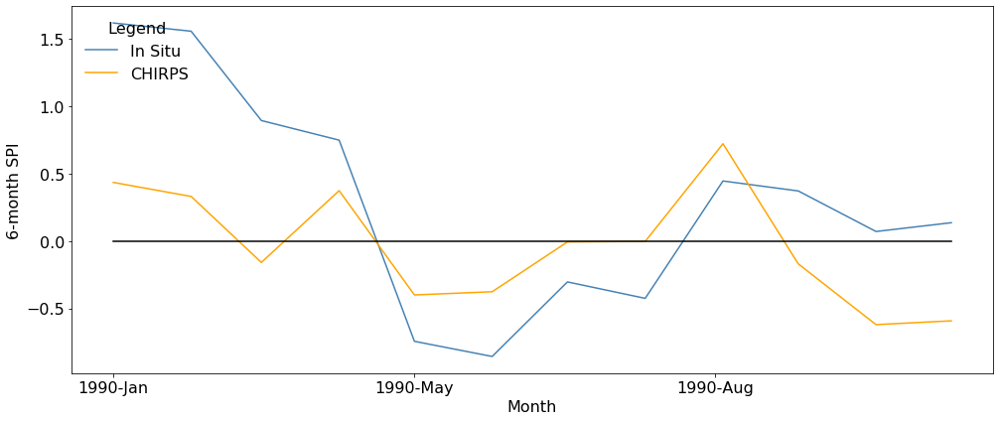

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:591: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


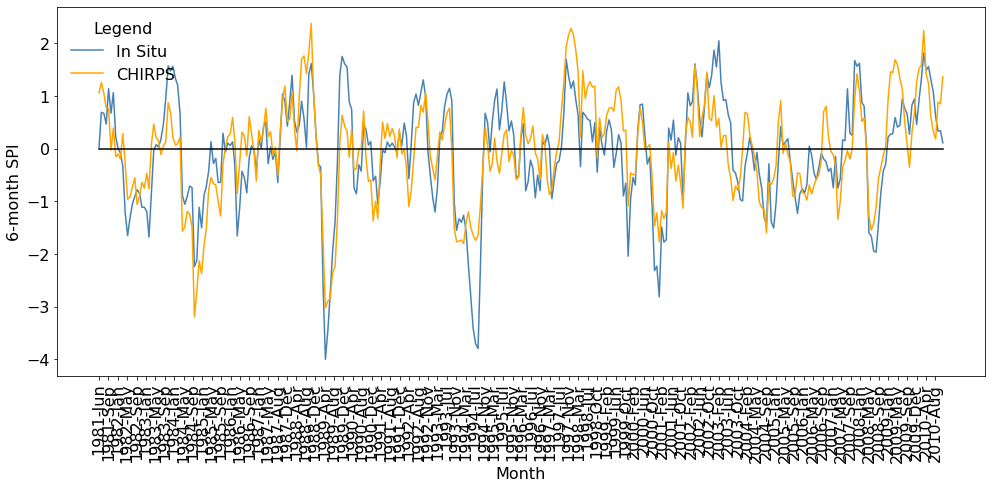

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:646: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


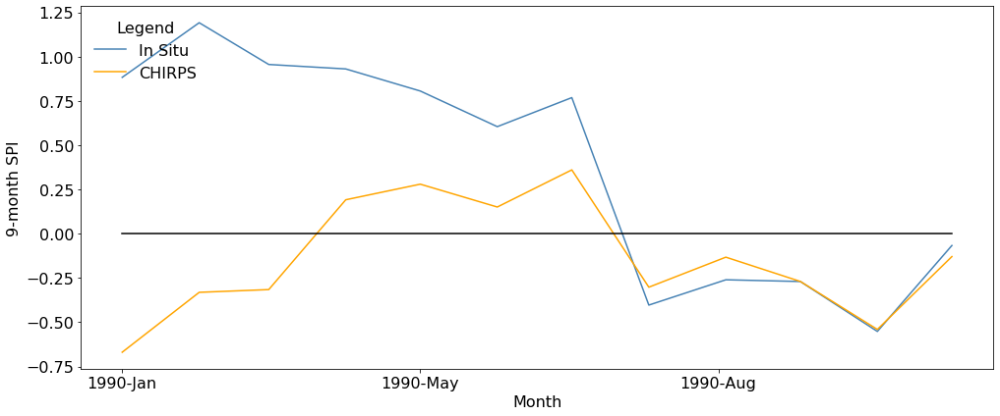

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:694: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


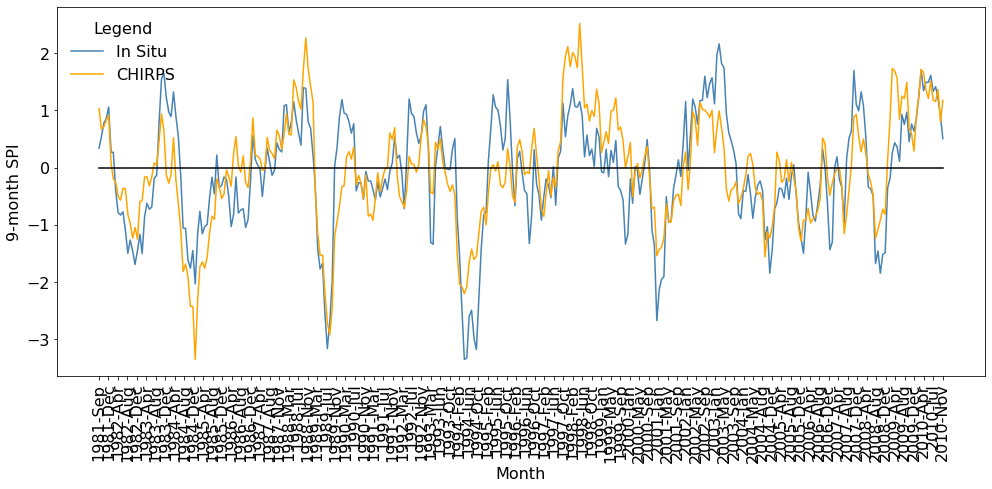

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:749: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


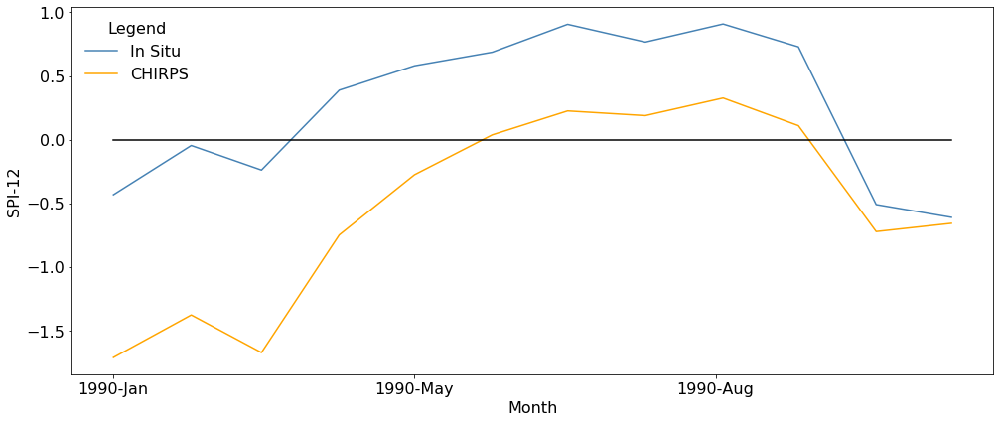

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:798: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


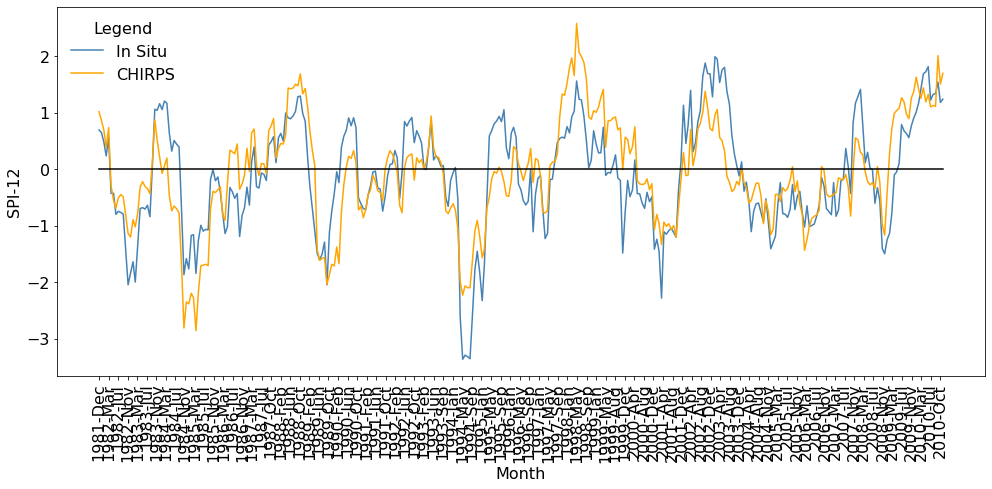

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


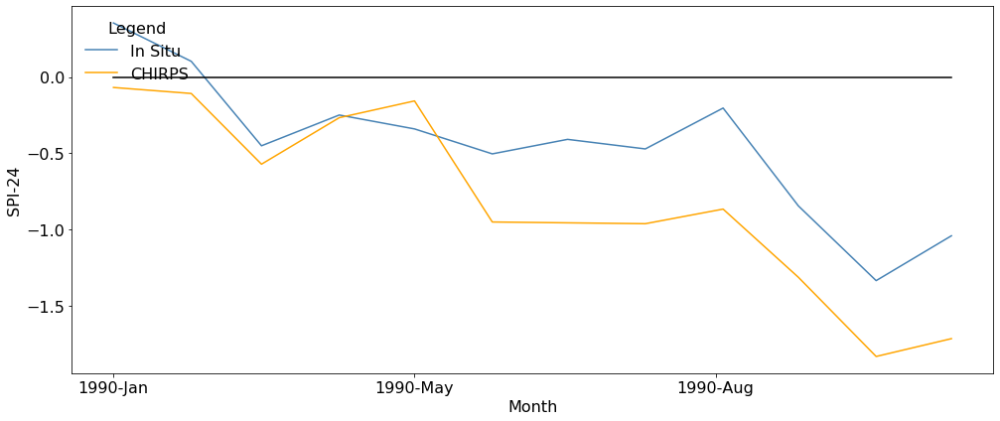

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


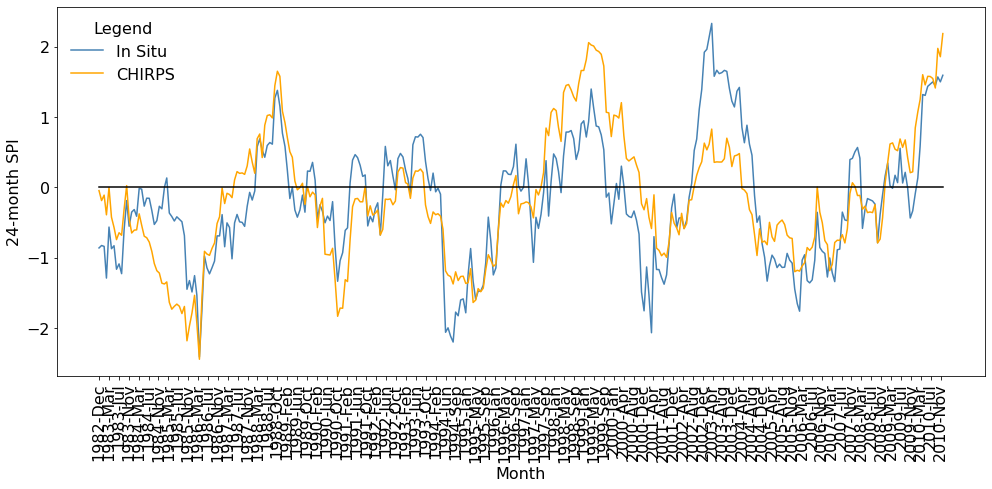

17837
done
 


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:338: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


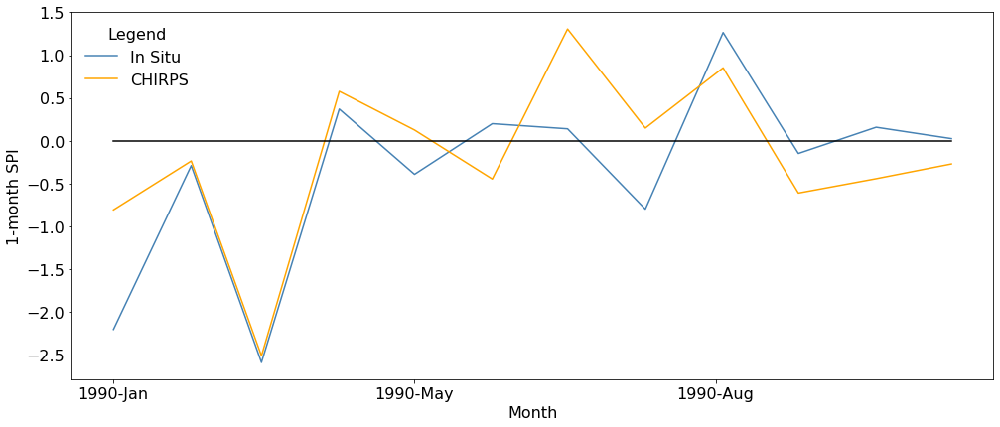

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:385: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


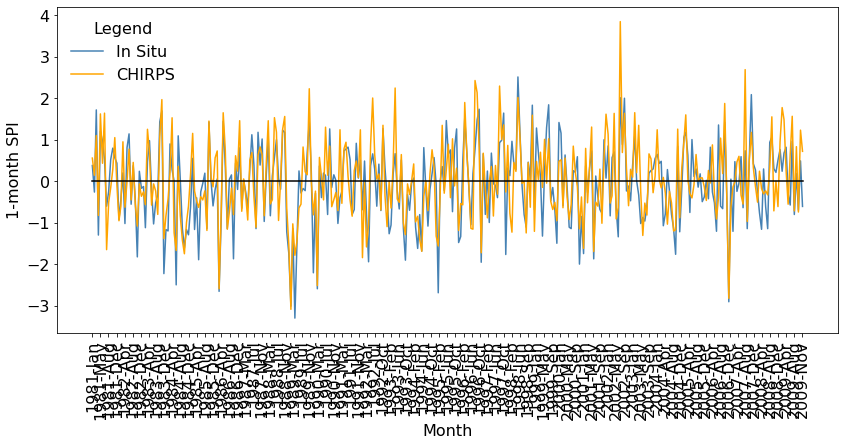

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:440: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


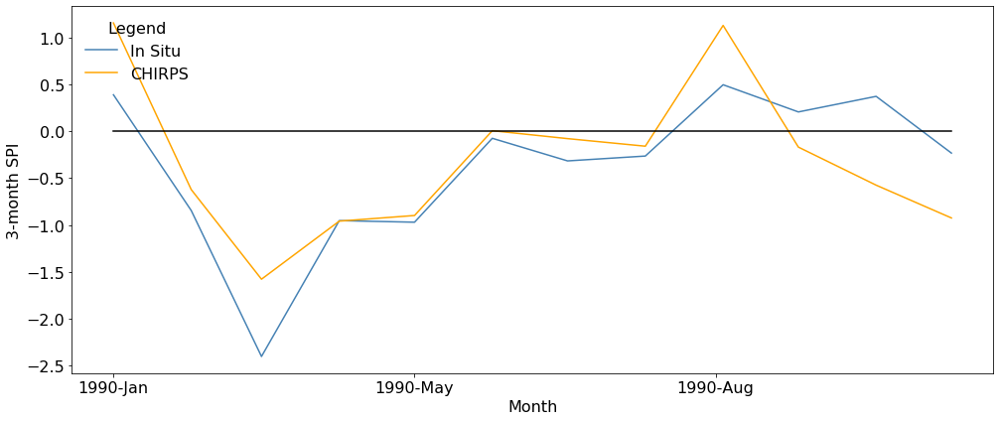

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:488: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


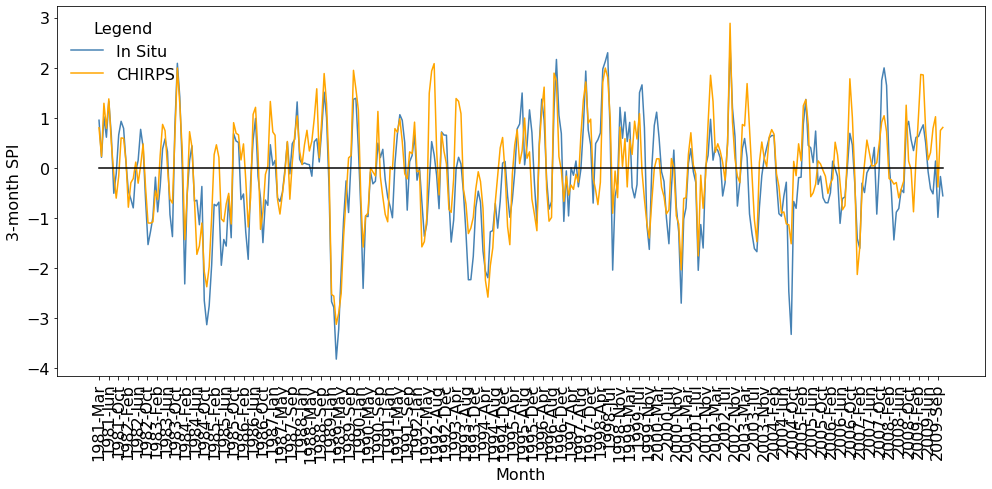

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


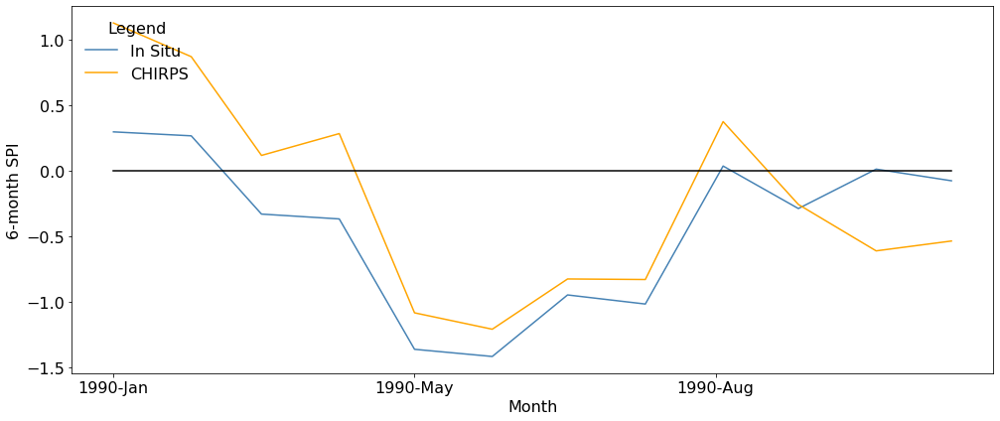

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:591: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


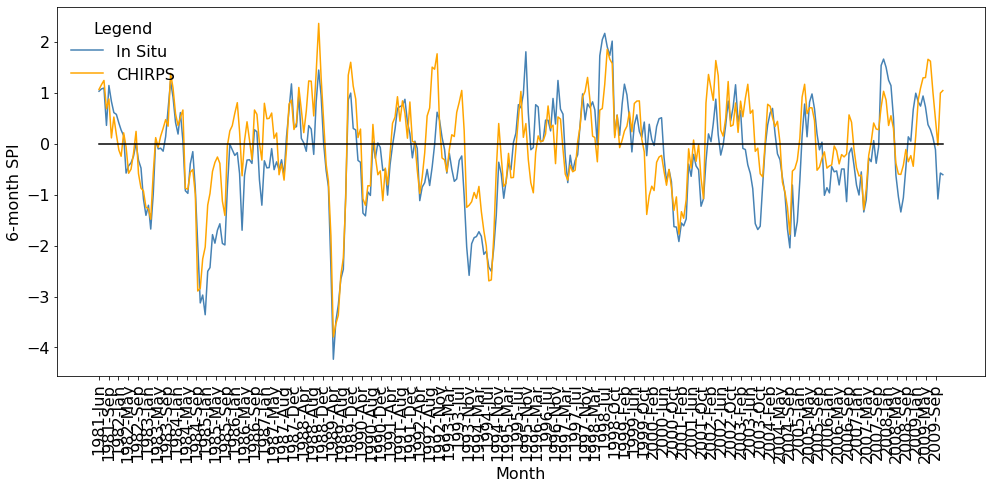

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:646: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


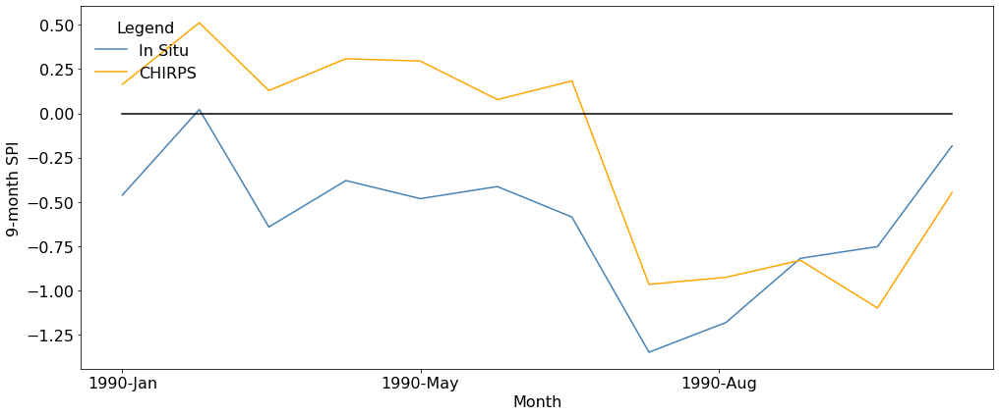

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:694: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


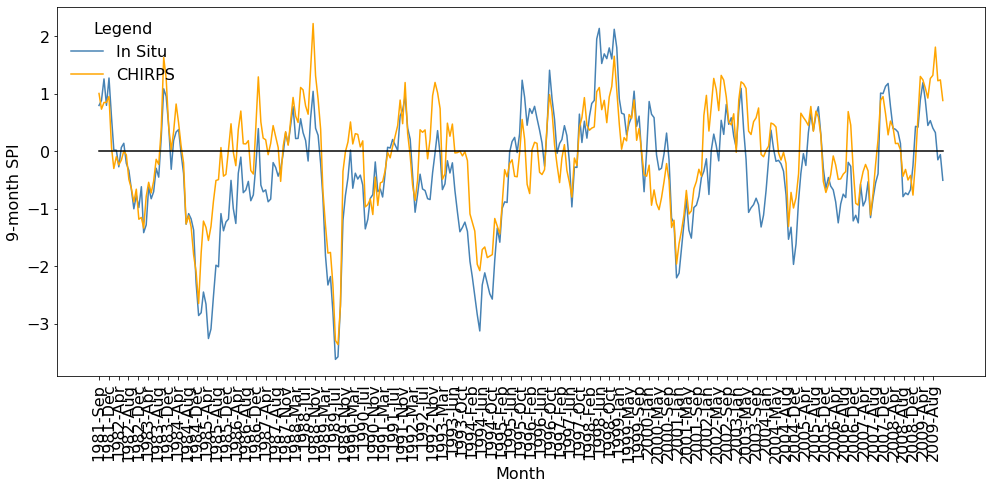

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:749: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


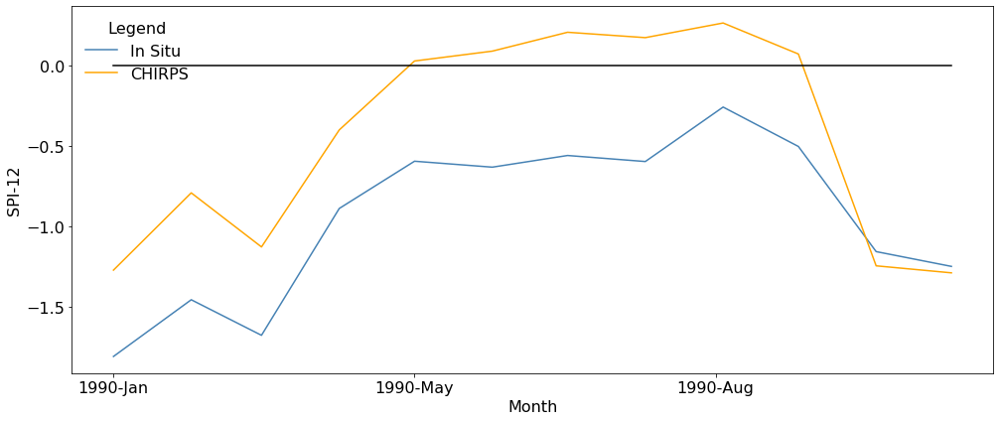

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:798: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


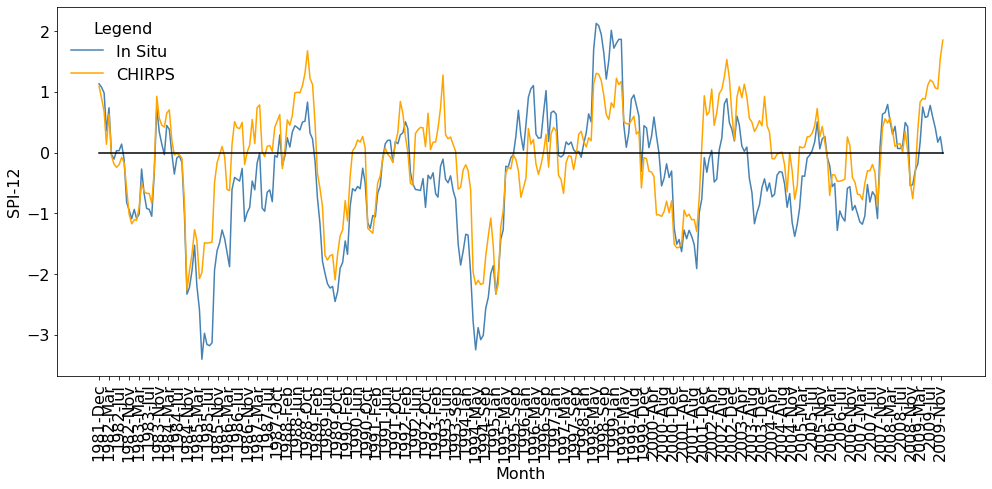

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


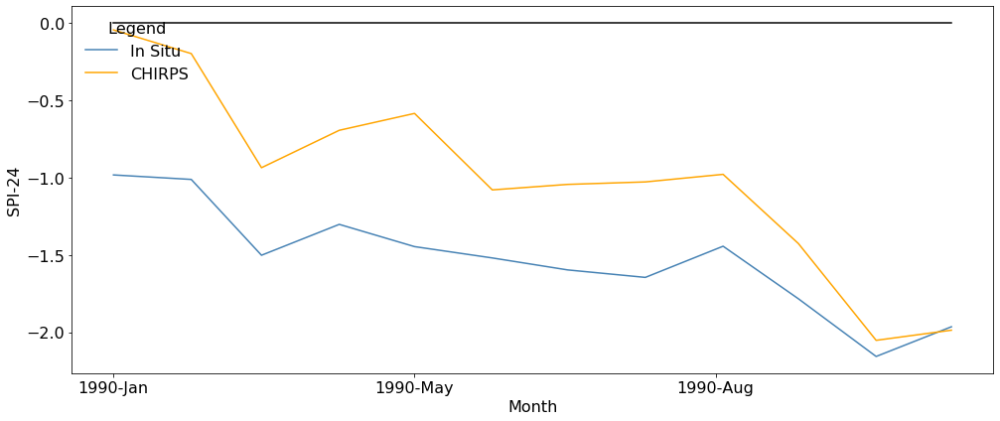

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


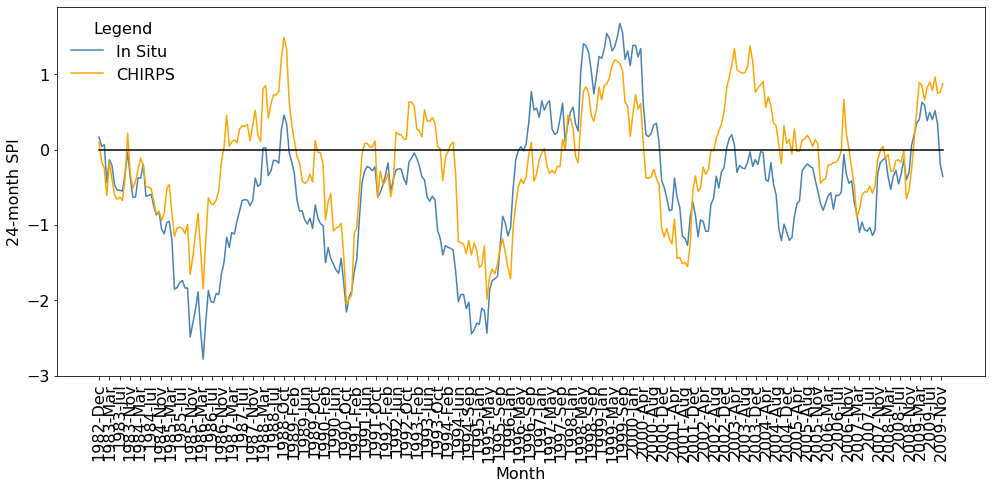

17802
done
 


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:338: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


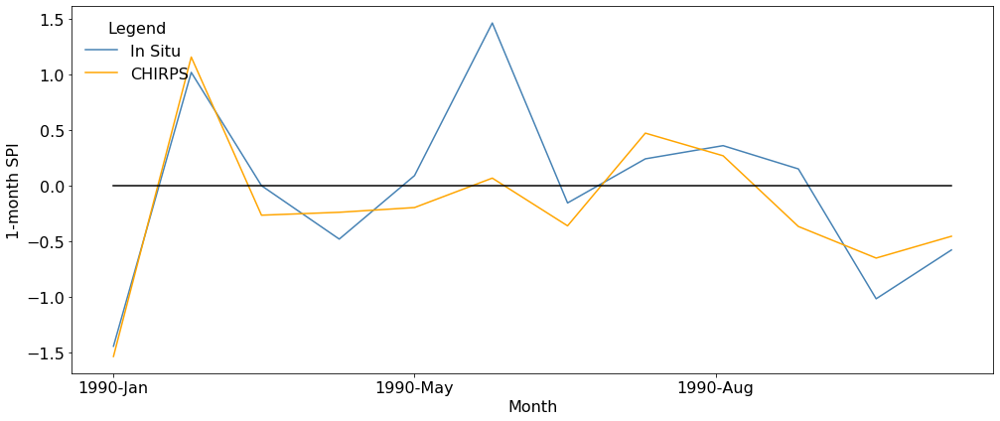

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:385: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


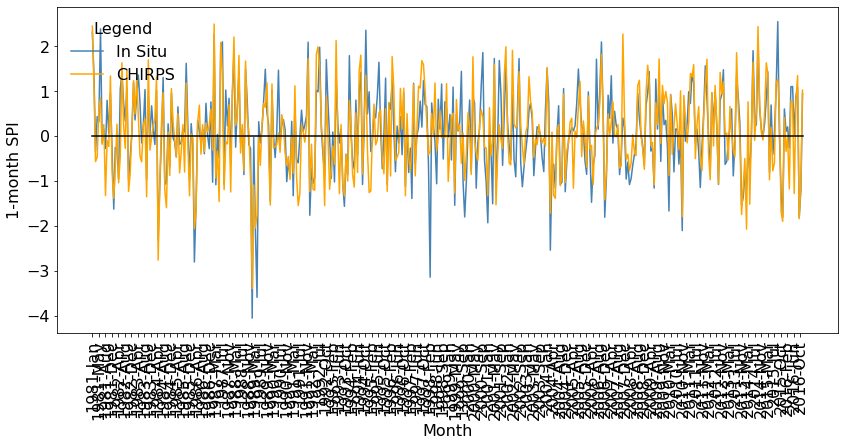

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:440: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


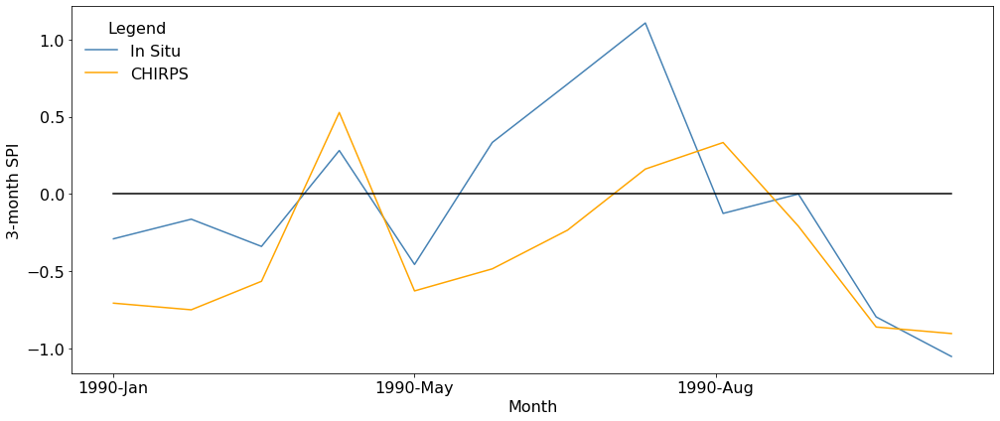

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:488: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


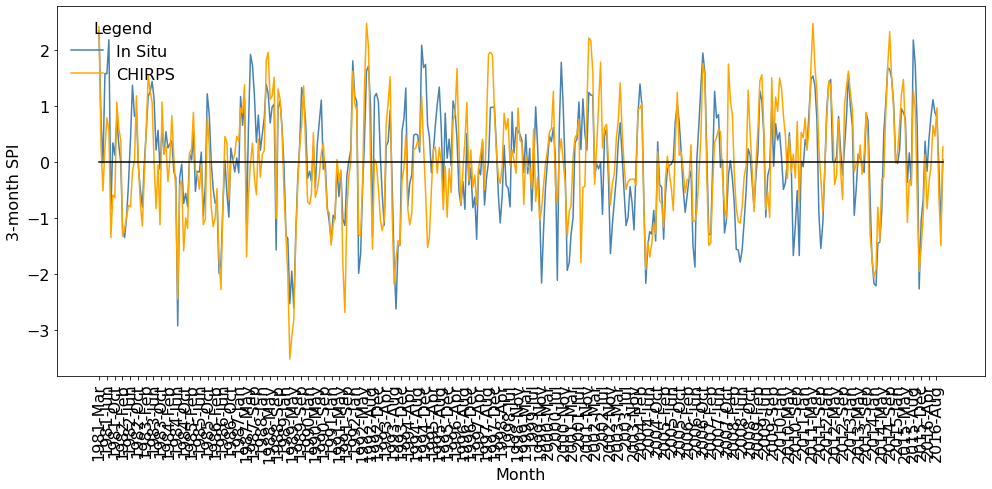

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


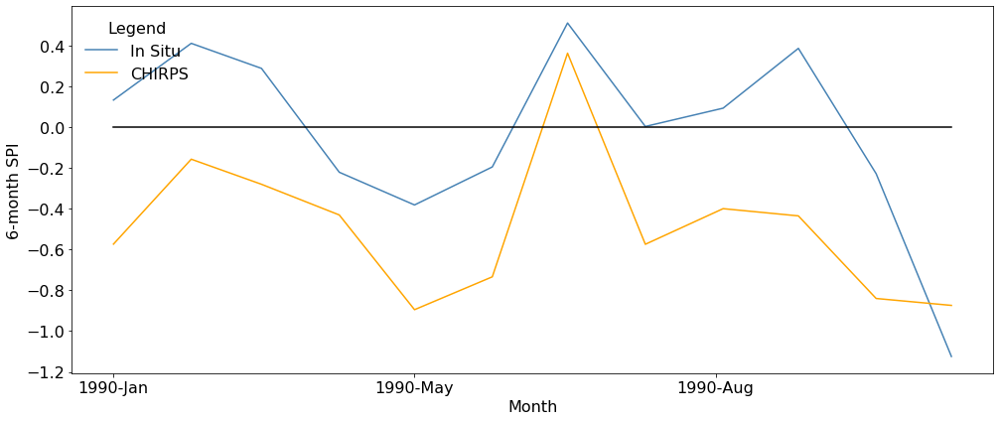

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:591: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


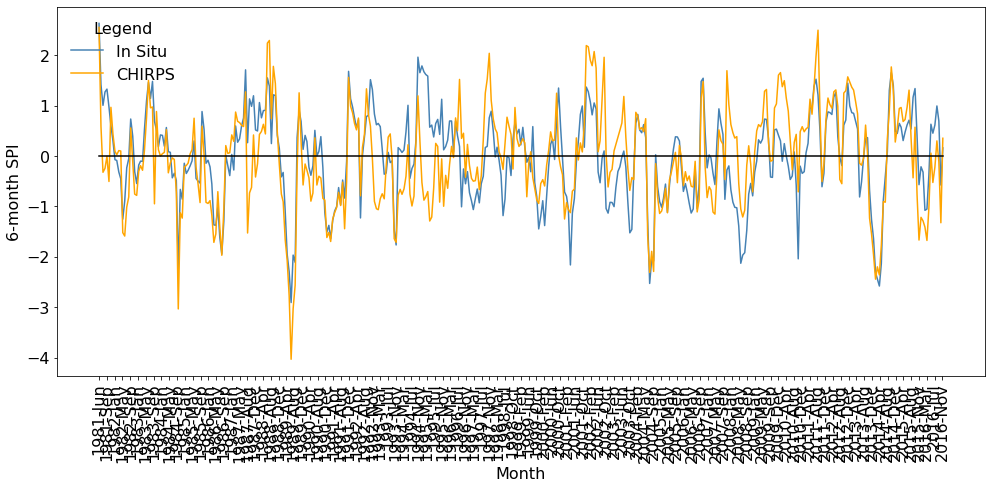

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:646: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


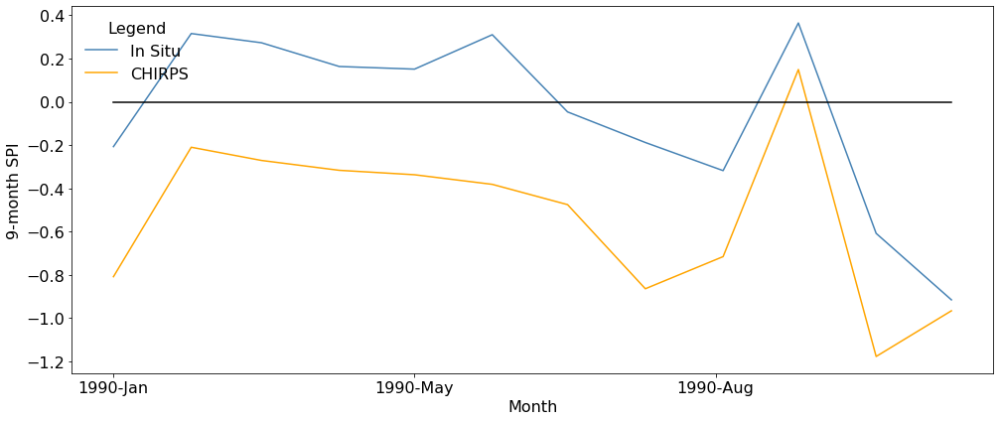

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:694: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


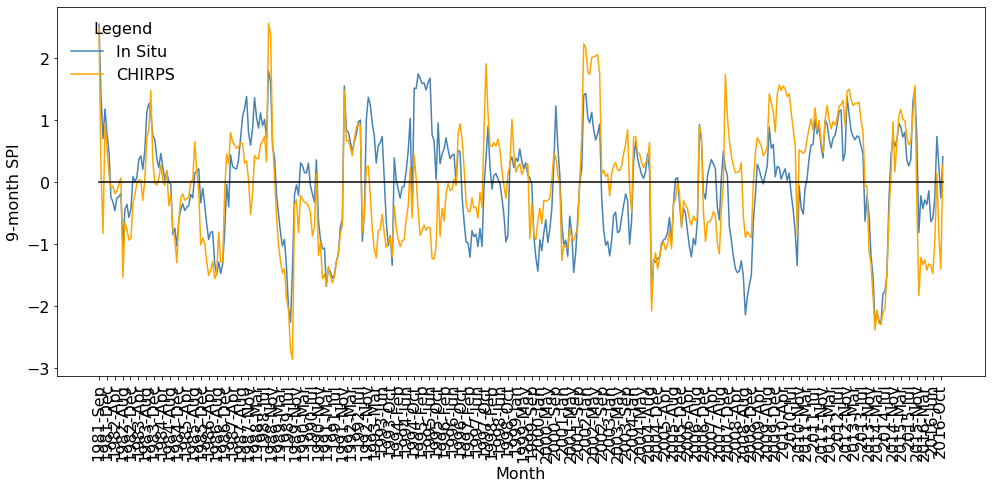

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:749: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


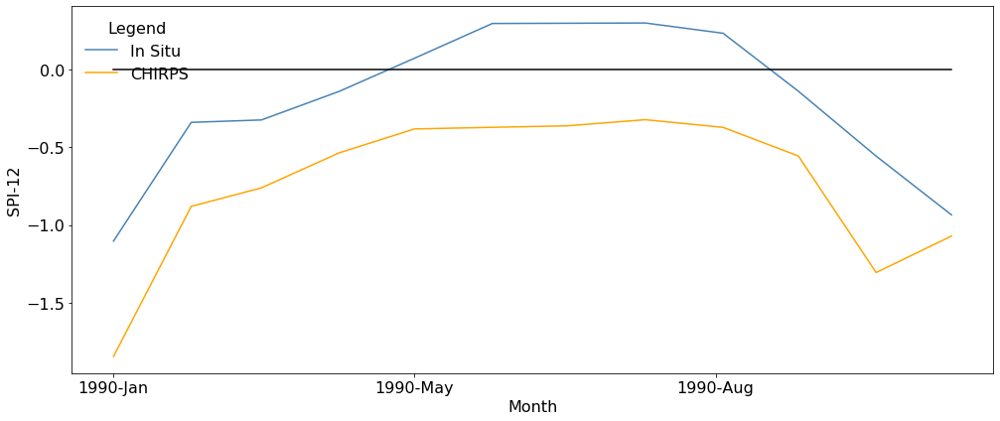

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:798: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


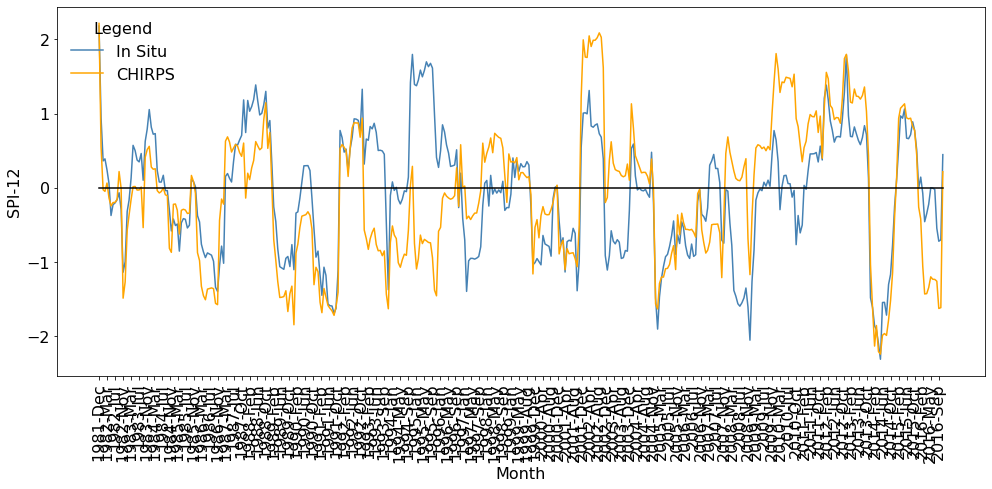

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


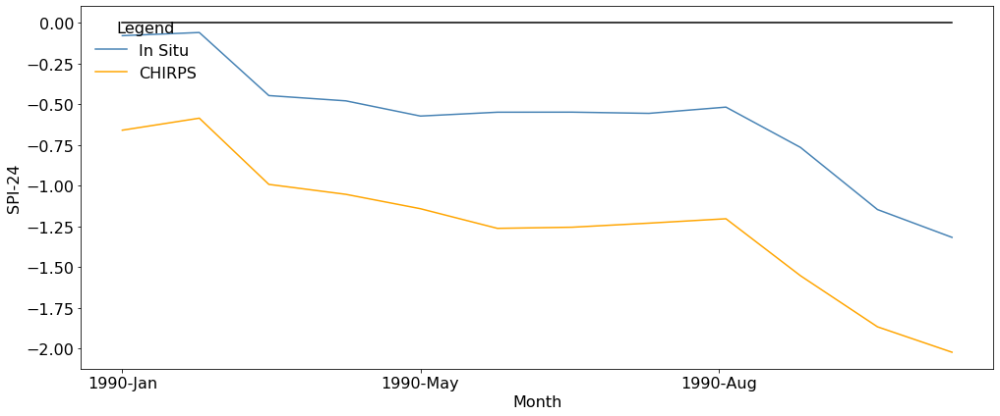

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


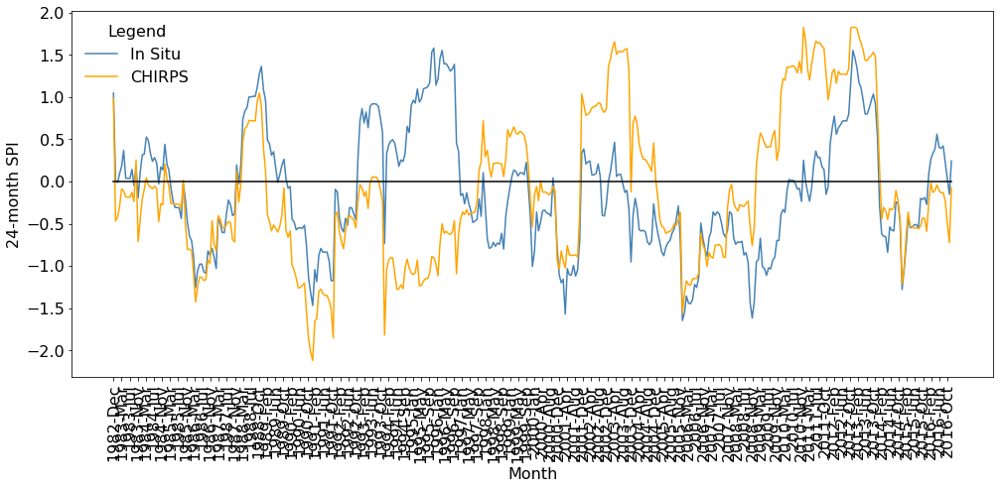

17351
done
 


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:338: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


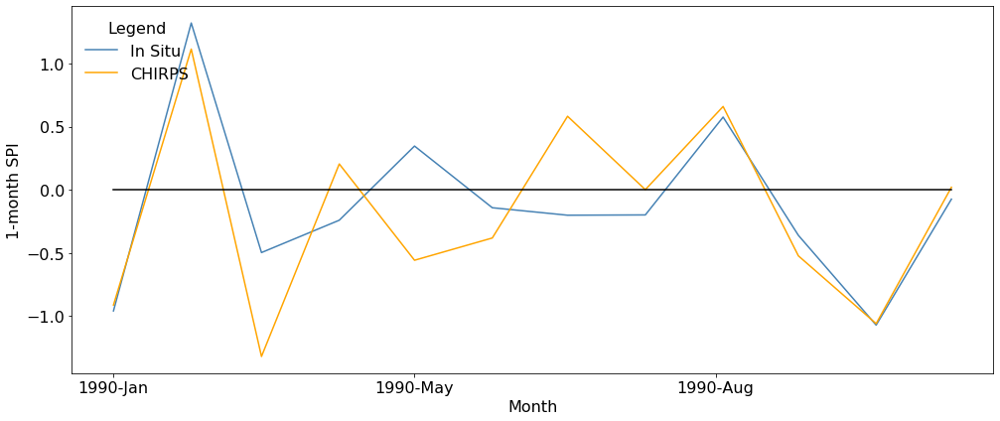

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:385: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


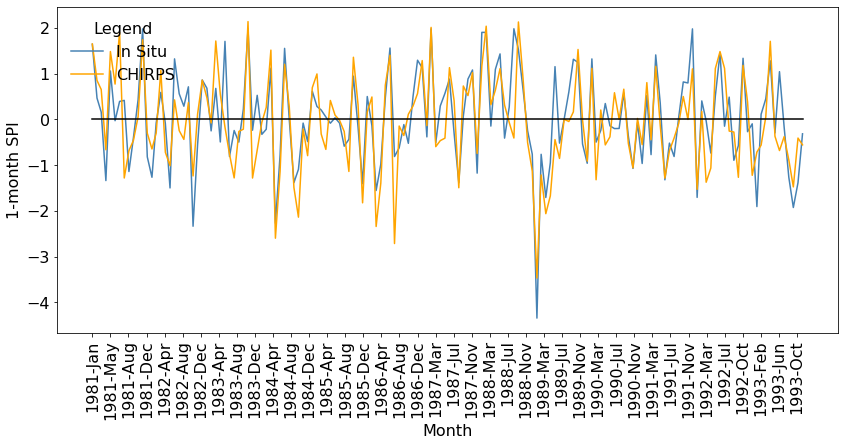

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:440: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


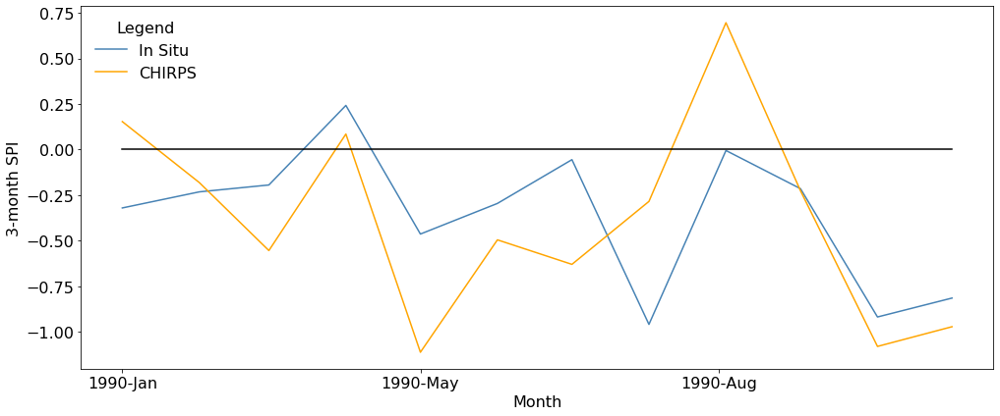

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:488: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


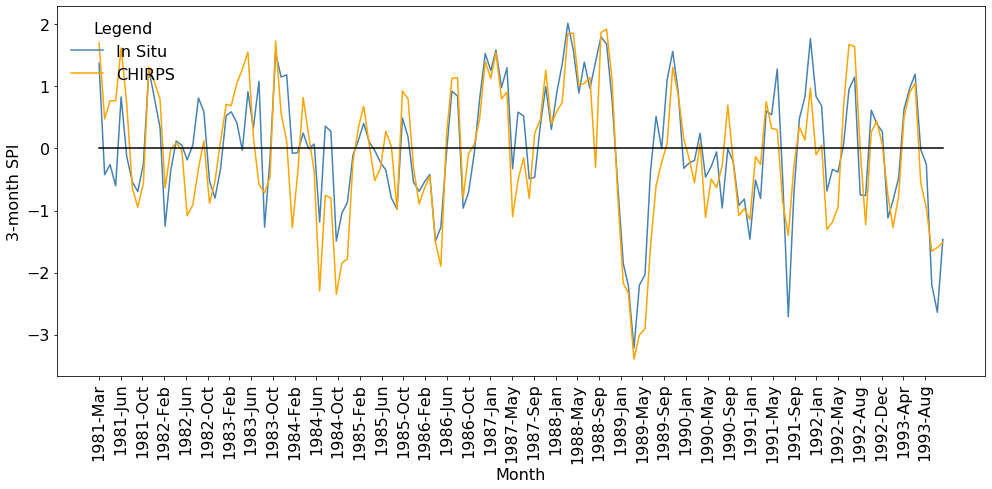

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


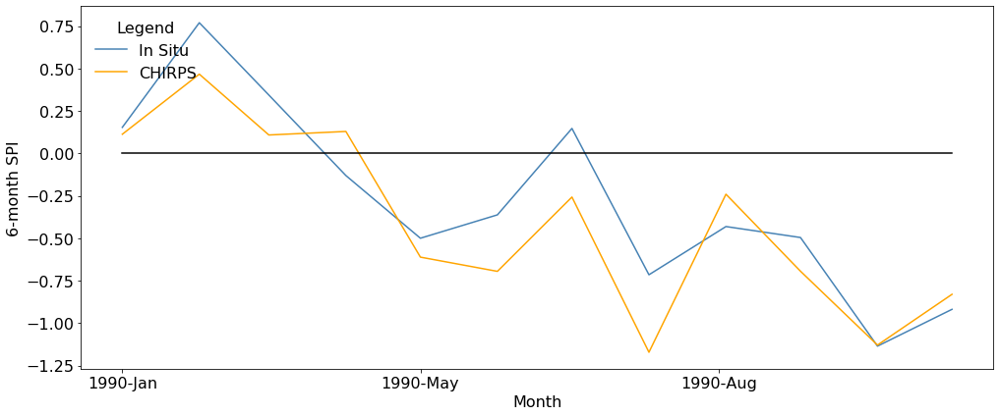

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:591: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


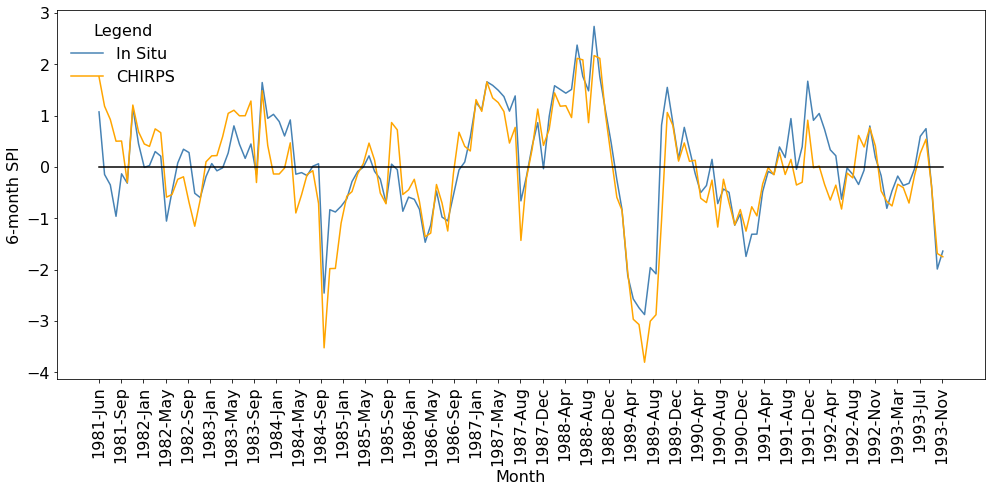

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:646: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


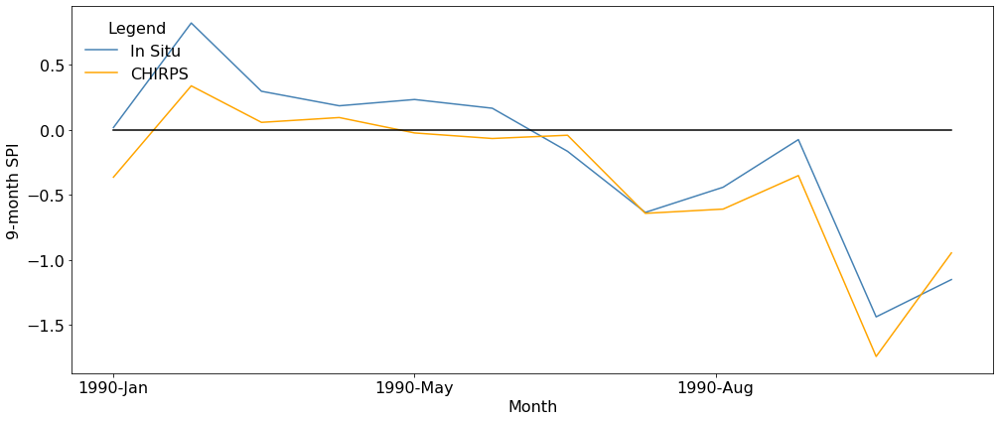

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:694: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


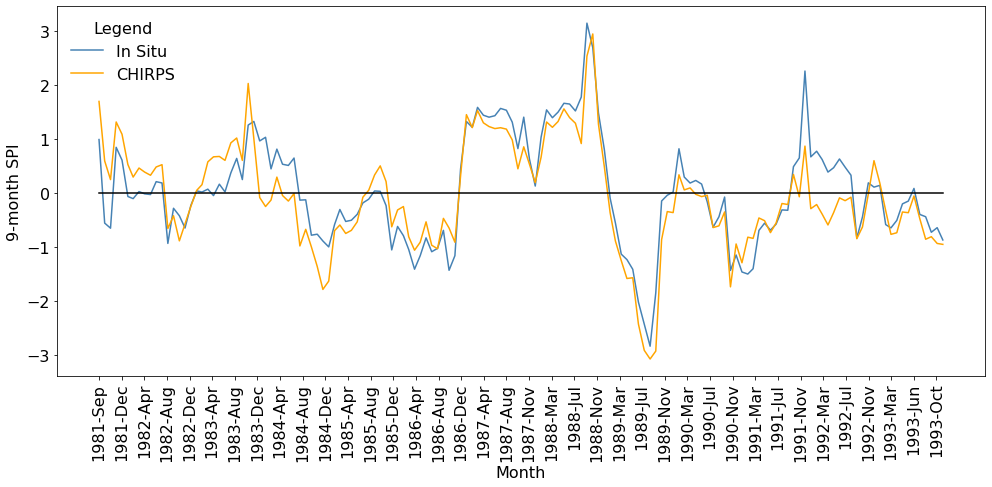

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:749: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


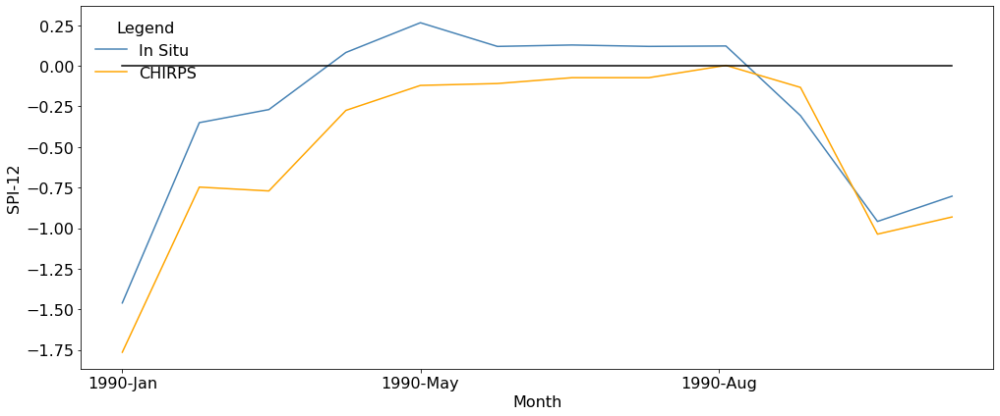

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:798: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


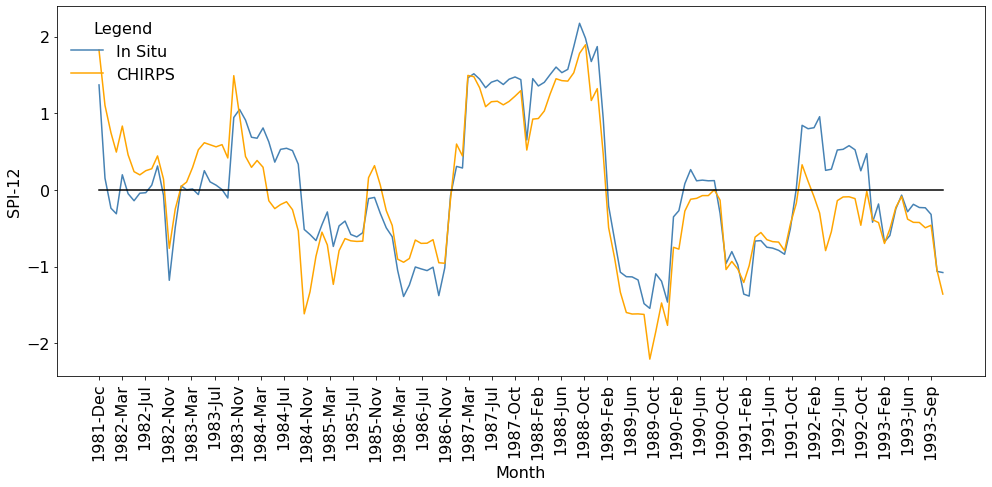

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


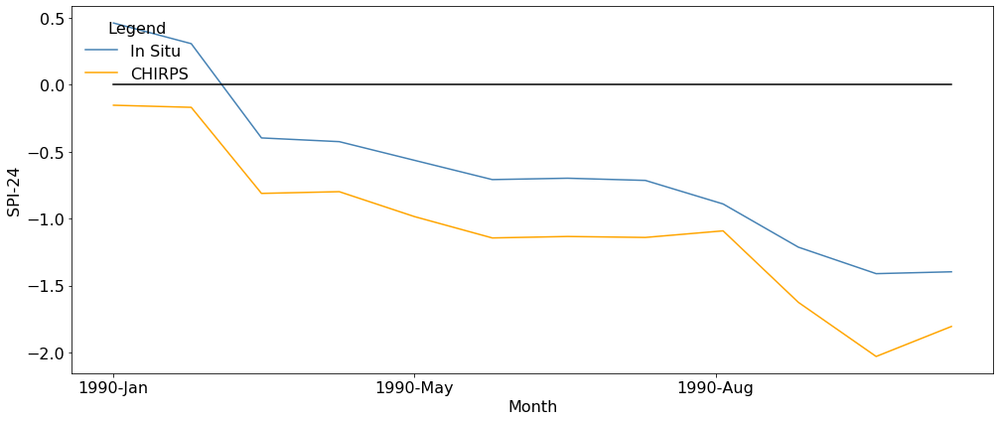

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


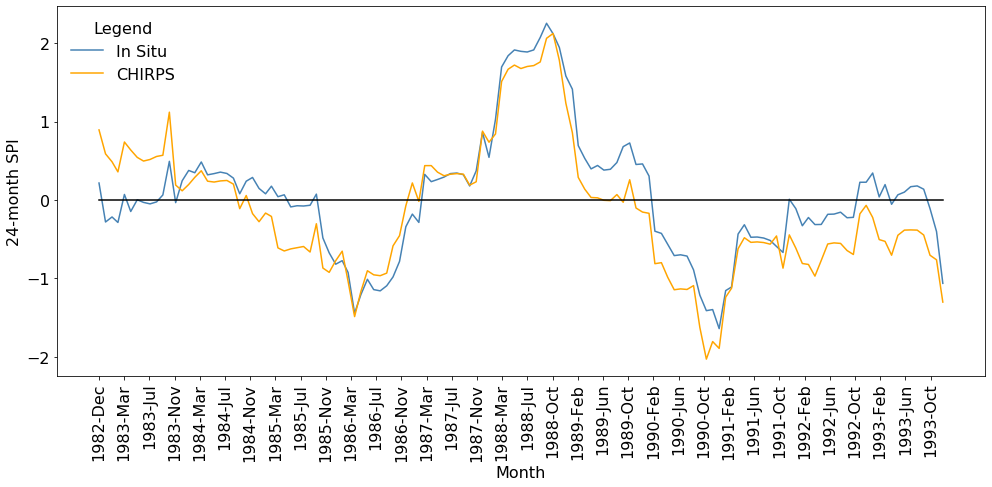

06902
done
 


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:338: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


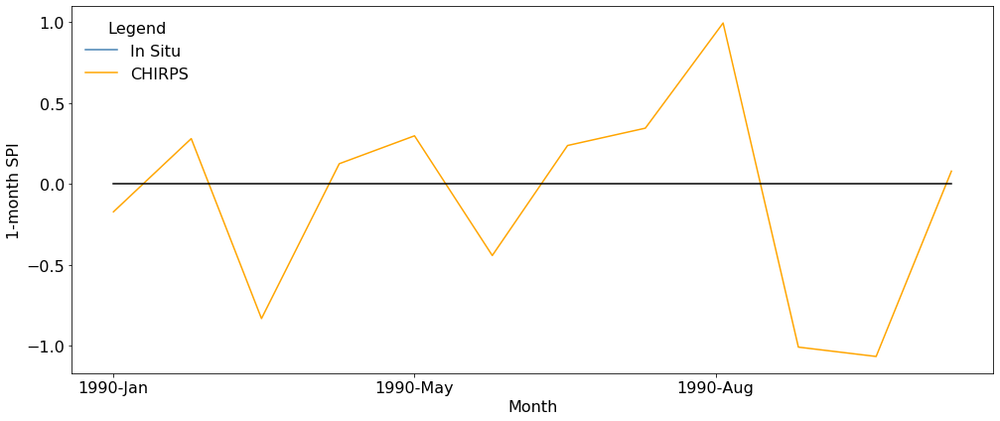

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:385: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


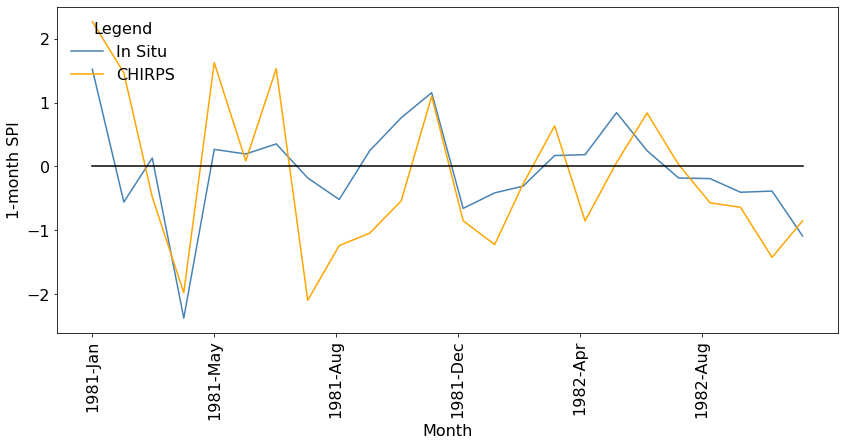

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:440: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


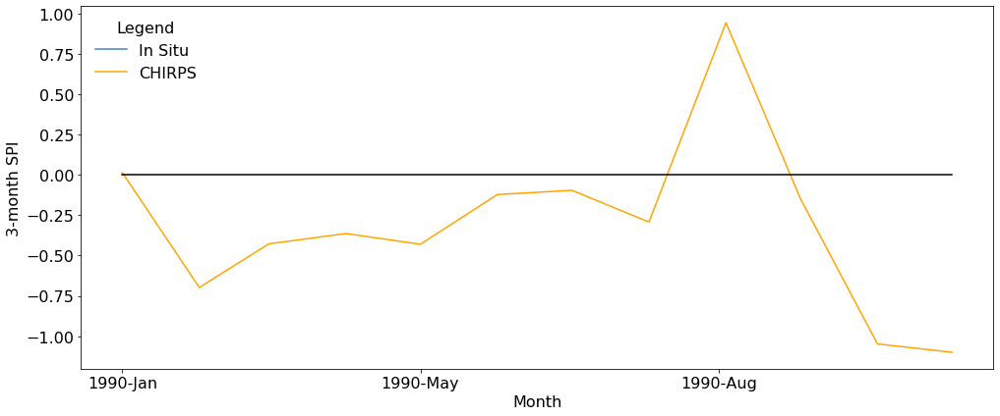

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:488: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


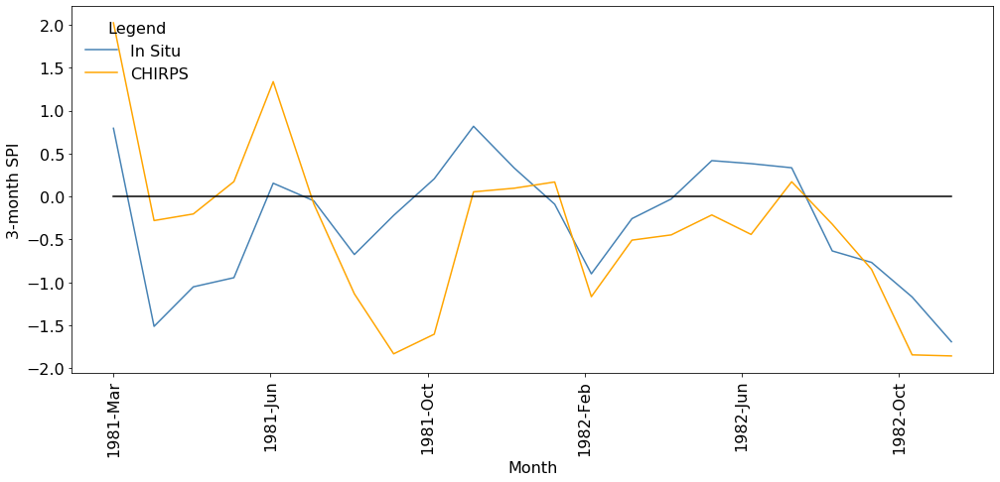

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


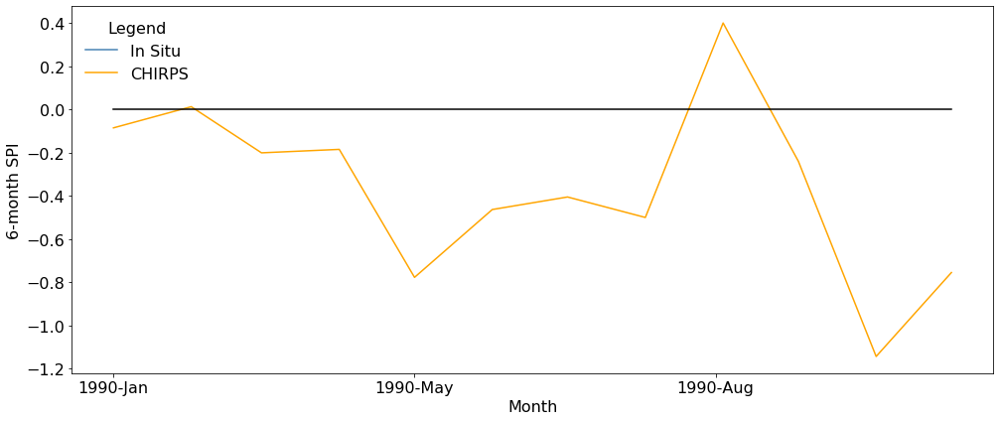

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:591: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


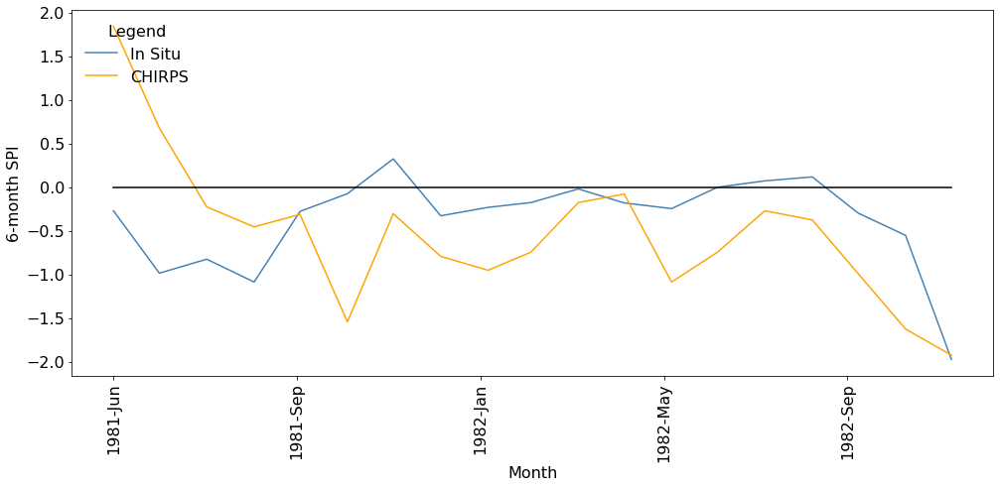

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:646: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


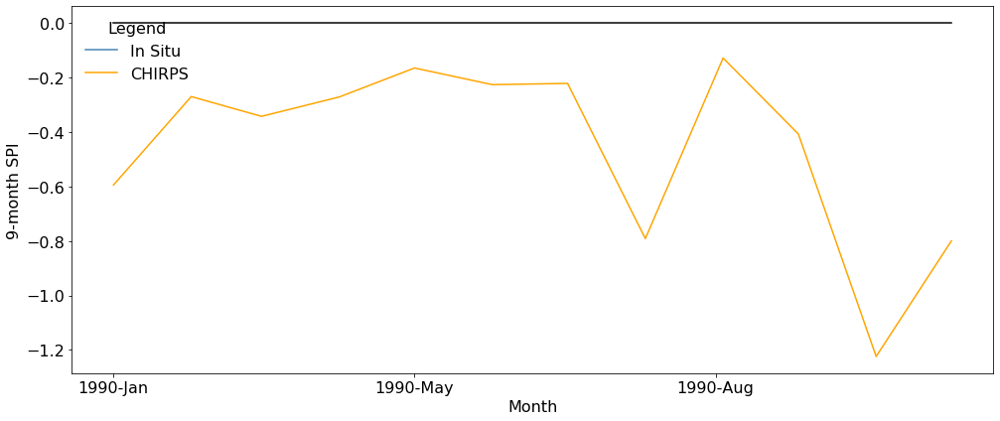

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:694: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


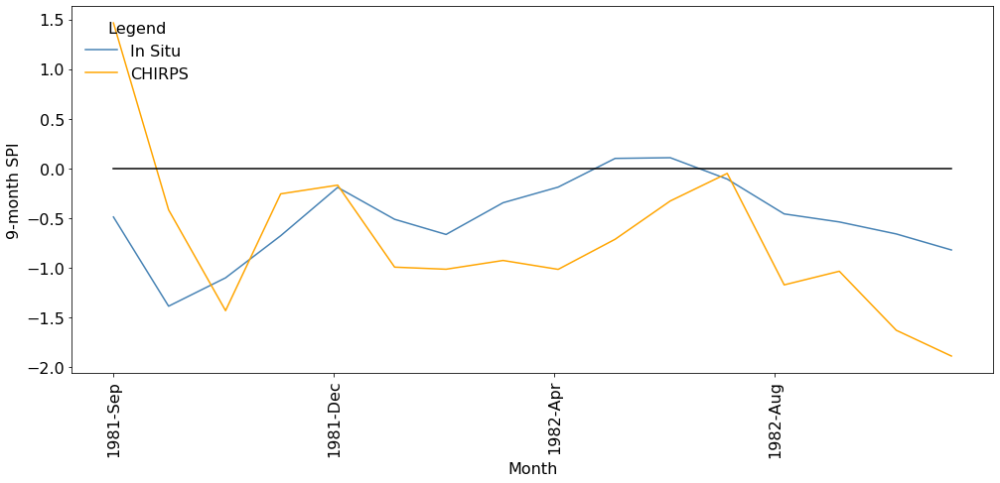

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:749: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


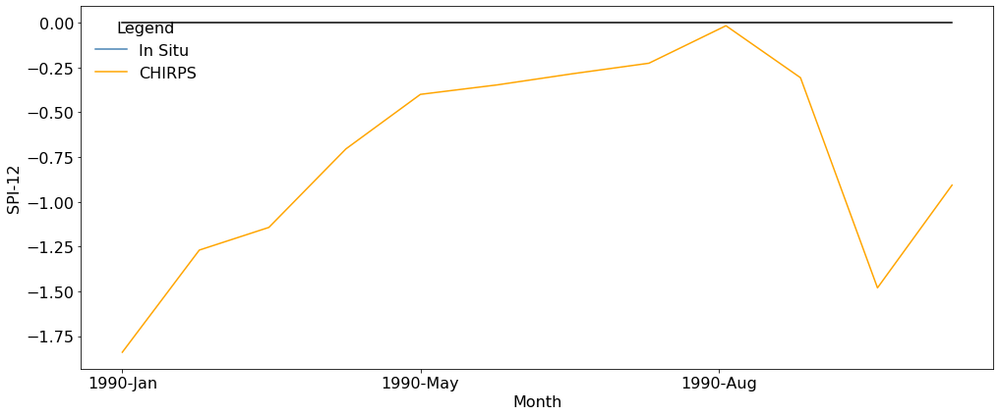

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:798: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


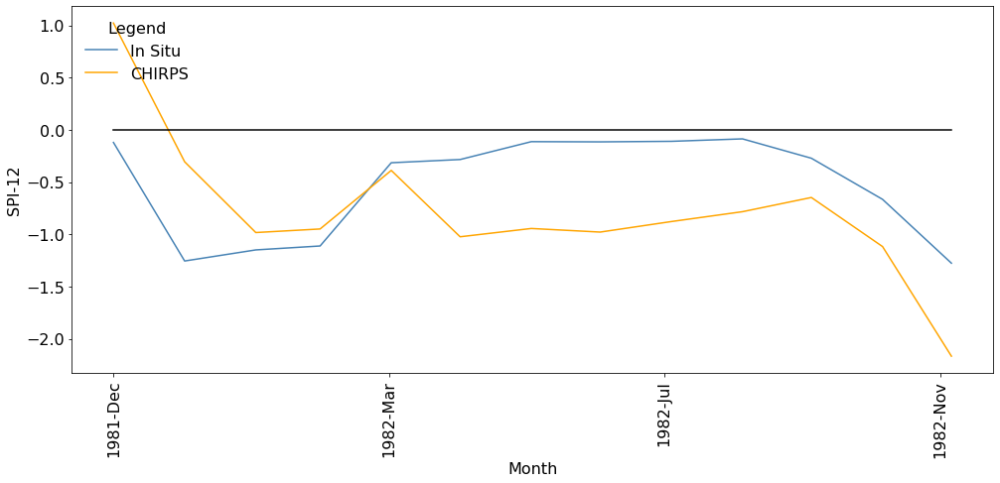

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


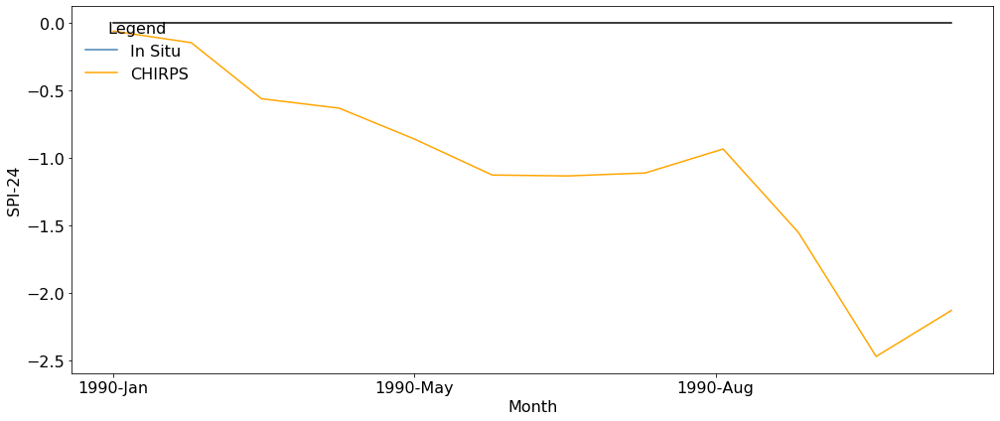

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


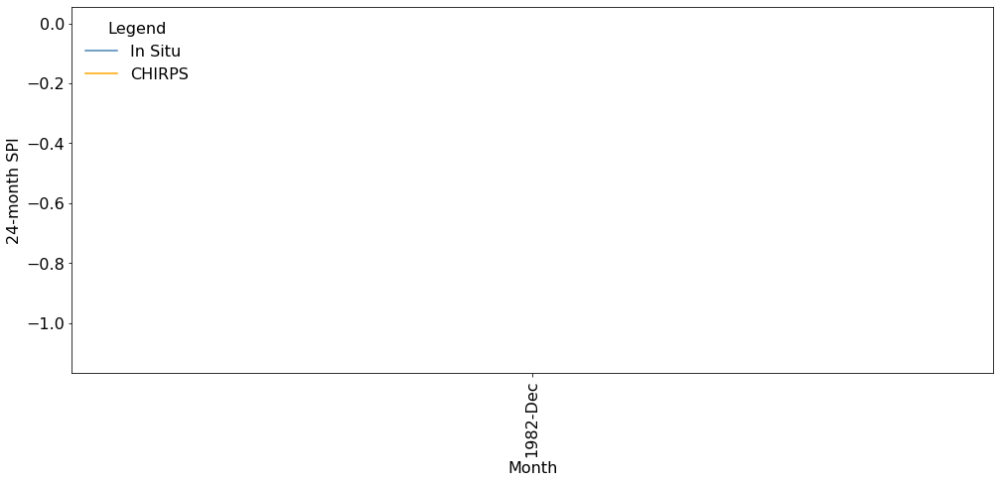

06893
done
 


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:338: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


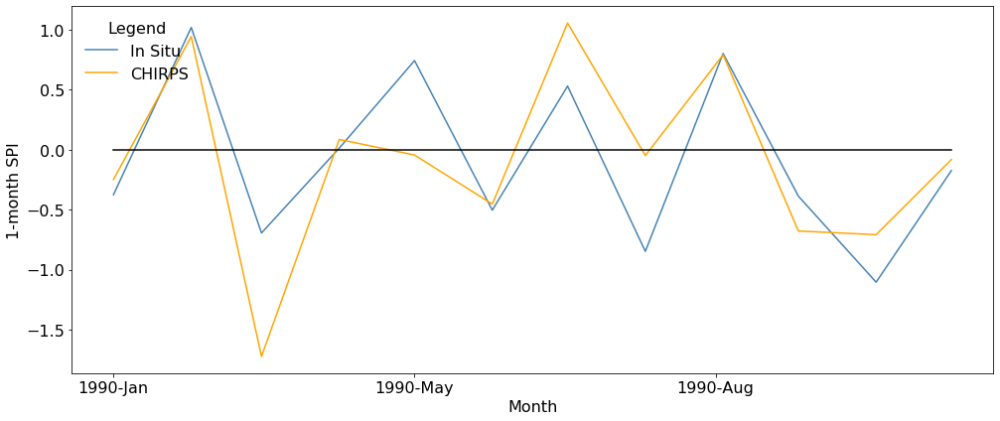

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:385: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


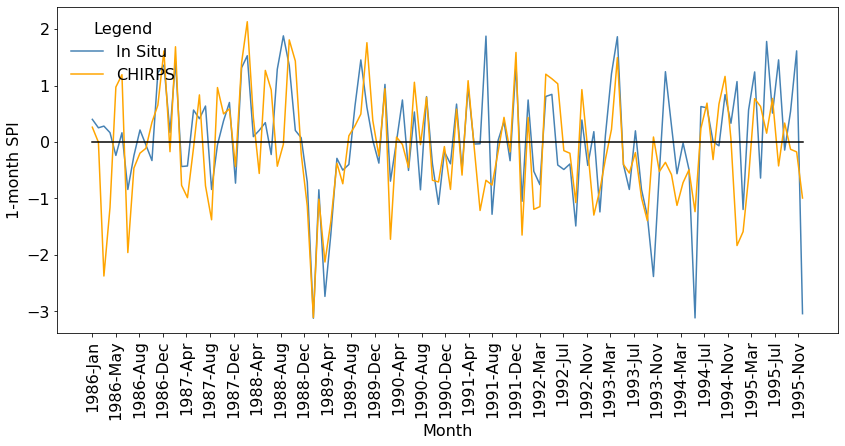

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:440: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


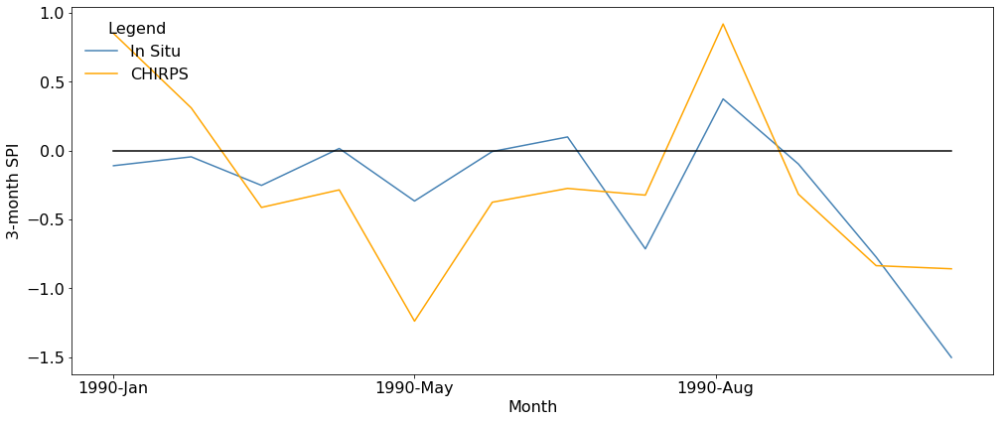

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:488: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


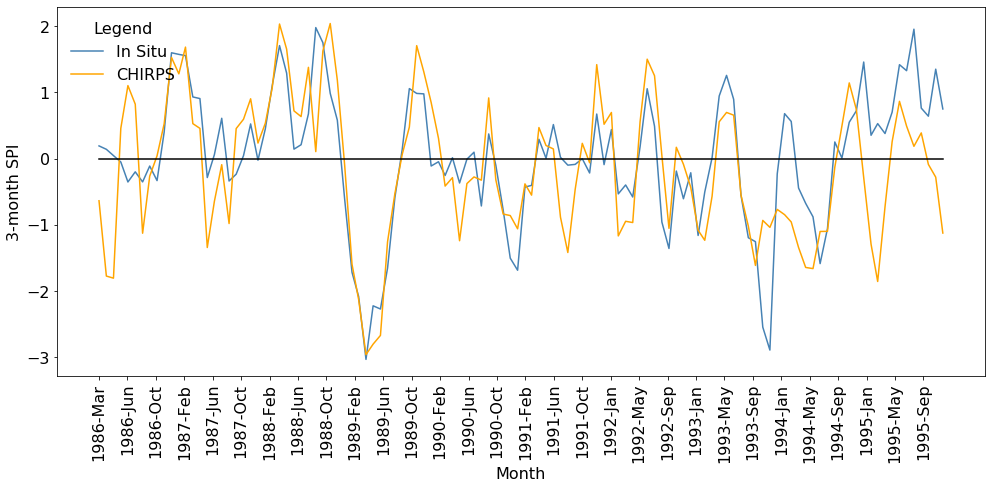

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


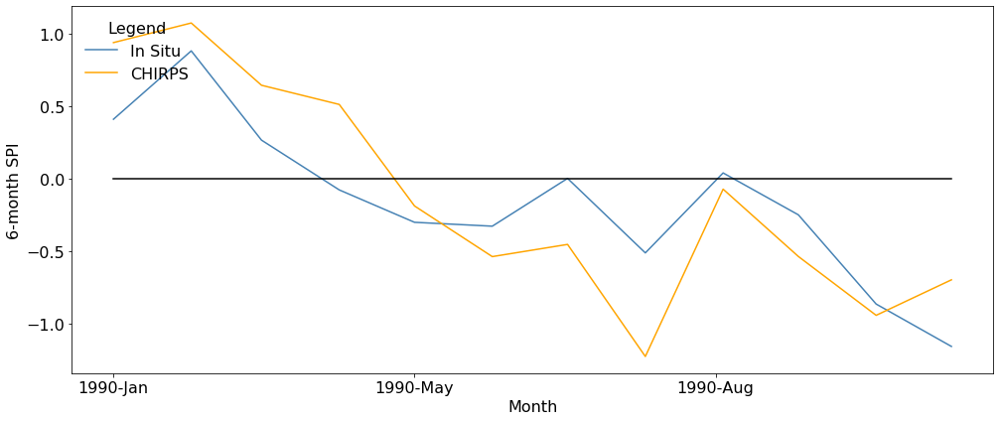

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:591: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


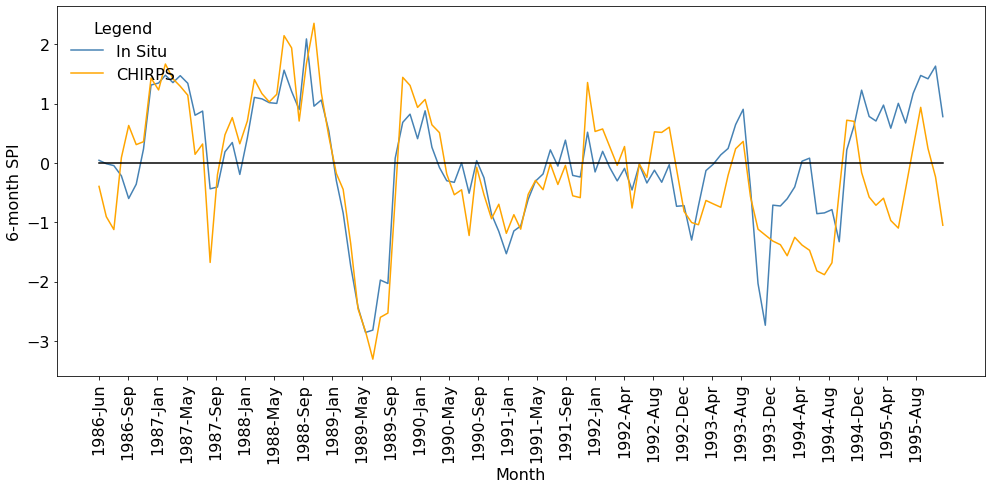

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:646: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


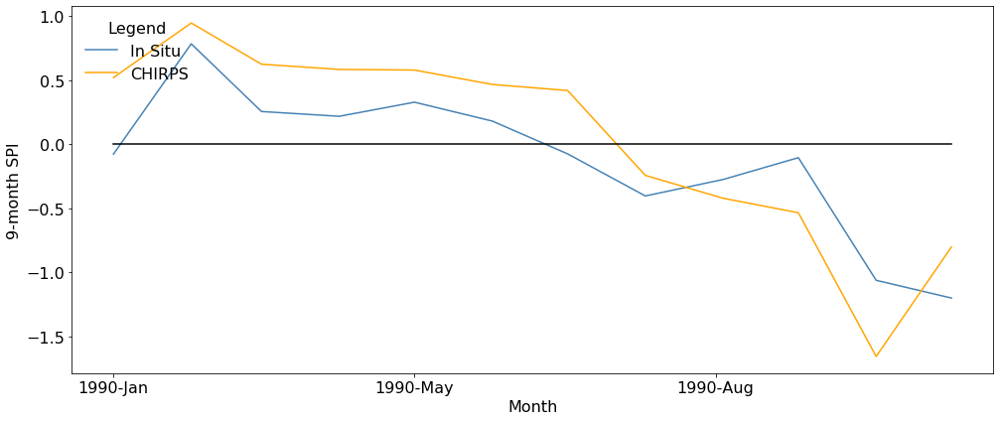

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:694: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


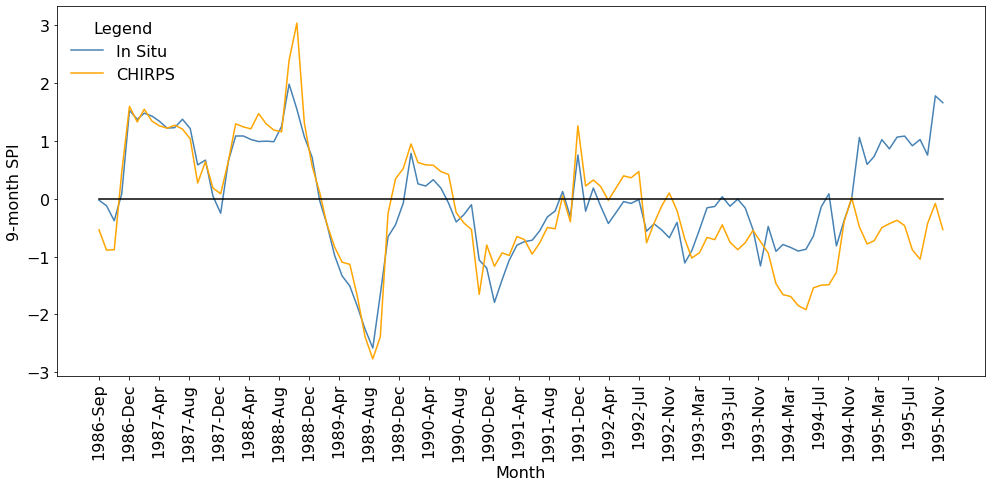

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:749: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


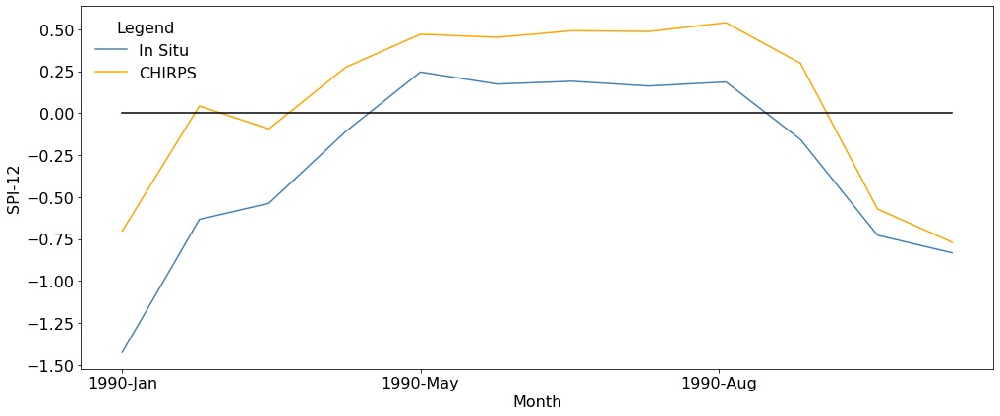

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:798: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


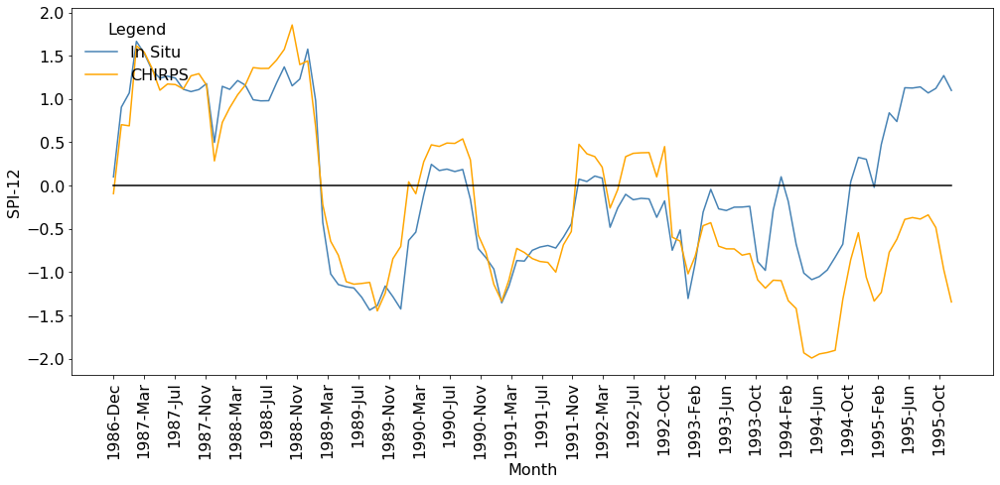

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


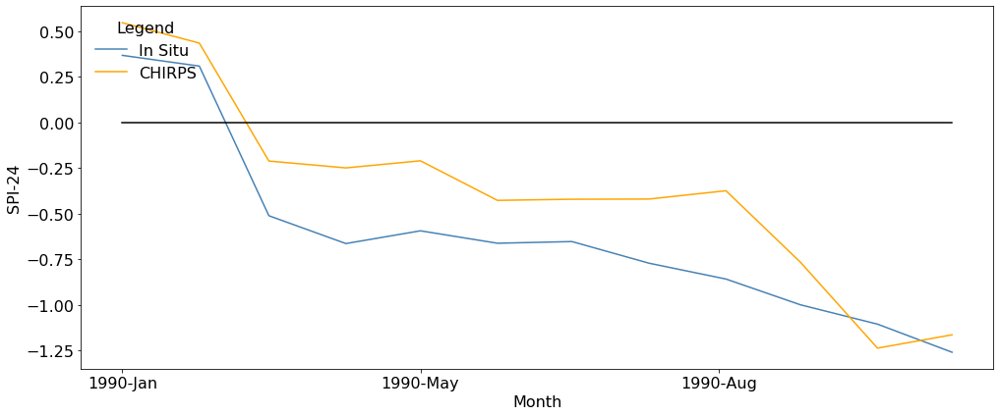

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


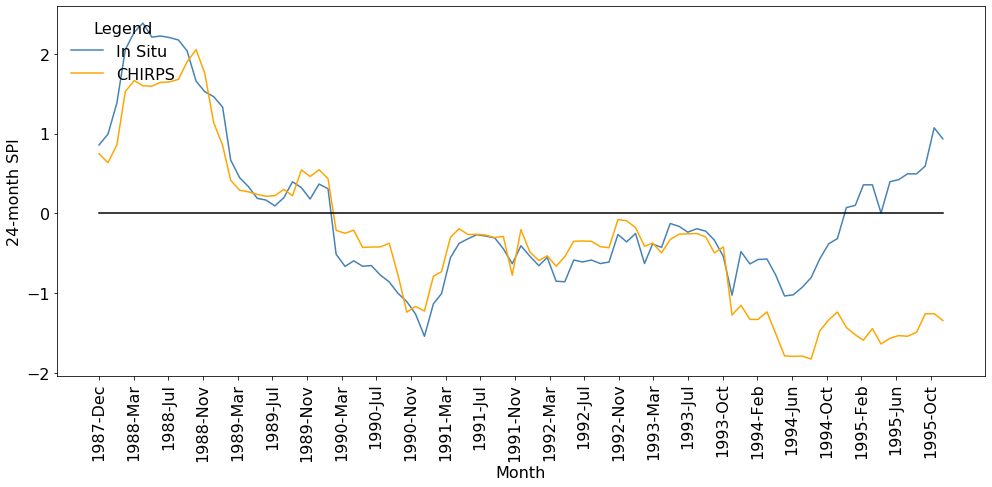

06560
done
 


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:338: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


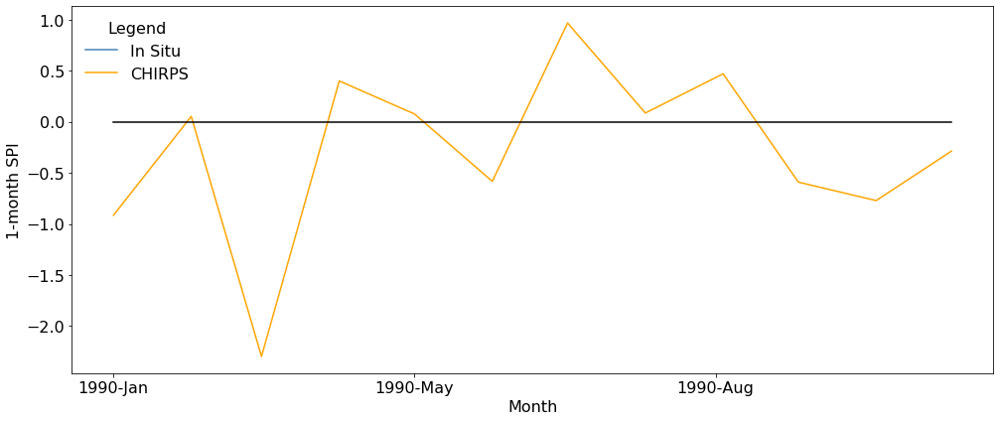

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:385: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


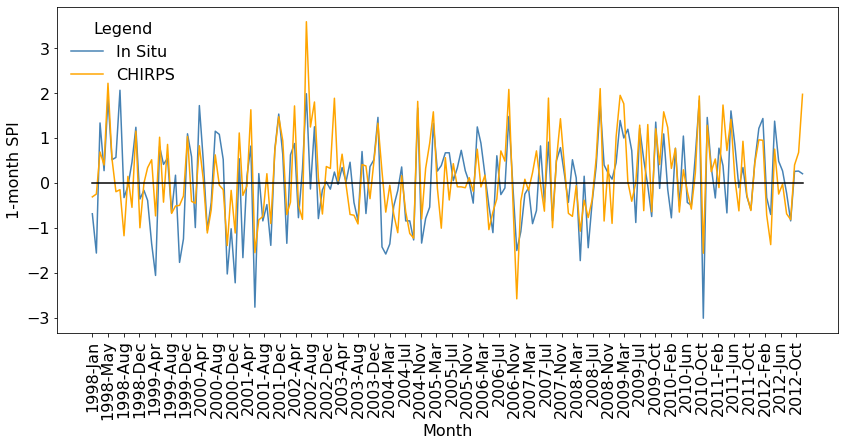

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:440: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


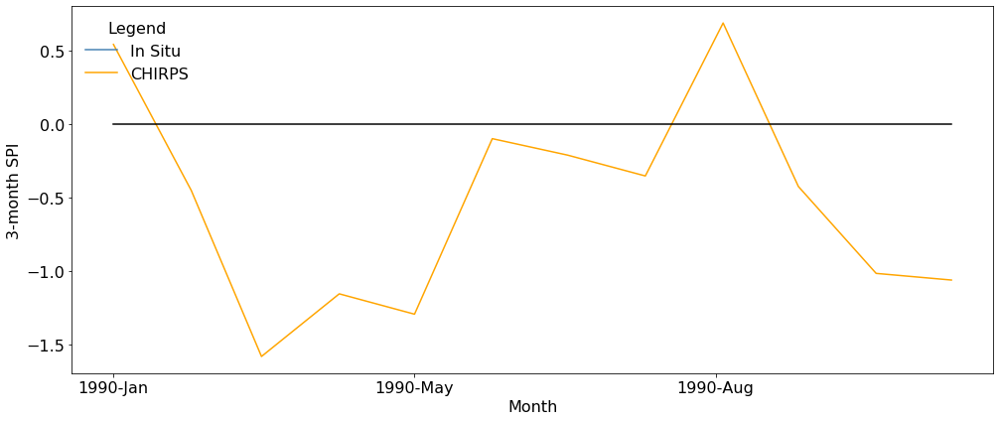

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:488: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


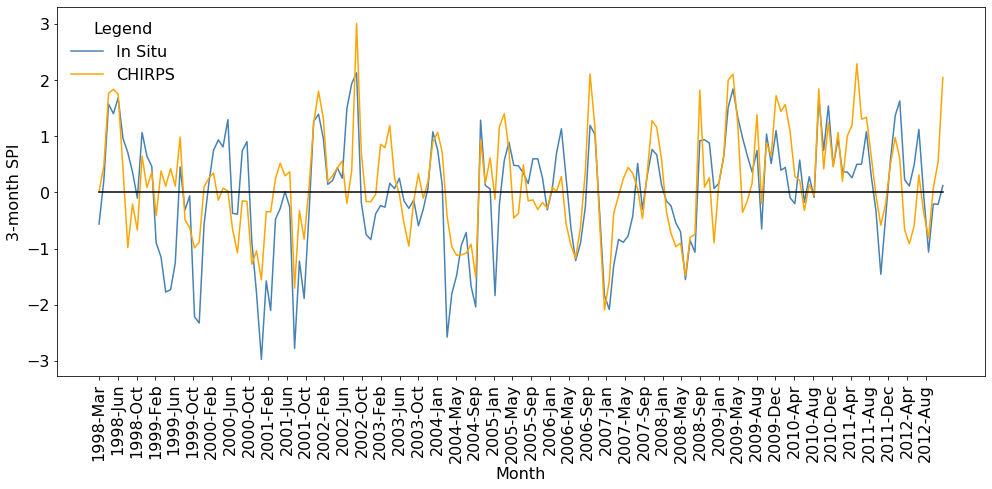

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


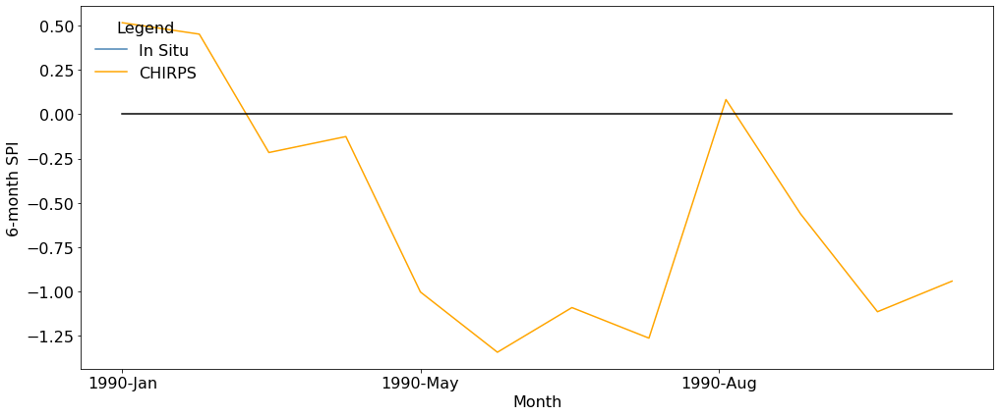

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:591: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


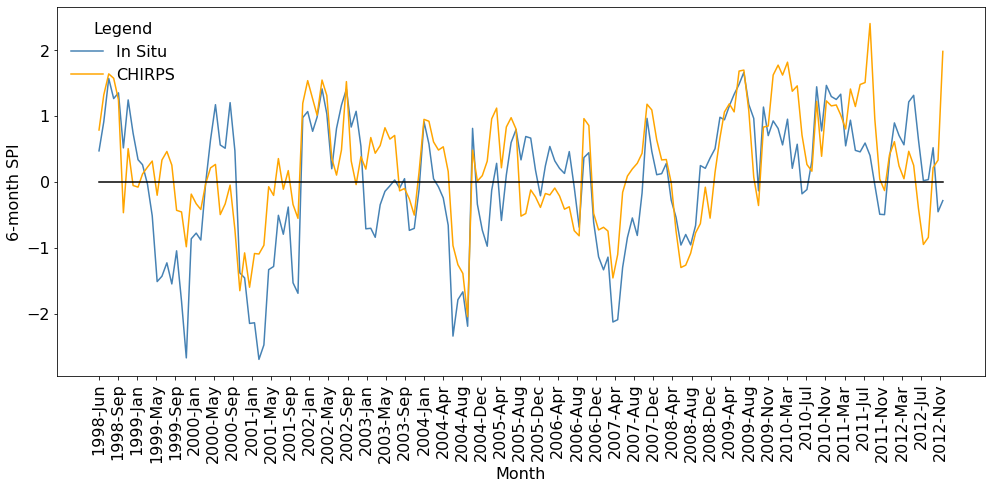

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:646: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


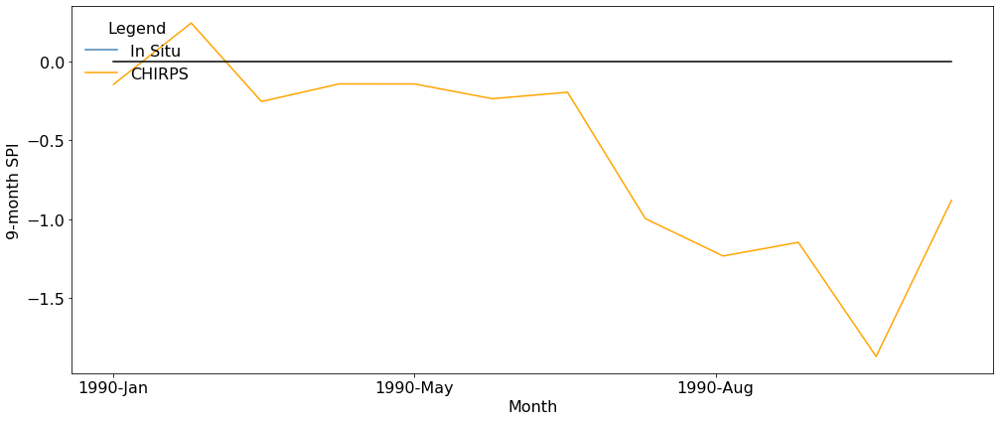

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:694: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


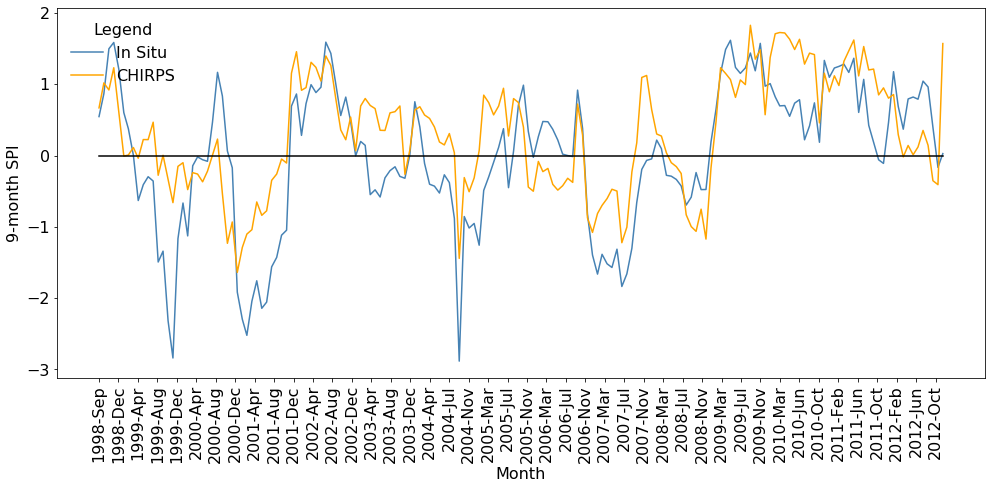

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:749: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


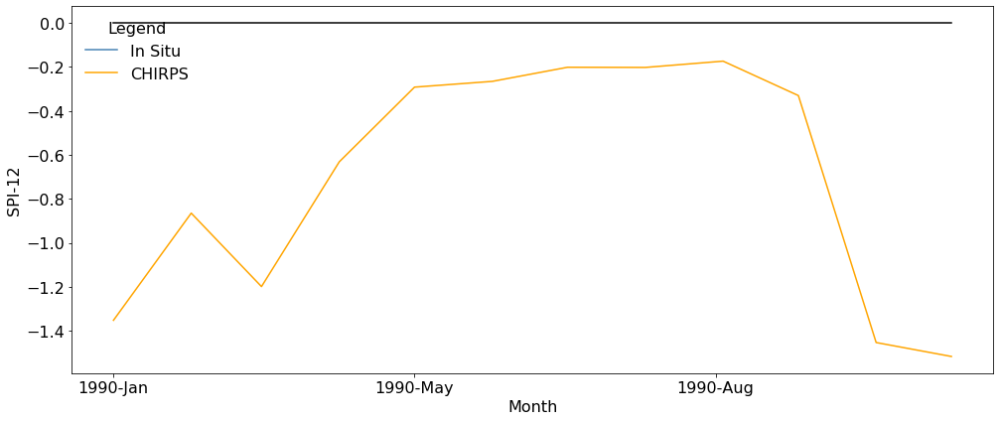

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:798: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


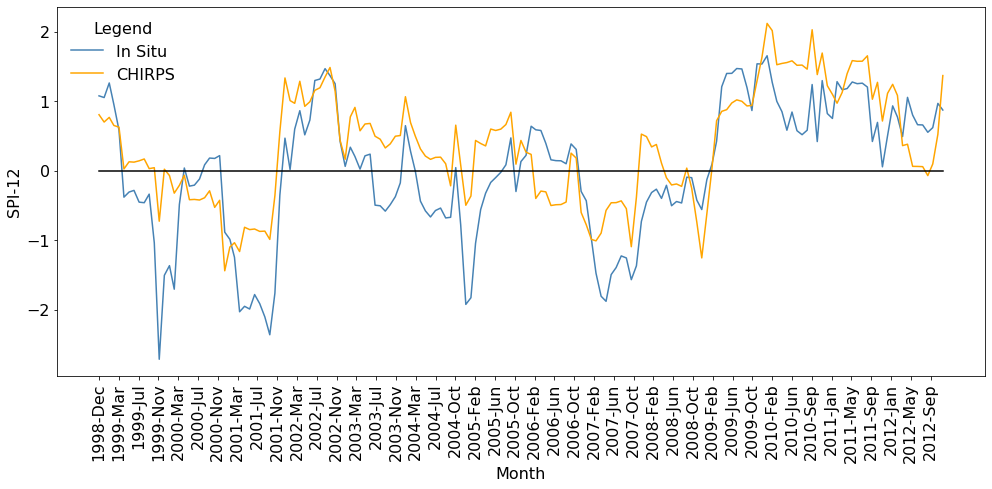

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


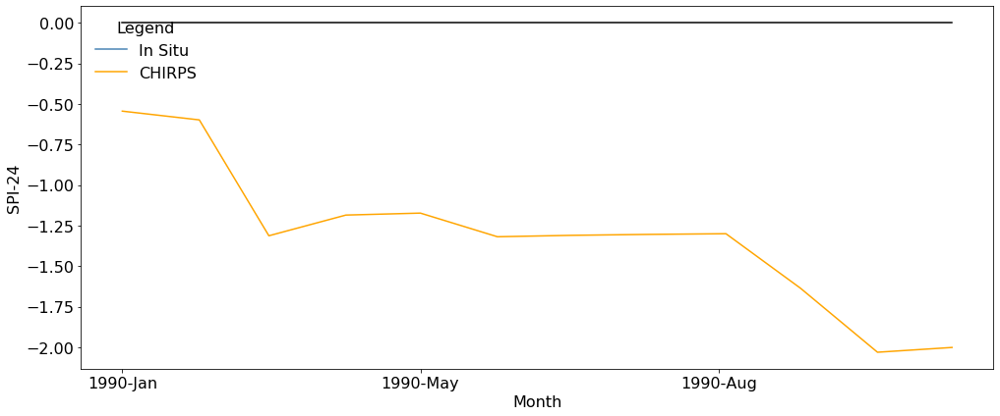

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


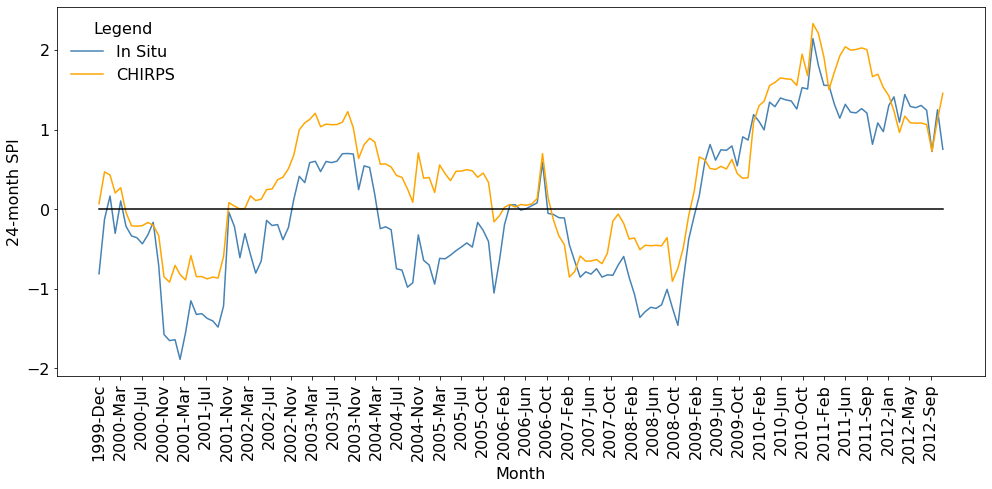

06204
done
 


,station,rmse_spi1,rmse_spi3,rmse_spi6,rmse_spi9,rmse_spi12,rmse_spi24
0,D18M019,0.769932,0.845114,0.963365,1.014130,1.091240,1.269303
1,D18M018,0.847623,0.842117,0.762075,0.749720,0.753925,0.874065
2,D18M013,0.814883,0.794370,0.807092,0.775081,0.775986,0.931048
3,D18M012,0.887009,0.891722,0.951050,0.990609,1.039546,1.185973
4,D18M011,0.822812,1.082745,0.993950,1.044931,1.077578,1.216463
5,D18M004,0.843845,0.952410,0.872131,0.881693,0.926599,1.083395
6,D18M003,0.754101,0.875715,1.007220,1.047964,1.032888,1.072630
7,17981,0.659696,1.078059,0.664516,0.634831,0.612160,0.736769
8,17936,0.730496,0.734837,0.737775,0.738787,0.738348,0.813783
9,17934,0.725944,0.691048,0.666232,0.650774,0.658252,0.613117


In [10]:
#############################
## loop to calculate the RMSE between the two series at each station, and to visualize the 
## comparison between monthly and yearly precipitation sums and the overall series 
## saves three figures and three .csv files per station, and a csv file for the overall rmse data 

# define dataframe to which information will be appended for each station 
cols = ['station', 'rmse_spi1', 'rmse_spi3', 'rmse_spi6', 'rmse_spi9', 'rmse_spi12', 'rmse_spi24']
lst = []
df = pd.DataFrame(lst, columns=cols)

for station in stationlist: 
    ## define station name 
    name = str(station)
    
    ## define paths for source files and load 
    path_chirps = 'CHIRPS_Precipitation/'+name+'.csv'
    chirps = pd.read_csv(path_chirps)
    path_insitu = 'In-Situ_Precipitation/'+name+'.csv'
    insitu = pd.read_csv(path_insitu)
    
    insitu['MONTH'] = insitu['MONTH'].apply(lambda x: '{0:0>2}'.format(x))
    insitu['yearmonth'] = insitu["YEAR"].astype(str) + '-' + insitu["MONTH"].astype(str)
    insitu = insitu.drop(columns=['YEAR', 'MONTH'])
    insitu.columns = ['insitu', 'date']
    insitu_2 = insitu
    insitu = insitu.set_index('date')
    #insitu.head()

    path_chirps = 'CHIRPS_Precipitation/'+name+'.csv'
    chirps = pd.read_csv(path_chirps)
    chirps = chirps.drop(columns=['system:index','.geo'])
    chirps['date'] = pd.to_datetime(chirps['date'])
    chirps['year'] = chirps['date'].dt.strftime('%Y')#.astype(int).astype(str) 
    chirps['month'] = chirps['date'].dt.strftime('%m')#.astype(int).astype(str) 
    chirps['date'] = chirps['date'].dt.strftime('%Y-%m')
    chirps['yearmonth'] = chirps["date"]
    chirps = chirps.groupby('yearmonth').agg({'precipitation':['sum'],'date':['first'], 'year':['first'], 'month':['first']})
    chirps.columns = ['chirps', 'date', 'year', 'month']
    #chirps.head()

    precipitation = insitu.merge(chirps, how='inner', left_index=True, right_index=True)
    
    # aggregate by year 
    years = precipitation.groupby('year').agg({'insitu':['sum'],'chirps':['sum']})
    years.columns = ['insitu', 'chirps']
    
    # aggregate by month 
    months = precipitation.groupby('month').agg({'insitu':['mean'],'chirps':['mean']})
    months.columns = ['insitu', 'chirps']
    months = months.round(1)
    

    
    ###################### SPI calculation 
    
    #########################################################################################################

    ##### load Yonca's SPI data

    spi_file_name = 'Yonca_SPI_Data/'+name+'.csv'
    yonca_SPI = pd.read_csv(spi_file_name)
    yonca_SPI["yearmonth"] = yonca_SPI["Year"].astype(str) + '-' + yonca_SPI["Month"].astype(str)
    replace_value = yonca_SPI['SPI24'].iloc[0]
    yonca_SPI = yonca_SPI.replace(replace_value,np.nan)
    yonca_SPI.head()
    #print(replace_value)


    #########################################################################################################

    ####### calculate SPI from CHIRPS 


    rainfall_data = chirps.sort_values('date') 

    spi = SPI()

    #### 1-month 

    df_spi_1 = spi.calculate(
        rainfall_data, 
        'date', 
        'chirps', 
        freq="M", 
        scale=1, 
        fit_type="lmom", 
        dist_type="gam"
    )

    df_spi_1 = df_spi_1.drop(columns=['chirps'])
    df_spi_1 = df_spi_1.set_index('date')
    df_spi_1.columns = ['SPI1_C']
    #df_spi_1.head()


    #### 3-month

    df_spi_3 = spi.calculate(
        rainfall_data, 
        'date', 
        'chirps', 
        freq="M", 
        scale=3, 
        fit_type="lmom", 
        dist_type="gam"
    )

    df_spi_3 = df_spi_3.drop(columns=['chirps_scale_3'])
    df_spi_3 = df_spi_3.set_index('date')
    df_spi_3.columns = ['SPI3_C']
    #df_spi_3.head()

    ### 6-months 

    df_spi_6 = spi.calculate(
        rainfall_data, 
        'date', 
        'chirps', 
        freq="M", 
        scale=6, 
        fit_type="lmom", 
        dist_type="gam"
    )

    df_spi_6 = df_spi_6.drop(columns=['chirps_scale_6'])
    df_spi_6 = df_spi_6.set_index('date')
    df_spi_6.columns = ['SPI6_C']
    #df_spi_6.head(10)

    #### 9-month 

    df_spi_9 = spi.calculate(
        rainfall_data, 
        'date', 
        'chirps', 
        freq="M", 
        scale=9, 
        fit_type="lmom", 
        dist_type="gam"
    )

    df_spi_9 = df_spi_9.drop(columns=['chirps_scale_9'])
    df_spi_9 = df_spi_9.set_index('date')
    df_spi_9.columns = ['SPI9_C']
    #df_spi_9.head(10)

    ##### 12-month 

    df_spi_12 = spi.calculate(
        rainfall_data, 
        'date', 
        'chirps', 
        freq="M", 
        scale=12, 
        fit_type="lmom", 
        dist_type="gam"
    )

    df_spi_12 = df_spi_12.drop(columns=['chirps_scale_12'])
    df_spi_12 = df_spi_12.set_index('date')
    df_spi_12.columns = ['SPI12_C']
    #df_spi_12.head(10)

    #### 24-month

    df_spi_24 = spi.calculate(
        rainfall_data, 
        'date', 
        'chirps', 
        freq="M", 
        scale=24, 
        fit_type="lmom", 
        dist_type="gam"
    )

    df_spi_24 = df_spi_24.drop(columns=['chirps_scale_24'])
    df_spi_24 = df_spi_24.set_index('date')
    df_spi_24.columns = ['SPI24_C']
    #df_spi_24.head(10)

    spi_indices = df_spi_1.merge(df_spi_3, how='inner', left_index=True, right_index=True).merge(df_spi_6, how='inner', left_index=True, right_index=True).merge(df_spi_9, how='inner', left_index=True, right_index=True).merge(df_spi_12, how='inner', left_index=True, right_index=True).merge(df_spi_24, how='inner', left_index=True, right_index=True)
    spi_indices.head()

    #########################################################################################################

    ### merge the two dataframes 

    #spi_indices['date'] = spi_indices.index

        #########################################################################################################

    ####### calculate SPI from insitu 

    rainfall_data = insitu_2

    spi = SPI()

    #### 1-month 

    df_spi_1 = spi.calculate(
        rainfall_data, 
        'date', 
        'insitu', 
        freq="M", 
        scale=1, 
        fit_type="lmom", 
        dist_type="gam"
    )

    df_spi_1 = df_spi_1.drop(columns=['insitu'])
    df_spi_1 = df_spi_1.set_index('date')
    df_spi_1.columns = ['SPI1']
    #df_spi_1.head()


    #### 3-month

    df_spi_3 = spi.calculate(
        rainfall_data, 
        'date', 
        'insitu', 
        freq="M", 
        scale=3, 
        fit_type="lmom", 
        dist_type="gam"
    )

    df_spi_3 = df_spi_3.drop(columns=['insitu_scale_3'])
    df_spi_3 = df_spi_3.set_index('date')
    df_spi_3.columns = ['SPI3']
    #df_spi_3.head()

    ### 6-months 

    df_spi_6 = spi.calculate(
        rainfall_data, 
        'date', 
        'insitu', 
        freq="M", 
        scale=6, 
        fit_type="lmom", 
        dist_type="gam"
    )

    df_spi_6 = df_spi_6.drop(columns=['insitu_scale_6'])
    df_spi_6 = df_spi_6.set_index('date')
    df_spi_6.columns = ['SPI6']
    #df_spi_6.head(10)

    #### 9-month 

    df_spi_9 = spi.calculate(
        rainfall_data, 
        'date', 
        'insitu', 
        freq="M", 
        scale=9, 
        fit_type="lmom", 
        dist_type="gam"
    )

    df_spi_9 = df_spi_9.drop(columns=['insitu_scale_9'])
    df_spi_9 = df_spi_9.set_index('date')
    df_spi_9.columns = ['SPI9']
    #df_spi_9.head(10)

    ##### 12-month 

    df_spi_12 = spi.calculate(
        rainfall_data, 
        'date', 
        'insitu', 
        freq="M", 
        scale=12, 
        fit_type="lmom", 
        dist_type="gam"
    )

    df_spi_12 = df_spi_12.drop(columns=['insitu_scale_12'])
    df_spi_12 = df_spi_12.set_index('date')
    df_spi_12.columns = ['SPI12']
    #df_spi_12.head(10)

    #### 24-month

    df_spi_24 = spi.calculate(
        rainfall_data, 
        'date', 
        'insitu', 
        freq="M", 
        scale=24, 
        fit_type="lmom", 
        dist_type="gam"
    )

    df_spi_24 = df_spi_24.drop(columns=['insitu_scale_24'])
    df_spi_24 = df_spi_24.set_index('date')
    df_spi_24.columns = ['SPI24']
    #df_spi_24.head(10)

    spi_indices_yonca = df_spi_1.merge(df_spi_3, how='inner', left_index=True, right_index=True).merge(df_spi_6, how='inner', left_index=True, right_index=True).merge(df_spi_9, how='inner', left_index=True, right_index=True).merge(df_spi_12, how='inner', left_index=True, right_index=True).merge(df_spi_24, how='inner', left_index=True, right_index=True)
    #spi_indices_yonca =spi_indices_yonca.set_index('date')

    spi_all = spi_indices.merge(spi_indices_yonca, how='outer', right_index=True, left_index=True)
    #spi_all = spi_all.set_index('date')
    #spi_all = spi_all.sort_index()
    spi_all.head()
    ### save the complete file 
    spi_all_filename = figname = '/Users/vindobonensis/Documents/PhD/Yonca/spi_comparison/SPI1/'+name+'.csv'
    spi_all.to_csv(spi_all_filename)

    #### isolate index pairs for RMSE calculation and graphics 

    spi_all_1 = spi_all.drop(columns=['SPI3', 'SPI3_C', 'SPI6', 'SPI6_C', 'SPI9', 'SPI9_C', 'SPI12', 'SPI12_C', 'SPI24', 'SPI24_C'])#.dropna()
    spi_all_3 = spi_all.drop(columns=['SPI1', 'SPI1_C', 'SPI6', 'SPI6_C', 'SPI9', 'SPI9_C', 'SPI12', 'SPI12_C', 'SPI24', 'SPI24_C'])#.dropna()
    spi_all_6 = spi_all.drop(columns=['SPI3', 'SPI3_C', 'SPI1', 'SPI1_C', 'SPI9', 'SPI9_C', 'SPI12', 'SPI12_C', 'SPI24', 'SPI24_C'])#.dropna()
    spi_all_9 = spi_all.drop(columns=['SPI3', 'SPI3_C', 'SPI6', 'SPI6_C', 'SPI1', 'SPI1_C', 'SPI12', 'SPI12_C', 'SPI24', 'SPI24_C'])#.dropna()
    spi_all_12 = spi_all.drop(columns=['SPI3', 'SPI3_C', 'SPI6', 'SPI6_C', 'SPI9', 'SPI9_C', 'SPI1', 'SPI1_C', 'SPI24', 'SPI24_C'])#.dropna()
    spi_all_24 = spi_all.drop(columns=['SPI3', 'SPI3_C', 'SPI6', 'SPI6_C', 'SPI9', 'SPI9_C', 'SPI12', 'SPI12_C', 'SPI1', 'SPI1_C'])#.dropna()


    #########################################################################################################
    ### plots 
    #########################################################################################################

    #### SPI1 

    ### plot the difference in 1990 

    # plot and save graph: comparison of one-month SPI 

    # Initialise the figure and axes.
    fig, ax = plt.subplots(1, figsize=(14, 6))
    plt.tight_layout()

    spi_all_1_90s = spi_all_1[(spi_all_1.index>'1989-12')&(spi_all_1.index<'1991-01')]

    spi_all_1_90s['baseline'] = 0

    # define axes 
    y1 = spi_all_1_90s['SPI1']
    y2 = spi_all_1_90s['SPI1_C']
    y3 = spi_all_1_90s['baseline']

    x = date2num(pd.to_datetime(spi_all_1_90s.index))

    ax.plot(x, y1, color="steelblue", label="In Situ")
    ax.plot(x, y2, color="orange", label="CHIRPS")
    ax.plot(x, y3, color='black')

    plt.legend(loc="upper left", title="Legend", frameon=False)

    plt.xlabel("Month")
    plt.ylabel("1-month SPI")

    axes = plt.gca()
    #axes.set_xlim(["2020-09-30","2020-11-02"])
    #axes.set_ylim([-2,600]) 
    #axes.get_yaxis().set_visible(False)
    ax.xaxis_date()

    myFmt = mdates.DateFormatter('%Y-%b')

    ax.xaxis.set_major_formatter(myFmt)

    #plt.xticks(rotation = 90)

    plt.xticks(np.arange(min(x), max(x)+1, 120.0))

    plt.show()

    figname = 'spi_comparison/SPI1/90s'+name+'.png'

    fig.savefig(figname, dpi=100,  bbox_inches = "tight")

    ### plot the difference over the entire period for which both datasets are available and calculate rmse

    # plot and save graph: comparison of one-month SPI 

    # Initialise the figure and axes.
    fig, ax = plt.subplots(1, figsize=(14, 6))

    spi_all_1_full = spi_all_1.dropna()

    spi_all_1_full['baseline'] = 0

    # define axes 
    y1 = spi_all_1_full['SPI1']
    y2 = spi_all_1_full['SPI1_C']
    y3 = spi_all_1_full['baseline']

    x = date2num(pd.to_datetime(spi_all_1_full.index))

    ax.plot(x, y1, color="steelblue", label="In Situ")
    ax.plot(x, y2, color="orange", label="CHIRPS")
    ax.plot(x, y3, color='black')

    plt.legend(loc="upper left", title="Legend", frameon=False)

    plt.xlabel("Month")
    plt.ylabel("1-month SPI")

    axes = plt.gca()
    #axes.set_xlim(["2020-09-30","2020-11-02"])
    #axes.set_ylim([-2,600]) 
    #axes.get_yaxis().set_visible(False)
    ax.xaxis_date()

    myFmt = mdates.DateFormatter('%Y-%b')

    ax.xaxis.set_major_formatter(myFmt)

    plt.xticks(rotation = 90)

    plt.xticks(np.arange(min(x), max(x)+1, 120.0))

    plt.show()

    figname = '/Users/vindobonensis/Documents/PhD/Yonca/spi_comparison/SPI1/all_available'+name+'.png'

    fig.savefig(figname, dpi=100,  bbox_inches = "tight")

    mse_spi1 = sklearn.metrics.mean_squared_error(spi_all_1_full['SPI1'], spi_all_1_full['SPI1_C'])

    rmse_spi1 = math.sqrt(mse_spi1)

    #########################################################################################################
    #### SPI 3 

    ### plot the difference in 1990 

    # plot and save graph: comparison of one-month SPI 

    # Initialise the figure and axes.
    fig, ax = plt.subplots(1, figsize=(14, 6))
    plt.tight_layout()

    spi_all_3_90s = spi_all_3[(spi_all_3.index>'1989-12')&(spi_all_3.index<'1991-01')]

    spi_all_3_90s['baseline'] = 0

    # define axes 
    y1 = spi_all_3_90s['SPI3']
    y2 = spi_all_3_90s['SPI3_C']
    y3 = spi_all_3_90s['baseline']

    x = date2num(pd.to_datetime(spi_all_3_90s.index))

    ax.plot(x, y1, color="steelblue", label="In Situ")
    ax.plot(x, y2, color="orange", label="CHIRPS")
    ax.plot(x, y3, color='black')

    plt.legend(loc="upper left", title="Legend", frameon=False)

    plt.xlabel("Month")
    plt.ylabel("3-month SPI")

    axes = plt.gca()
    #axes.set_xlim(["2020-09-30","2020-11-02"])
    #axes.set_ylim([-2,600]) 
    #axes.get_yaxis().set_visible(False)
    ax.xaxis_date()

    myFmt = mdates.DateFormatter('%Y-%b')

    ax.xaxis.set_major_formatter(myFmt)

    #plt.xticks(rotation = 90)

    plt.xticks(np.arange(min(x), max(x)+1, 120.0))

    plt.show()

    figname = 'spi_comparison/SPI3/90s'+name+'.png'

    fig.savefig(figname, dpi=100,  bbox_inches = "tight")

    ### plot the difference over the entire period for which both datasets are available and calculate rmse

    # plot and save graph: comparison of one-month SPI 

    # Initialise the figure and axes.
    fig, ax = plt.subplots(1, figsize=(14, 6))
    plt.tight_layout()

    spi_all_3_full = spi_all_3.dropna()

    spi_all_3_full['baseline'] = 0

    # define axes 
    y1 = spi_all_3_full['SPI3']
    y2 = spi_all_3_full['SPI3_C']
    y3 = spi_all_3_full['baseline']

    x = date2num(pd.to_datetime(spi_all_3_full.index))

    ax.plot(x, y1, color="steelblue", label="In Situ")
    ax.plot(x, y2, color="orange", label="CHIRPS")
    ax.plot(x, y3, color='black')

    plt.legend(loc="upper left", title="Legend", frameon=False)

    plt.xlabel("Month")
    plt.ylabel("3-month SPI")

    axes = plt.gca()
    #axes.set_xlim(["2020-09-30","2020-11-02"])
    #axes.set_ylim([-2,600]) 
    #axes.get_yaxis().set_visible(False)
    ax.xaxis_date()

    myFmt = mdates.DateFormatter('%Y-%b')

    ax.xaxis.set_major_formatter(myFmt)

    plt.xticks(rotation = 90)

    plt.xticks(np.arange(min(x), max(x)+1, 120.0))

    plt.show()

    figname = 'SPI3/all_available'+name+'.png'

    fig.savefig(figname, dpi=100,  bbox_inches = "tight")

    mse_spi3 = sklearn.metrics.mean_squared_error(spi_all_3_full['SPI3'], spi_all_3_full['SPI3_C'])

    rmse_spi3 = math.sqrt(mse_spi3)

    #########################################################################################################
    #### SPI 6

    ### plot the difference in 1990 

    # plot and save graph: comparison of one-month SPI 

    # Initialise the figure and axes.
    fig, ax = plt.subplots(1, figsize=(14, 6))
    plt.tight_layout()

    spi_all_6_90s = spi_all_6[(spi_all_6.index>'1989-12')&(spi_all_6.index<'1991-01')]

    spi_all_6_90s['baseline'] = 0

    # define axes 
    y1 = spi_all_6_90s['SPI6']
    y2 = spi_all_6_90s['SPI6_C']
    y3 = spi_all_6_90s['baseline']

    x = date2num(pd.to_datetime(spi_all_6_90s.index))

    ax.plot(x, y1, color="steelblue", label="In Situ")
    ax.plot(x, y2, color="orange", label="CHIRPS")
    ax.plot(x, y3, color='black')

    plt.legend(loc="upper left", title="Legend", frameon=False)

    plt.xlabel("Month")
    plt.ylabel("6-month SPI")

    axes = plt.gca()
    #axes.set_xlim(["2020-09-30","2020-11-02"])
    #axes.set_ylim([-2,600]) 
    #axes.get_yaxis().set_visible(False)
    ax.xaxis_date()

    myFmt = mdates.DateFormatter('%Y-%b')

    ax.xaxis.set_major_formatter(myFmt)

    #plt.xticks(rotation = 90)

    plt.xticks(np.arange(min(x), max(x)+1, 120.0))

    plt.show()

    figname = 'spi_comparison/SPI6/90s'+name+'.png'

    fig.savefig(figname, dpi=100,  bbox_inches = "tight")

    ### plot the difference over the entire period for which both datasets are available and calculate rmse

    # plot and save graph: comparison of one-month SPI 

    # Initialise the figure and axes.
    fig, ax = plt.subplots(1, figsize=(14, 6))
    plt.tight_layout()

    spi_all_6_full = spi_all_6.dropna()

    spi_all_6_full['baseline'] = 0

    # define axes 
    y1 = spi_all_6_full['SPI6']
    y2 = spi_all_6_full['SPI6_C']
    y3 = spi_all_6_full['baseline']

    x = date2num(pd.to_datetime(spi_all_6_full.index))

    ax.plot(x, y1, color="steelblue", label="In Situ")
    ax.plot(x, y2, color="orange", label="CHIRPS")
    ax.plot(x, y3, color='black')

    plt.legend(loc="upper left", title="Legend", frameon=False)

    plt.xlabel("Month")
    plt.ylabel("6-month SPI")

    axes = plt.gca()
    #axes.set_xlim(["2020-09-30","2020-11-02"])
    #axes.set_ylim([-2,600]) 
    #axes.get_yaxis().set_visible(False)
    ax.xaxis_date()

    myFmt = mdates.DateFormatter('%Y-%b')

    ax.xaxis.set_major_formatter(myFmt)

    plt.xticks(rotation = 90)

    plt.xticks(np.arange(min(x), max(x)+1, 120.0))

    plt.show()

    figname = 'spi_comparison/SPI6/all_available'+name+'.png'

    fig.savefig(figname, dpi=100,  bbox_inches = "tight")

    mse_spi6 = sklearn.metrics.mean_squared_error(spi_all_6_full['SPI6'], spi_all_6_full['SPI6_C'])

    rmse_spi6 = math.sqrt(mse_spi6)

    #########################################################################################################
    #### SPI 9

    ### plot the difference in 1990 

    # plot and save graph: comparison of one-month SPI 

    # Initialise the figure and axes.
    fig, ax = plt.subplots(1, figsize=(14, 6))
    plt.tight_layout()

    spi_all_9_90s = spi_all_9[(spi_all_9.index>'1989-12')&(spi_all_9.index<'1991-01')]

    spi_all_9_90s['baseline'] = 0

    # define axes 
    y1 = spi_all_9_90s['SPI9']
    y2 = spi_all_9_90s['SPI9_C']
    y3 = spi_all_9_90s['baseline']

    x = date2num(pd.to_datetime(spi_all_9_90s.index))

    ax.plot(x, y1, color="steelblue", label="In Situ")
    ax.plot(x, y2, color="orange", label="CHIRPS")
    ax.plot(x, y3, color='black')

    plt.legend(loc="upper left", title="Legend", frameon=False)

    plt.xlabel("Month")
    plt.ylabel("9-month SPI")

    axes = plt.gca()
    #axes.set_xlim(["2020-09-30","2020-11-02"])
    #axes.set_ylim([-2,900]) 
    #axes.get_yaxis().set_visible(False)
    ax.xaxis_date()

    myFmt = mdates.DateFormatter('%Y-%b')

    ax.xaxis.set_major_formatter(myFmt)

    #plt.xticks(rotation = 90)

    plt.xticks(np.arange(min(x), max(x)+1, 120.0))

    plt.show()

    figname = 'spi_comparison/SPI9/90s'+name+'.png'

    fig.savefig(figname, dpi=100,  bbox_inches = "tight")

    ### plot the difference over the entire period for which both datasets are available and calculate rmse

    # plot and save graph: comparison of one-month SPI 

    # Initialise the figure and axes.
    fig, ax = plt.subplots(1, figsize=(14, 6))
    plt.tight_layout()

    spi_all_9_full = spi_all_9.dropna()

    spi_all_9_full['baseline'] = 0

    # define axes 
    y1 = spi_all_9_full['SPI9']
    y2 = spi_all_9_full['SPI9_C']
    y3 = spi_all_9_full['baseline']

    x = date2num(pd.to_datetime(spi_all_9_full.index))

    ax.plot(x, y1, color="steelblue", label="In Situ")
    ax.plot(x, y2, color="orange", label="CHIRPS")
    ax.plot(x, y3, color='black')

    plt.legend(loc="upper left", title="Legend", frameon=False)

    plt.xlabel("Month")
    plt.ylabel("9-month SPI")

    axes = plt.gca()
    #axes.set_xlim(["2020-09-30","2020-11-02"])
    #axes.set_ylim([-2,900]) 
    #axes.get_yaxis().set_visible(False)
    ax.xaxis_date()

    myFmt = mdates.DateFormatter('%Y-%b')

    ax.xaxis.set_major_formatter(myFmt)

    plt.xticks(rotation = 90)

    plt.xticks(np.arange(min(x), max(x)+1, 120.0))

    plt.show()

    figname = 'spi_comparison/SPI9/all_available'+name+'.png'

    fig.savefig(figname, dpi=100,  bbox_inches = "tight")

    mse_spi9 = sklearn.metrics.mean_squared_error(spi_all_9_full['SPI9'], spi_all_9_full['SPI9_C'])

    rmse_spi9 = math.sqrt(mse_spi9)

    #########################################################################################################
    #### SPI 12

    ### plot the difference in 1990 

    # plot and save graph: comparison of one-month SPI 

    # Initialise the figure and axes.
    fig, ax = plt.subplots(1, figsize=(14, 6))
    plt.tight_layout()

    spi_all_12_90s = spi_all_12[(spi_all_12.index>'1989-12')&(spi_all_12.index<'1991-01')]

    spi_all_12_90s['baseline'] = 0

    # define axes 
    y1 = spi_all_12_90s['SPI12']
    y2 = spi_all_12_90s['SPI12_C']
    y3 = spi_all_12_90s['baseline']

    x = date2num(pd.to_datetime(spi_all_12_90s.index))

    ax.plot(x, y1, color="steelblue", label="In Situ")
    ax.plot(x, y2, color="orange", label="CHIRPS")
    ax.plot(x, y3, color='black')

    plt.legend(loc="upper left", title="Legend", frameon=False)

    plt.xlabel("Month")
    plt.ylabel("SPI-12")

    axes = plt.gca()
    #axes.set_xlim(["2020-09-30","2020-11-02"])
    #axes.set_ylim([-2,1200]) 
    #axes.get_yaxis().set_visible(False)
    ax.xaxis_date()

    myFmt = mdates.DateFormatter('%Y-%b')

    ax.xaxis.set_major_formatter(myFmt)

    #plt.xticks(rotation = 90)

    plt.xticks(np.arange(min(x), max(x)+1, 120.0))

    plt.show()

    figname = 'spi_comparison/SPI12/90s'+name+'.png'

    fig.savefig(figname, dpi=100,  bbox_inches = "tight")

    ### plot the difference over the entire period for which both datasets are available and calculate rmse

    # plot and save graph: comparison of one-month SPI 

    # Initialise the figure and axes.
    fig, ax = plt.subplots(1, figsize=(14, 6))
    
    plt.tight_layout()

    spi_all_12_full = spi_all_12.dropna()

    spi_all_12_full['baseline'] = 0

    # define axes 
    y1 = spi_all_12_full['SPI12']
    y2 = spi_all_12_full['SPI12_C']
    y3 = spi_all_12_full['baseline']

    x = date2num(pd.to_datetime(spi_all_12_full.index))

    ax.plot(x, y1, color="steelblue", label="In Situ")
    ax.plot(x, y2, color="orange", label="CHIRPS")
    ax.plot(x, y3, color='black')

    plt.legend(loc="upper left", title="Legend", frameon=False)

    plt.xlabel("Month")
    plt.ylabel("SPI-12")

    axes = plt.gca()
    #axes.set_xlim(["2020-09-30","2020-11-02"])
    #axes.set_ylim([-2,1200]) 
    #axes.get_yaxis().set_visible(False)
    ax.xaxis_date()

    myFmt = mdates.DateFormatter('%Y-%b')

    ax.xaxis.set_major_formatter(myFmt)

    plt.xticks(rotation = 90)

    plt.xticks(np.arange(min(x), max(x)+1, 120.0))

    plt.show()

    figname = 'spi_comparison/SPI12/all_available'+name+'.png'

    fig.savefig(figname, dpi=100,  bbox_inches = "tight")

    mse_spi12 = sklearn.metrics.mean_squared_error(spi_all_12_full['SPI12'], spi_all_12_full['SPI12_C'])

    rmse_spi12 = math.sqrt(mse_spi12)

    #########################################################################################################
    #### SPI 24

    ### plot the difference in 1990 

    # plot and save graph: comparison of one-month SPI 

    # Initialise the figure and axes.
    fig, ax = plt.subplots(1, figsize=(14, 6))
    plt.tight_layout()

    spi_all_24_90s = spi_all_24[(spi_all_24.index>'1989-12')&(spi_all_24.index<'1991-01')]

    spi_all_24_90s['baseline'] = 0

    # define axes 
    y1 = spi_all_24_90s['SPI24']
    y2 = spi_all_24_90s['SPI24_C']
    y3 = spi_all_24_90s['baseline']

    x = date2num(pd.to_datetime(spi_all_24_90s.index))

    ax.plot(x, y1, color="steelblue", label="In Situ")
    ax.plot(x, y2, color="orange", label="CHIRPS")
    ax.plot(x, y3, color='black')

    plt.legend(loc="upper left", title="Legend", frameon=False)

    plt.xlabel("Month")
    plt.ylabel("SPI-24")

    axes = plt.gca()
    #axes.set_xlim(["2020-09-30","2020-11-02"])
    #axes.set_ylim([-2,2400]) 
    #axes.get_yaxis().set_visible(False)
    ax.xaxis_date()

    myFmt = mdates.DateFormatter('%Y-%b')

    ax.xaxis.set_major_formatter(myFmt)

    #plt.xticks(rotation = 90)

    plt.xticks(np.arange(min(x), max(x)+1, 120.0))

    plt.show()

    figname = 'spi_comparison/SPI24/90s'+name+'.png'

    fig.savefig(figname, dpi=100,  bbox_inches = "tight")

    ### plot the difference over the entire period for which both datasets are available and calculate rmse

    # plot and save graph: comparison of one-month SPI 

    # Initialise the figure and axes.
    fig, ax = plt.subplots(1, figsize=(14, 6))
    plt.tight_layout()

    spi_all_24_full = spi_all_24.dropna()

    spi_all_24_full['baseline'] = 0

    # define axes 
    y1 = spi_all_24_full['SPI24']
    y2 = spi_all_24_full['SPI24_C']
    y3 = spi_all_24_full['baseline']

    x = date2num(pd.to_datetime(spi_all_24_full.index))

    ax.plot(x, y1, color="steelblue", label="In Situ")
    ax.plot(x, y2, color="orange", label="CHIRPS")
    ax.plot(x, y3, color='black')

    plt.legend(loc="upper left", title="Legend", frameon=False)

    plt.xlabel("Month")
    plt.ylabel("24-month SPI")

    axes = plt.gca()
    #axes.set_xlim(["2020-09-30","2020-11-02"])
    #axes.set_ylim([-2,2400]) 
    #axes.get_yaxis().set_visible(False)
    ax.xaxis_date()

    myFmt = mdates.DateFormatter('%Y-%b')

    ax.xaxis.set_major_formatter(myFmt)

    plt.xticks(rotation = 90)

    plt.xticks(np.arange(min(x), max(x)+1, 120.0))

    plt.show()

    figname = 'spi_comparison/SPI24/all_available'+name+'.png'

    fig.savefig(figname, dpi=100,  bbox_inches = "tight")

    mse_spi24 = sklearn.metrics.mean_squared_error(spi_all_24_full['SPI24'], spi_all_24_full['SPI24_C'])

    rmse_spi24 = math.sqrt(mse_spi24)

    
    
    # print done 
    
    df = df.append(pd.DataFrame({'station': name, 'rmse_spi1': rmse_spi1, 'rmse_spi3': rmse_spi3, 'rmse_spi6': rmse_spi6, 'rmse_spi9': rmse_spi9, 'rmse_spi12': rmse_spi12, 'rmse_spi24': rmse_spi24}, index=[0]), ignore_index=True)
    
    print(name)
    print('done')
    print(' ')

df.to_csv('rainfall_comparison/RMSE.csv')
df.head(20)
    
    



In [7]:
spi_all.head()

,SPI1_C,SPI3_C,SPI6_C,SPI9_C,SPI12_C,SPI24_C,SPI1,SPI3,SPI6,SPI9,SPI12,SPI24
date,,,,,,,,,,,,
1981-01-01,0.914080,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1981-02-01,0.543114,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1981-03-01,1.065351,1.170180,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1981-04-01,-0.782394,0.586825,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1981-05-01,1.479758,1.122391,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [19]:


## define paths for source files and load 
path_chirps = 'CHIRPS_Precipitation/'+name+'.csv'
chirps = pd.read_csv(path_chirps)
path_insitu = 'In-Situ_Precipitation/'+name+'.csv'
insitu = pd.read_csv(path_insitu)

# aggregate chirps data to monthly sums 
chirps = chirps.drop(columns=['system:index','.geo'])
chirps['date'] = pd.to_datetime(chirps['date'])
chirps['year'] = chirps['date'].dt.strftime('%Y').astype(int).astype(str) 
chirps['month'] = chirps['date'].dt.strftime('%m').astype(int).astype(str) 
chirps['date'] = chirps['date'].dt.strftime('%Y-%m')
chirps['yearmonth'] = chirps["year"] + '-' + chirps["month"].astype(str)
chirps = chirps.groupby('yearmonth').agg({'precipitation':['sum'],'date':['first'], 'year':['first'], 'month':['first']})
chirps.columns = ['chirps', 'date', 'year', 'month']

# pre-treat in-situ data 
insitu["yearmonth"] = insitu["YEAR"].astype(str) + '-' + insitu["MONTH"].astype(str)
insitu = insitu.set_index('yearmonth')
insitu = insitu.drop(columns=['YEAR', 'MONTH'])
insitu.columns = ['insitu']
insitu = insitu.sort_index()

# merge the two datasets 
precipitation = insitu.merge(chirps, how='inner', left_index=True, right_index=True)
precipitation['date'] = pd.to_datetime(precipitation['date']).dt.strftime('%Y-%m')
precipitation['date2'] = precipitation['date']
precipitation = precipitation.set_index('date2')
precipitation['month'] = precipitation['month'].astype(float)
precipitation = precipitation.sort_index()
precipitation['chirps'] = precipitation['chirps'].round(1)
#precipitation['date'] = precipitation.index

# aggregate by year 
years = precipitation.groupby('year').agg({'insitu':['sum'],'chirps':['sum']})
years.columns = ['insitu', 'chirps']

# aggregate by month 
months = precipitation.groupby('month').agg({'insitu':['mean'],'chirps':['mean']})
months.columns = ['insitu', 'chirps']
months = months.round(1)



In [55]:
# pre-treat in-situ data

path_insitu = 'In-Situ_Precipitation/'+name+'.csv'
insitu = pd.read_csv(path_insitu)

insitu['MONTH'] = insitu['MONTH'].apply(lambda x: '{0:0>2}'.format(x))
insitu['yearmonth'] = insitu["YEAR"].astype(str) + '-' + insitu["MONTH"].astype(str)
insitu = insitu.drop(columns=['YEAR', 'MONTH'])
insitu.columns = ['precipitation', 'date']
insitu_2 = insitu
insitu = insitu.set_index('date')
#insitu.head()

path_chirps = 'CHIRPS_Precipitation/'+name+'.csv'
chirps = pd.read_csv(path_chirps)
chirps = chirps.drop(columns=['system:index','.geo'])
chirps['date'] = pd.to_datetime(chirps['date'])
chirps['year'] = chirps['date'].dt.strftime('%Y')#.astype(int).astype(str) 
chirps['month'] = chirps['date'].dt.strftime('%m')#.astype(int).astype(str) 
chirps['date'] = chirps['date'].dt.strftime('%Y-%m')
chirps['yearmonth'] = chirps["date"]
chirps = chirps.groupby('yearmonth').agg({'precipitation':['sum'],'date':['first'], 'year':['first'], 'month':['first']})
chirps.columns = ['chirps', 'date', 'year', 'month']
#chirps.head()

precipitation = insitu.merge(chirps, how='inner', left_index=True, right_index=True)
precipitation.head()


,precipitation,chirps,date,year,month
1991-01,111.3,23.915491,1991-01,1991,01
1991-02,96.3,54.311142,1991-02,1991,02
1991-03,115.8,64.551346,1991-03,1991,03
1991-04,130.2,74.397299,1991-04,1991,04
1991-05,151.4,57.736224,1991-05,1991,05


In [64]:
insitu_2.head()

,insitu,date
0,111.3,1991-01
1,96.3,1991-02
2,115.8,1991-03
3,130.2,1991-04
4,151.4,1991-05


In [67]:
rainfall_data = insitu_2

spi = SPI()

#### 1-month 

df_spi_1 = spi.calculate(
    rainfall_data, 
    'date', 
    'insitu', 
    freq="M", 
    scale=1, 
    fit_type="lmom", 
    dist_type="gam"
)

df_spi_1 = df_spi_1.drop(columns=['insitu'])
df_spi_1 = df_spi_1.set_index('date')
df_spi_1.columns = ['SPI1']
df_spi_1.head()

,SPI1
date,
1991-01-01,0.246418
1991-02-01,0.174081
1991-03-01,0.181627
1991-04-01,0.146339
1991-05-01,1.031054


In [69]:
    #########################################################################################################

    ####### calculate SPI from insitu 


    rainfall_data = insitu_2

    spi = SPI()

    #### 1-month 

    df_spi_1 = spi.calculate(
        rainfall_data, 
        'date', 
        'insitu', 
        freq="M", 
        scale=1, 
        fit_type="lmom", 
        dist_type="gam"
    )

    df_spi_1 = df_spi_1.drop(columns=['insitu'])
    df_spi_1 = df_spi_1.set_index('date')
    df_spi_1.columns = ['SPI1']
    #df_spi_1.head()


    #### 3-month

    df_spi_3 = spi.calculate(
        rainfall_data, 
        'date', 
        'insitu', 
        freq="M", 
        scale=3, 
        fit_type="lmom", 
        dist_type="gam"
    )

    df_spi_3 = df_spi_3.drop(columns=['insitu_scale_3'])
    df_spi_3 = df_spi_3.set_index('date')
    df_spi_3.columns = ['SPI3']
    #df_spi_3.head()

    ### 6-months 

    df_spi_6 = spi.calculate(
        rainfall_data, 
        'date', 
        'insitu', 
        freq="M", 
        scale=6, 
        fit_type="lmom", 
        dist_type="gam"
    )

    df_spi_6 = df_spi_6.drop(columns=['insitu_scale_6'])
    df_spi_6 = df_spi_6.set_index('date')
    df_spi_6.columns = ['SPI6']
    #df_spi_6.head(10)

    #### 9-month 

    df_spi_9 = spi.calculate(
        rainfall_data, 
        'date', 
        'insitu', 
        freq="M", 
        scale=9, 
        fit_type="lmom", 
        dist_type="gam"
    )

    df_spi_9 = df_spi_9.drop(columns=['insitu_scale_9'])
    df_spi_9 = df_spi_9.set_index('date')
    df_spi_9.columns = ['SPI9']
    #df_spi_9.head(10)

    ##### 12-month 

    df_spi_12 = spi.calculate(
        rainfall_data, 
        'date', 
        'insitu', 
        freq="M", 
        scale=12, 
        fit_type="lmom", 
        dist_type="gam"
    )

    df_spi_12 = df_spi_12.drop(columns=['insitu_scale_12'])
    df_spi_12 = df_spi_12.set_index('date')
    df_spi_12.columns = ['SPI12']
    #df_spi_12.head(10)

    #### 24-month

    df_spi_24 = spi.calculate(
        rainfall_data, 
        'date', 
        'insitu', 
        freq="M", 
        scale=24, 
        fit_type="lmom", 
        dist_type="gam"
    )

    df_spi_24 = df_spi_24.drop(columns=['insitu_scale_24'])
    df_spi_24 = df_spi_24.set_index('date')
    df_spi_24.columns = ['SPI24']
    #df_spi_24.head(10)

    spi_indices_yonca = df_spi_1.merge(df_spi_3, how='inner', left_index=True, right_index=True).merge(df_spi_6, how='inner', left_index=True, right_index=True).merge(df_spi_9, how='inner', left_index=True, right_index=True).merge(df_spi_12, how='inner', left_index=True, right_index=True).merge(df_spi_24, how='inner', left_index=True, right_index=True)
    spi_indices_yonca.head()


,SPI1,SPI3,SPI6,SPI9,SPI12,SPI24
date,,,,,,
1991-01-01,0.246418,NaN,NaN,NaN,NaN,NaN
1991-02-01,0.174081,NaN,NaN,NaN,NaN,NaN
1991-03-01,0.181627,0.101380,NaN,NaN,NaN,NaN
1991-04-01,0.146339,0.093538,NaN,NaN,NaN,NaN
1991-05-01,1.031054,0.512616,NaN,NaN,NaN,NaN


In [60]:
df_spi_1.head()

,SPI1_C
date,
1991-01-01,0.246418
1991-02-01,0.174081
1991-03-01,0.181627
1991-04-01,0.146339
1991-05-01,1.031054


In [5]:
##### load all the CHIRPS data and standardize to monthly precipitation 
name = 'D18M019'

chirps = pd.read_csv('CHIRPS_Precipitation/'+name+'.csv')
chirps = chirps.drop(columns=['system:index','.geo'])
chirps['date'] = pd.to_datetime(chirps['date'])
chirps['year'] = chirps['date'].dt.strftime('%Y').astype(int).astype(str) 
chirps['month'] = chirps['date'].dt.strftime('%m').astype(int).astype(str) 
chirps['date'] = chirps['date'].dt.strftime('%Y-%m')
chirps['yearmonth'] = chirps["year"] + '-' + chirps["month"].astype(str)
chirps = chirps.groupby('yearmonth').agg({'precipitation':['sum'],'date':['first'], 'year':['first'], 'month':['first']})
chirps.columns = ['chirps', 'date', 'year', 'month']
chirps.head()

,chirps,date,year,month
yearmonth,,,,
1981-1,105.617451,1981-01,1981,1
1981-10,36.889286,1981-10,1981,10
1981-11,51.385968,1981-11,1981,11
1981-12,150.867548,1981-12,1981,12
1981-2,61.357170,1981-02,1981,2


,Year,Month,SPI1,SPI3,SPI6,SPI9,SPI12,SPI24,yearmonth
0,1991,1,0.22,NaN,NaN,NaN,NaN,NaN,1991-1
1,1991,2,0.16,NaN,NaN,NaN,NaN,NaN,1991-2
2,1991,3,0.16,0.10,NaN,NaN,NaN,NaN,1991-3
3,1991,4,0.14,0.09,NaN,NaN,NaN,NaN,1991-4
4,1991,5,1.10,0.52,NaN,NaN,NaN,NaN,1991-5


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:178: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


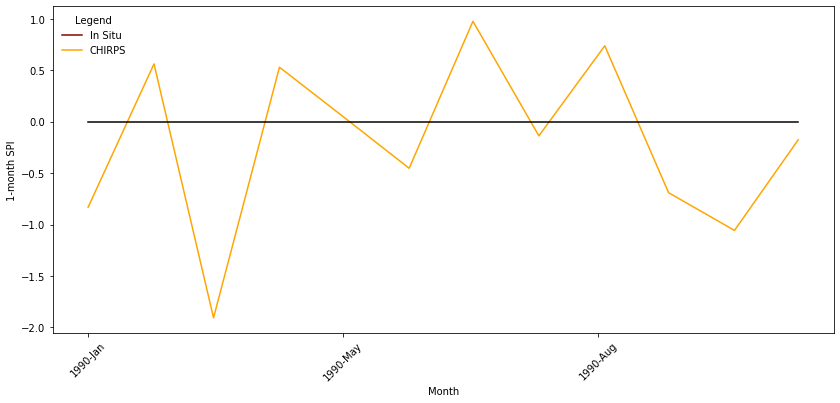

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:225: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


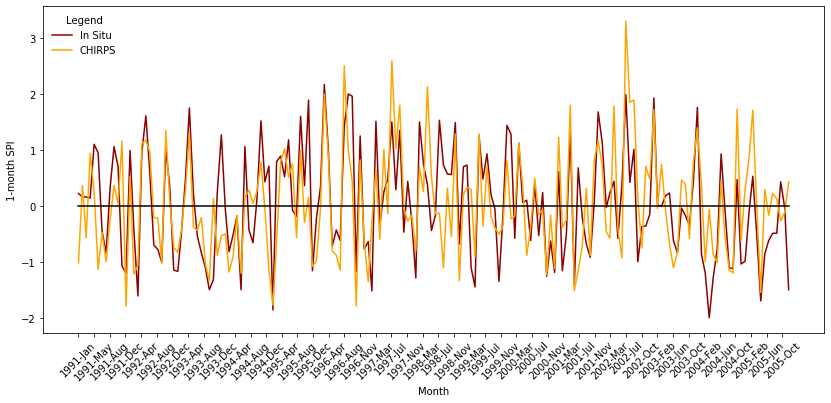

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:279: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


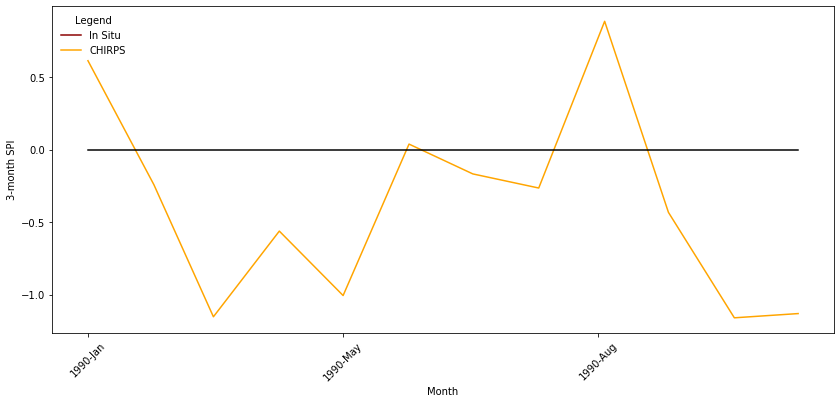

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:326: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


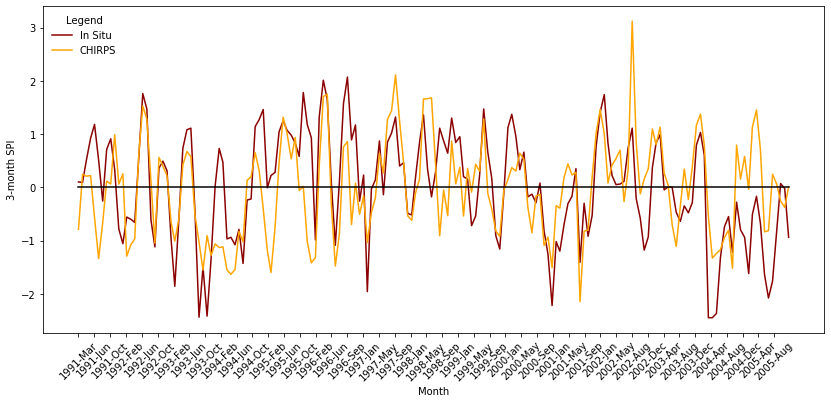

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:380: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


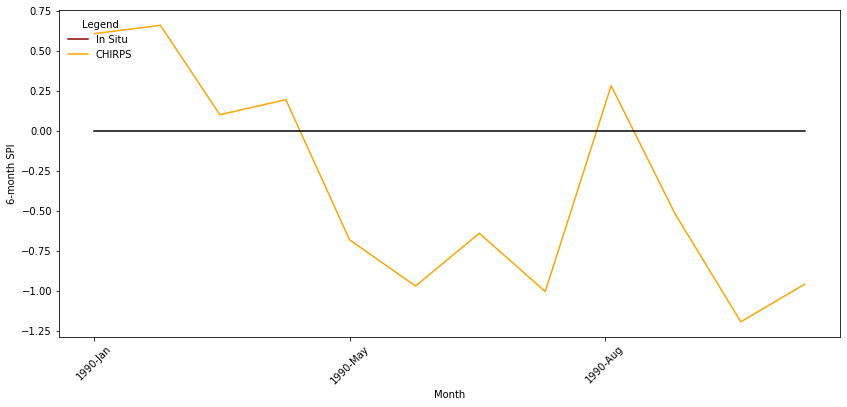

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:427: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


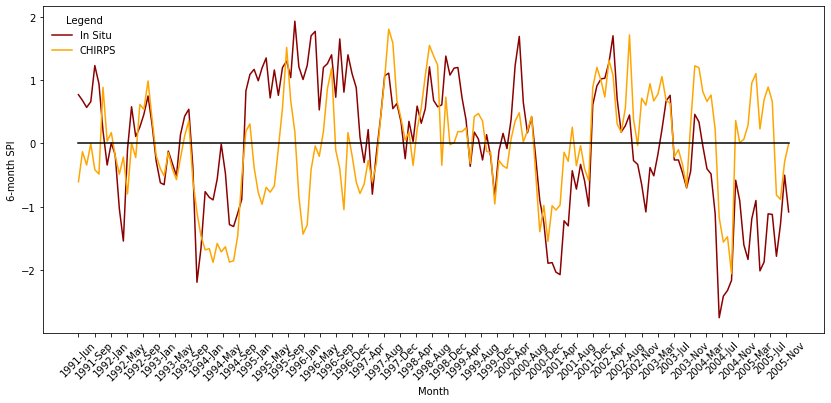

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:481: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


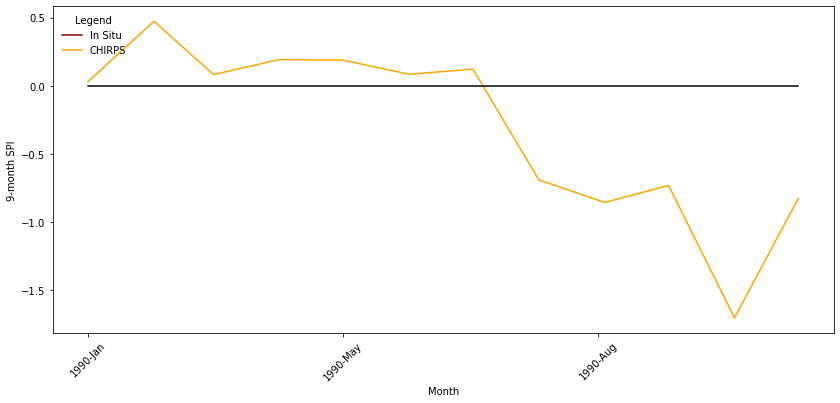

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


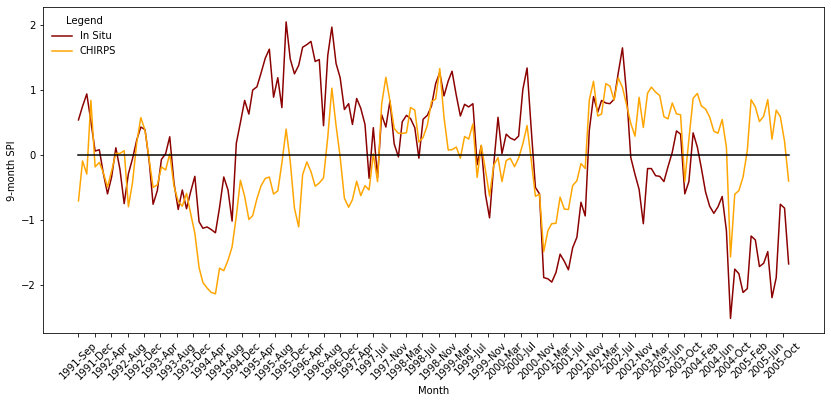

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:582: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


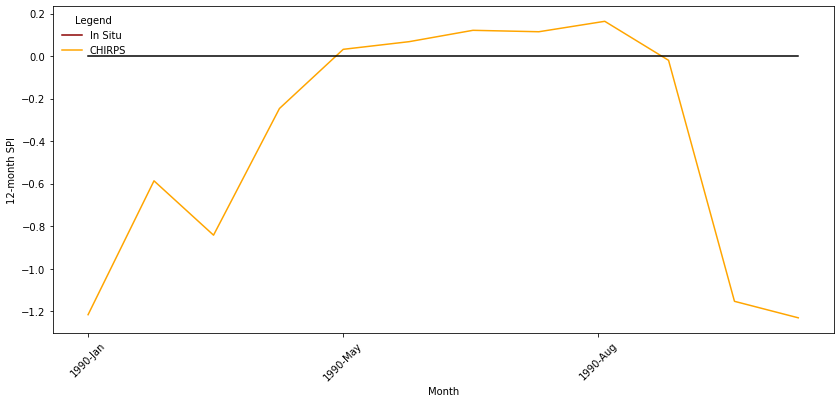

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:629: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


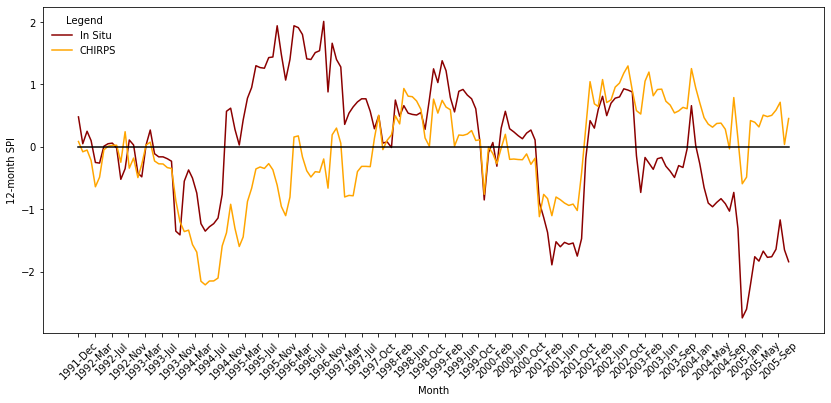

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:683: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


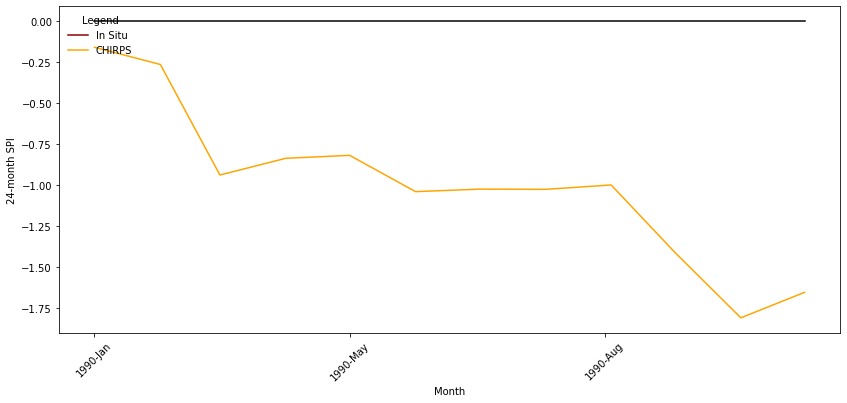

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:730: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


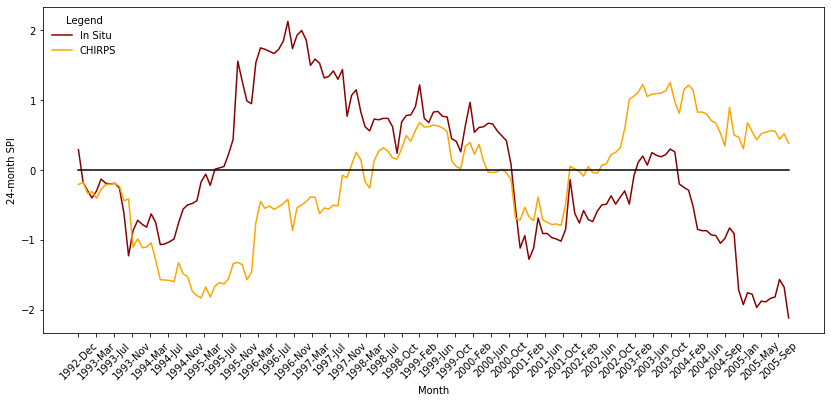

In [98]:
#########################################################################################################

##### load Yonca's SPI data

spi_file_name = 'Yonca_SPI_Data/'+name+'.csv'
yonca_SPI = pd.read_csv(spi_file_name)
yonca_SPI["yearmonth"] = yonca_SPI["Year"].astype(str) + '-' + yonca_SPI["Month"].astype(str)
replace_value = yonca_SPI['SPI24'].iloc[0]
yonca_SPI = yonca_SPI.replace(replace_value,np.nan)
yonca_SPI.head()
#print(replace_value)


#########################################################################################################

####### calculate SPI from CHIRPS 


rainfall_data = chirps.sort_values('date') 

spi = SPI()

#### 1-month 

df_spi_1 = spi.calculate(
    rainfall_data, 
    'date', 
    'chirps', 
    freq="M", 
    scale=1, 
    fit_type="lmom", 
    dist_type="gam"
)

df_spi_1 = df_spi_1.drop(columns=['chirps'])
df_spi_1 = df_spi_1.set_index('date')
df_spi_1.columns = ['SPI1_C']
#df_spi_1.head()


#### 3-month

df_spi_3 = spi.calculate(
    rainfall_data, 
    'date', 
    'chirps', 
    freq="M", 
    scale=3, 
    fit_type="lmom", 
    dist_type="gam"
)

df_spi_3 = df_spi_3.drop(columns=['chirps_scale_3'])
df_spi_3 = df_spi_3.set_index('date')
df_spi_3.columns = ['SPI3_C']
#df_spi_3.head()

### 6-months 

df_spi_6 = spi.calculate(
    rainfall_data, 
    'date', 
    'chirps', 
    freq="M", 
    scale=6, 
    fit_type="lmom", 
    dist_type="gam"
)

df_spi_6 = df_spi_6.drop(columns=['chirps_scale_6'])
df_spi_6 = df_spi_6.set_index('date')
df_spi_6.columns = ['SPI6_C']
#df_spi_6.head(10)

#### 9-month 

df_spi_9 = spi.calculate(
    rainfall_data, 
    'date', 
    'chirps', 
    freq="M", 
    scale=9, 
    fit_type="lmom", 
    dist_type="gam"
)

df_spi_9 = df_spi_9.drop(columns=['chirps_scale_9'])
df_spi_9 = df_spi_9.set_index('date')
df_spi_9.columns = ['SPI9_C']
#df_spi_9.head(10)

##### 12-month 

df_spi_12 = spi.calculate(
    rainfall_data, 
    'date', 
    'chirps', 
    freq="M", 
    scale=12, 
    fit_type="lmom", 
    dist_type="gam"
)

df_spi_12 = df_spi_12.drop(columns=['chirps_scale_12'])
df_spi_12 = df_spi_12.set_index('date')
df_spi_12.columns = ['SPI12_C']
#df_spi_12.head(10)

#### 24-month

df_spi_24 = spi.calculate(
    rainfall_data, 
    'date', 
    'chirps', 
    freq="M", 
    scale=24, 
    fit_type="lmom", 
    dist_type="gam"
)

df_spi_24 = df_spi_24.drop(columns=['chirps_scale_24'])
df_spi_24 = df_spi_24.set_index('date')
df_spi_24.columns = ['SPI24_C']
#df_spi_24.head(10)

spi_indices = df_spi_1.merge(df_spi_3, how='inner', left_index=True, right_index=True).merge(df_spi_6, how='inner', left_index=True, right_index=True).merge(df_spi_9, how='inner', left_index=True, right_index=True).merge(df_spi_12, how='inner', left_index=True, right_index=True).merge(df_spi_24, how='inner', left_index=True, right_index=True)
spi_indices.head()

#########################################################################################################

### merge the two dataframes 

spi_indices['date'] = spi_indices.index
spi_indices['date'] = pd.to_datetime(spi_indices['date'])
spi_indices['year'] = spi_indices['date'].dt.strftime('%Y').astype(int).astype(str) 
spi_indices['month'] = spi_indices['date'].dt.strftime('%m').astype(int).astype(str) 
spi_indices['date'] = spi_indices['date'].dt.strftime('%Y-%m')
spi_indices['yearmonth'] = spi_indices["year"] + '-' + spi_indices["month"].astype(str)
spi_indices = spi_indices.set_index('yearmonth')

yonca_SPI = yonca_SPI.drop(columns=['Year', 'Month'])
yonca_SPI = yonca_SPI.set_index('yearmonth')

spi_all = spi_indices.merge(yonca_SPI, how='outer', right_index=True, left_index=True)
spi_all = spi_all.set_index('date')
spi_all = spi_all.sort_index()
spi_all.head()

### save the complete file 
spi_all_filename = figname = 'spi_comparison/SPI1/'+name+'.csv'
spi_all.to_csv(spi_all_filename)

#### isolate index pairs for RMSE calculation and graphics 

spi_all_1 = spi_all.drop(columns=['SPI3', 'SPI3_C', 'SPI6', 'SPI6_C', 'SPI9', 'SPI9_C', 'SPI12', 'SPI12_C', 'SPI24', 'SPI24_C'])#.dropna()
spi_all_3 = spi_all.drop(columns=['SPI1', 'SPI1_C', 'SPI6', 'SPI6_C', 'SPI9', 'SPI9_C', 'SPI12', 'SPI12_C', 'SPI24', 'SPI24_C'])#.dropna()
spi_all_6 = spi_all.drop(columns=['SPI3', 'SPI3_C', 'SPI1', 'SPI1_C', 'SPI9', 'SPI9_C', 'SPI12', 'SPI12_C', 'SPI24', 'SPI24_C'])#.dropna()
spi_all_9 = spi_all.drop(columns=['SPI3', 'SPI3_C', 'SPI6', 'SPI6_C', 'SPI1', 'SPI1_C', 'SPI12', 'SPI12_C', 'SPI24', 'SPI24_C'])#.dropna()
spi_all_12 = spi_all.drop(columns=['SPI3', 'SPI3_C', 'SPI6', 'SPI6_C', 'SPI9', 'SPI9_C', 'SPI1', 'SPI1_C', 'SPI24', 'SPI24_C'])#.dropna()
spi_all_24 = spi_all.drop(columns=['SPI3', 'SPI3_C', 'SPI6', 'SPI6_C', 'SPI9', 'SPI9_C', 'SPI12', 'SPI12_C', 'SPI1', 'SPI1_C'])#.dropna()


#########################################################################################################
### plots 
#########################################################################################################

#### SPI1 

### plot the difference in 1990 

# plot and save graph: comparison of one-month SPI 

# Initialise the figure and axes.
fig, ax = plt.subplots(1, figsize=(14, 6))

spi_all_1_90s = spi_all_1[(spi_all_1.index>'1989-12')&(spi_all_1.index<'1991-01')]

spi_all_1_90s['baseline'] = 0

# define axes 
y1 = spi_all_1_90s['SPI1']
y2 = spi_all_1_90s['SPI1_C']
y3 = spi_all_1_90s['baseline']

x = date2num(pd.to_datetime(spi_all_1_90s.index))

ax.plot(x, y1, color="darkred", label="In Situ")
ax.plot(x, y2, color="orange", label="CHIRPS")
ax.plot(x, y3, color='black')

plt.legend(loc="upper left", title="Legend", frameon=False)

plt.xlabel("Month")
plt.ylabel("1-month SPI")

axes = plt.gca()
#axes.set_xlim(["2020-09-30","2020-11-02"])
#axes.set_ylim([-2,600]) 
#axes.get_yaxis().set_visible(False)
ax.xaxis_date()

myFmt = mdates.DateFormatter('%Y-%b')

ax.xaxis.set_major_formatter(myFmt)

plt.xticks(rotation = 45)

plt.xticks(np.arange(min(x), max(x)+1, 120.0))

plt.show()
           
figname = 'spi_comparison/SPI1/90s'+name+'.png'

fig.savefig(figname, dpi=100)

### plot the difference over the entire period for which both datasets are available and calculate rmse

# plot and save graph: comparison of one-month SPI 

# Initialise the figure and axes.
fig, ax = plt.subplots(1, figsize=(14, 6))

spi_all_1_full = spi_all_1.dropna()

spi_all_1_full['baseline'] = 0

# define axes 
y1 = spi_all_1_full['SPI1']
y2 = spi_all_1_full['SPI1_C']
y3 = spi_all_1_full['baseline']

x = date2num(pd.to_datetime(spi_all_1_full.index))

ax.plot(x, y1, color="darkred", label="In Situ")
ax.plot(x, y2, color="orange", label="CHIRPS")
ax.plot(x, y3, color='black')

plt.legend(loc="upper left", title="Legend", frameon=False)

plt.xlabel("Month")
plt.ylabel("1-month SPI")

axes = plt.gca()
#axes.set_xlim(["2020-09-30","2020-11-02"])
#axes.set_ylim([-2,600]) 
#axes.get_yaxis().set_visible(False)
ax.xaxis_date()

myFmt = mdates.DateFormatter('%Y-%b')

ax.xaxis.set_major_formatter(myFmt)

plt.xticks(rotation = 45)

plt.xticks(np.arange(min(x), max(x)+1, 120.0))

plt.show()
           
figname = 'spi_comparison/SPI1/all_available'+name+'.png'

fig.savefig(figname, dpi=100)

mse_spi1 = sklearn.metrics.mean_squared_error(spi_all_1_full['SPI1'], spi_all_1_full['SPI1_C'])

rmse_spi1 = math.sqrt(mse_spi1)

#########################################################################################################
#### SPI 3 

### plot the difference in 1990 

# plot and save graph: comparison of one-month SPI 

# Initialise the figure and axes.
fig, ax = plt.subplots(1, figsize=(14, 6))

spi_all_3_90s = spi_all_3[(spi_all_3.index>'1989-12')&(spi_all_3.index<'1991-01')]

spi_all_3_90s['baseline'] = 0

# define axes 
y1 = spi_all_3_90s['SPI3']
y2 = spi_all_3_90s['SPI3_C']
y3 = spi_all_3_90s['baseline']

x = date2num(pd.to_datetime(spi_all_3_90s.index))

ax.plot(x, y1, color="darkred", label="In Situ")
ax.plot(x, y2, color="orange", label="CHIRPS")
ax.plot(x, y3, color='black')

plt.legend(loc="upper left", title="Legend", frameon=False)

plt.xlabel("Month")
plt.ylabel("3-month SPI")

axes = plt.gca()
#axes.set_xlim(["2020-09-30","2020-11-02"])
#axes.set_ylim([-2,600]) 
#axes.get_yaxis().set_visible(False)
ax.xaxis_date()

myFmt = mdates.DateFormatter('%Y-%b')

ax.xaxis.set_major_formatter(myFmt)

plt.xticks(rotation = 45)

plt.xticks(np.arange(min(x), max(x)+1, 120.0))

plt.show()
           
figname = 'spi_comparison/SPI3/90s'+name+'.png'

fig.savefig(figname, dpi=100)

### plot the difference over the entire period for which both datasets are available and calculate rmse

# plot and save graph: comparison of one-month SPI 

# Initialise the figure and axes.
fig, ax = plt.subplots(1, figsize=(14, 6))

spi_all_3_full = spi_all_3.dropna()

spi_all_3_full['baseline'] = 0

# define axes 
y1 = spi_all_3_full['SPI3']
y2 = spi_all_3_full['SPI3_C']
y3 = spi_all_3_full['baseline']

x = date2num(pd.to_datetime(spi_all_3_full.index))

ax.plot(x, y1, color="darkred", label="In Situ")
ax.plot(x, y2, color="orange", label="CHIRPS")
ax.plot(x, y3, color='black')

plt.legend(loc="upper left", title="Legend", frameon=False)

plt.xlabel("Month")
plt.ylabel("3-month SPI")

axes = plt.gca()
#axes.set_xlim(["2020-09-30","2020-11-02"])
#axes.set_ylim([-2,600]) 
#axes.get_yaxis().set_visible(False)
ax.xaxis_date()

myFmt = mdates.DateFormatter('%Y-%b')

ax.xaxis.set_major_formatter(myFmt)

plt.xticks(rotation = 45)

plt.xticks(np.arange(min(x), max(x)+1, 120.0))

plt.show()
           
figname = 'spi_comparison/SPI3/all_available'+name+'.png'

fig.savefig(figname, dpi=100)

mse_spi3 = sklearn.metrics.mean_squared_error(spi_all_3_full['SPI3'], spi_all_3_full['SPI3_C'])

rmse_spi3 = math.sqrt(mse_spi3)

#########################################################################################################
#### SPI 6

### plot the difference in 1990 

# plot and save graph: comparison of one-month SPI 

# Initialise the figure and axes.
fig, ax = plt.subplots(1, figsize=(14, 6))

spi_all_6_90s = spi_all_6[(spi_all_6.index>'1989-12')&(spi_all_6.index<'1991-01')]

spi_all_6_90s['baseline'] = 0

# define axes 
y1 = spi_all_6_90s['SPI6']
y2 = spi_all_6_90s['SPI6_C']
y3 = spi_all_6_90s['baseline']

x = date2num(pd.to_datetime(spi_all_6_90s.index))

ax.plot(x, y1, color="darkred", label="In Situ")
ax.plot(x, y2, color="orange", label="CHIRPS")
ax.plot(x, y3, color='black')

plt.legend(loc="upper left", title="Legend", frameon=False)

plt.xlabel("Month")
plt.ylabel("6-month SPI")

axes = plt.gca()
#axes.set_xlim(["2020-09-30","2020-11-02"])
#axes.set_ylim([-2,600]) 
#axes.get_yaxis().set_visible(False)
ax.xaxis_date()

myFmt = mdates.DateFormatter('%Y-%b')

ax.xaxis.set_major_formatter(myFmt)

plt.xticks(rotation = 45)

plt.xticks(np.arange(min(x), max(x)+1, 120.0))

plt.show()
           
figname = 'spi_comparison/SPI6/90s'+name+'.png'

fig.savefig(figname, dpi=100)

### plot the difference over the entire period for which both datasets are available and calculate rmse

# plot and save graph: comparison of one-month SPI 

# Initialise the figure and axes.
fig, ax = plt.subplots(1, figsize=(14, 6))

spi_all_6_full = spi_all_6.dropna()

spi_all_6_full['baseline'] = 0

# define axes 
y1 = spi_all_6_full['SPI6']
y2 = spi_all_6_full['SPI6_C']
y3 = spi_all_6_full['baseline']

x = date2num(pd.to_datetime(spi_all_6_full.index))

ax.plot(x, y1, color="darkred", label="In Situ")
ax.plot(x, y2, color="orange", label="CHIRPS")
ax.plot(x, y3, color='black')

plt.legend(loc="upper left", title="Legend", frameon=False)

plt.xlabel("Month")
plt.ylabel("6-month SPI")

axes = plt.gca()
#axes.set_xlim(["2020-09-30","2020-11-02"])
#axes.set_ylim([-2,600]) 
#axes.get_yaxis().set_visible(False)
ax.xaxis_date()

myFmt = mdates.DateFormatter('%Y-%b')

ax.xaxis.set_major_formatter(myFmt)

plt.xticks(rotation = 45)

plt.xticks(np.arange(min(x), max(x)+1, 120.0))

plt.show()
           
figname = 'spi_comparison/SPI6/all_available'+name+'.png'

fig.savefig(figname, dpi=100)

mse_spi6 = sklearn.metrics.mean_squared_error(spi_all_6_full['SPI6'], spi_all_6_full['SPI6_C'])

rmse_spi6 = math.sqrt(mse_spi6)

#########################################################################################################
#### SPI 9

### plot the difference in 1990 

# plot and save graph: comparison of one-month SPI 

# Initialise the figure and axes.
fig, ax = plt.subplots(1, figsize=(14, 6))

spi_all_9_90s = spi_all_9[(spi_all_9.index>'1989-12')&(spi_all_9.index<'1991-01')]

spi_all_9_90s['baseline'] = 0

# define axes 
y1 = spi_all_9_90s['SPI9']
y2 = spi_all_9_90s['SPI9_C']
y3 = spi_all_9_90s['baseline']

x = date2num(pd.to_datetime(spi_all_9_90s.index))

ax.plot(x, y1, color="darkred", label="In Situ")
ax.plot(x, y2, color="orange", label="CHIRPS")
ax.plot(x, y3, color='black')

plt.legend(loc="upper left", title="Legend", frameon=False)

plt.xlabel("Month")
plt.ylabel("9-month SPI")

axes = plt.gca()
#axes.set_xlim(["2020-09-30","2020-11-02"])
#axes.set_ylim([-2,900]) 
#axes.get_yaxis().set_visible(False)
ax.xaxis_date()

myFmt = mdates.DateFormatter('%Y-%b')

ax.xaxis.set_major_formatter(myFmt)

plt.xticks(rotation = 45)

plt.xticks(np.arange(min(x), max(x)+1, 120.0))

plt.show()
           
figname = 'spi_comparison/SPI9/90s'+name+'.png'

fig.savefig(figname, dpi=100)

### plot the difference over the entire period for which both datasets are available and calculate rmse

# plot and save graph: comparison of one-month SPI 

# Initialise the figure and axes.
fig, ax = plt.subplots(1, figsize=(14, 6))

spi_all_9_full = spi_all_9.dropna()

spi_all_9_full['baseline'] = 0

# define axes 
y1 = spi_all_9_full['SPI9']
y2 = spi_all_9_full['SPI9_C']
y3 = spi_all_9_full['baseline']

x = date2num(pd.to_datetime(spi_all_9_full.index))

ax.plot(x, y1, color="darkred", label="In Situ")
ax.plot(x, y2, color="orange", label="CHIRPS")
ax.plot(x, y3, color='black')

plt.legend(loc="upper left", title="Legend", frameon=False)

plt.xlabel("Month")
plt.ylabel("9-month SPI")

axes = plt.gca()
#axes.set_xlim(["2020-09-30","2020-11-02"])
#axes.set_ylim([-2,900]) 
#axes.get_yaxis().set_visible(False)
ax.xaxis_date()

myFmt = mdates.DateFormatter('%Y-%b')

ax.xaxis.set_major_formatter(myFmt)

plt.xticks(rotation = 45)

plt.xticks(np.arange(min(x), max(x)+1, 120.0))

plt.show()
           
figname = 'spi_comparison/SPI9/all_available'+name+'.png'

fig.savefig(figname, dpi=100)

mse_spi9 = sklearn.metrics.mean_squared_error(spi_all_9_full['SPI9'], spi_all_9_full['SPI9_C'])

rmse_spi9 = math.sqrt(mse_spi9)

#########################################################################################################
#### SPI 12

### plot the difference in 1990 

# plot and save graph: comparison of one-month SPI 

# Initialise the figure and axes.
fig, ax = plt.subplots(1, figsize=(14, 6))

spi_all_12_90s = spi_all_12[(spi_all_12.index>'1989-12')&(spi_all_12.index<'1991-01')]

spi_all_12_90s['baseline'] = 0

# define axes 
y1 = spi_all_12_90s['SPI12']
y2 = spi_all_12_90s['SPI12_C']
y3 = spi_all_12_90s['baseline']

x = date2num(pd.to_datetime(spi_all_12_90s.index))

ax.plot(x, y1, color="darkred", label="In Situ")
ax.plot(x, y2, color="orange", label="CHIRPS")
ax.plot(x, y3, color='black')

plt.legend(loc="upper left", title="Legend", frameon=False)

plt.xlabel("Month")
plt.ylabel("12-month SPI")

axes = plt.gca()
#axes.set_xlim(["2020-09-30","2020-11-02"])
#axes.set_ylim([-2,1200]) 
#axes.get_yaxis().set_visible(False)
ax.xaxis_date()

myFmt = mdates.DateFormatter('%Y-%b')

ax.xaxis.set_major_formatter(myFmt)

plt.xticks(rotation = 45)

plt.xticks(np.arange(min(x), max(x)+1, 120.0))

plt.show()
           
figname = 'spi_comparison/SPI12/90s'+name+'.png'

fig.savefig(figname, dpi=100)

### plot the difference over the entire period for which both datasets are available and calculate rmse

# plot and save graph: comparison of one-month SPI 

# Initialise the figure and axes.
fig, ax = plt.subplots(1, figsize=(14, 6))

spi_all_12_full = spi_all_12.dropna()

spi_all_12_full['baseline'] = 0

# define axes 
y1 = spi_all_12_full['SPI12']
y2 = spi_all_12_full['SPI12_C']
y3 = spi_all_12_full['baseline']

x = date2num(pd.to_datetime(spi_all_12_full.index))

ax.plot(x, y1, color="darkred", label="In Situ")
ax.plot(x, y2, color="orange", label="CHIRPS")
ax.plot(x, y3, color='black')

plt.legend(loc="upper left", title="Legend", frameon=False)

plt.xlabel("Month")
plt.ylabel("12-month SPI")

axes = plt.gca()
#axes.set_xlim(["2020-09-30","2020-11-02"])
#axes.set_ylim([-2,1200]) 
#axes.get_yaxis().set_visible(False)
ax.xaxis_date()

myFmt = mdates.DateFormatter('%Y-%b')

ax.xaxis.set_major_formatter(myFmt)

plt.xticks(rotation = 45)

plt.xticks(np.arange(min(x), max(x)+1, 120.0))

plt.show()
           
figname = 'spi_comparison/SPI12/all_available'+name+'.png'

fig.savefig(figname, dpi=100)

mse_spi12 = sklearn.metrics.mean_squared_error(spi_all_12_full['SPI12'], spi_all_12_full['SPI12_C'])

rmse_spi12 = math.sqrt(mse_spi12)

#########################################################################################################
#### SPI 24

### plot the difference in 1990 

# plot and save graph: comparison of one-month SPI 

# Initialise the figure and axes.
fig, ax = plt.subplots(1, figsize=(14, 6))

spi_all_24_90s = spi_all_24[(spi_all_24.index>'1989-12')&(spi_all_24.index<'1991-01')]

spi_all_24_90s['baseline'] = 0

# define axes 
y1 = spi_all_24_90s['SPI24']
y2 = spi_all_24_90s['SPI24_C']
y3 = spi_all_24_90s['baseline']

x = date2num(pd.to_datetime(spi_all_24_90s.index))

ax.plot(x, y1, color="darkred", label="In Situ")
ax.plot(x, y2, color="orange", label="CHIRPS")
ax.plot(x, y3, color='black')

plt.legend(loc="upper left", title="Legend", frameon=False)

plt.xlabel("Month")
plt.ylabel("24-month SPI")

axes = plt.gca()
#axes.set_xlim(["2020-09-30","2020-11-02"])
#axes.set_ylim([-2,2400]) 
#axes.get_yaxis().set_visible(False)
ax.xaxis_date()

myFmt = mdates.DateFormatter('%Y-%b')

ax.xaxis.set_major_formatter(myFmt)

plt.xticks(rotation = 45)

plt.xticks(np.arange(min(x), max(x)+1, 120.0))

plt.show()
           
figname = 'spi_comparison/SPI24/90s'+name+'.png'

fig.savefig(figname, dpi=100)

### plot the difference over the entire period for which both datasets are available and calculate rmse

# plot and save graph: comparison of one-month SPI 

# Initialise the figure and axes.
fig, ax = plt.subplots(1, figsize=(14, 6))

spi_all_24_full = spi_all_24.dropna()

spi_all_24_full['baseline'] = 0

# define axes 
y1 = spi_all_24_full['SPI24']
y2 = spi_all_24_full['SPI24_C']
y3 = spi_all_24_full['baseline']

x = date2num(pd.to_datetime(spi_all_24_full.index))

ax.plot(x, y1, color="darkred", label="In Situ")
ax.plot(x, y2, color="orange", label="CHIRPS")
ax.plot(x, y3, color='black')

plt.legend(loc="upper left", title="Legend", frameon=False)

plt.xlabel("Month")
plt.ylabel("24-month SPI")

axes = plt.gca()
#axes.set_xlim(["2020-09-30","2020-11-02"])
#axes.set_ylim([-2,2400]) 
#axes.get_yaxis().set_visible(False)
ax.xaxis_date()

myFmt = mdates.DateFormatter('%Y-%b')

ax.xaxis.set_major_formatter(myFmt)

plt.xticks(rotation = 45)

plt.xticks(np.arange(min(x), max(x)+1, 120.0))

plt.show()
           
figname = 'spi_comparison/SPI24/all_available'+name+'.png'

fig.savefig(figname, dpi=100)

mse_spi24 = sklearn.metrics.mean_squared_error(spi_all_24_full['SPI24'], spi_all_24_full['SPI24_C'])

rmse_spi24 = math.sqrt(mse_spi24)


In [6]:
insitu = pd.read_csv('/Users/vindobonensis/Documents/PhD/Yonca/Yonca_Precipitation/'+name+'.csv')
insitu["yearmonth"] = insitu["YEAR"].astype(str) + '-' + insitu["MONTH"].astype(str)
insitu = insitu.set_index('yearmonth')
insitu = insitu.drop(columns=['YEAR', 'MONTH'])
insitu.columns = ['insitu']
insitu = insitu.sort_index()
insitu.head()

,insitu
yearmonth,
1991-1,111.3
1991-10,131.9
1991-11,177.7
1991-12,29.3
1991-2,96.3


In [7]:
precipitation = insitu.merge(chirps, how='inner', left_index=True, right_index=True)
precipitation['date'] = pd.to_datetime(precipitation['date']).dt.strftime('%Y-%m')
precipitation = precipitation.set_index('date')
precipitation['month'] = precipitation['month'].astype(float)
precipitation = precipitation.sort_index()
precipitation['chirps'] = precipitation['chirps'].round(1)
precipitation.head()


,insitu,chirps,year,month
date,,,,
1998-01,39.6,37.7,1998,1.0
1998-02,30.9,43.8,1998,2.0
1998-03,109.4,90.6,1998,3.0
1998-04,65.8,60.0,1998,4.0
1998-05,110.4,95.7,1998,5.0


In [8]:
# aggregate by yearly sum 

years = precipitation.groupby('year').agg({'insitu':['sum'],'chirps':['sum']})
years.columns = ['insitu', 'chirps']
years.head()


,insitu,chirps
year,,
1998,653.2,594.2
1999,312.0,461.7
2000,560.7,486.0
2001,504.6,571.5
2002,582.2,560.3


In [9]:
# aggregate by monthly averages 

months = precipitation.groupby('month').agg({'insitu':['mean'],'chirps':['mean']})
months.columns = ['insitu', 'chirps']
months = months.round(1)
months.head()

,insitu,chirps
month,,
1.0,74.6,60.1
2.0,68.5,57.3
3.0,68.2,77.1
4.0,62.3,59.2
5.0,55.1,57.2


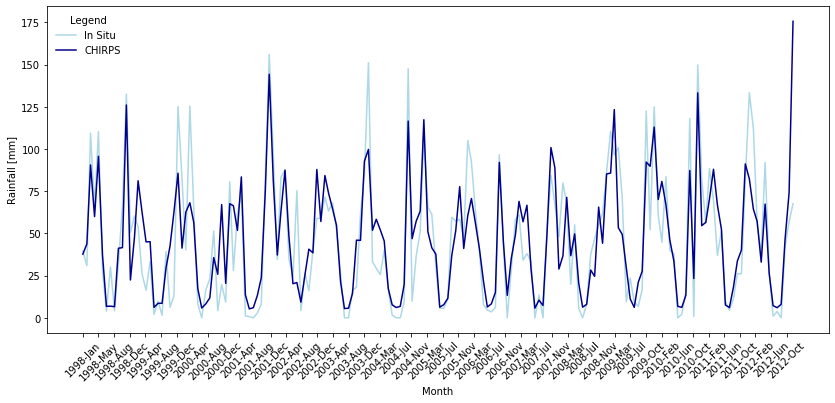

In [10]:
# plot and save graph: overall comparison 

# plot and save graph: year comparison 

# Initialise the figure and axes.
fig, ax = plt.subplots(1, figsize=(14, 6))

# define axes 
y1 = precipitation['insitu']
y2 = precipitation['chirps'] 

x = date2num(pd.to_datetime(precipitation.index))

ax.plot(x, y1, color="lightblue", label="In Situ")
ax.plot(x, y2, color="darkblue", label="CHIRPS")

plt.legend(loc="upper left", title="Legend", frameon=False)

plt.xlabel("Month")
plt.ylabel("Rainfall [mm]")

axes = plt.gca()
#axes.set_xlim(["2020-09-30","2020-11-02"])
#axes.set_ylim([-2,600]) 
#axes.get_yaxis().set_visible(False)
ax.xaxis_date()

myFmt = mdates.DateFormatter('%Y-%b')

ax.xaxis.set_major_formatter(myFmt)

plt.xticks(rotation = 45)

plt.xticks(np.arange(min(x), max(x)+1, 120.0))

plt.show()

fig.savefig('overall_comparison.png', dpi=100)




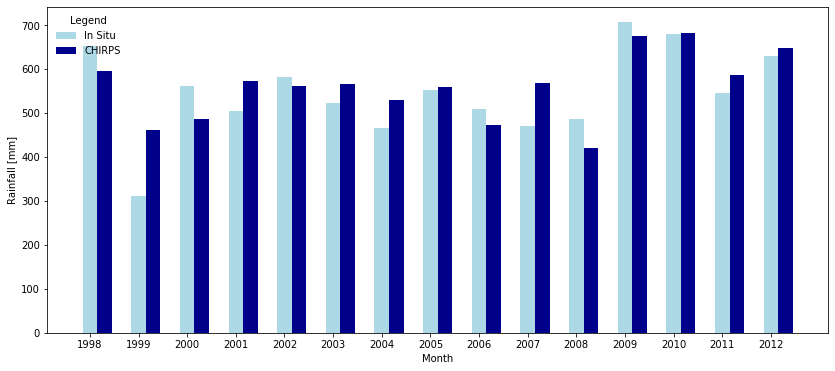

In [11]:
# plot and save graph: year comparison 

# Initialise the figure and axes.
fig, ax = plt.subplots(1, figsize=(14, 6))

# define axes 
y1 = years['insitu']
y2 = years['chirps'] 

x = (years.index).astype(int)

ax.bar(x, y1, width=0.3, color="lightblue", label="In Situ")
ax.bar(x+0.3, y2, width=0.3,  color="darkblue", label="CHIRPS")

plt.legend(loc="upper left", title="Legend", frameon=False)

plt.xlabel("Month")
plt.ylabel("Rainfall [mm]")

plt.xticks(np.arange(min(x), max(x)+1, 1.0))

plt.show()

fig.savefig('yearly_comparison.png', dpi=100)



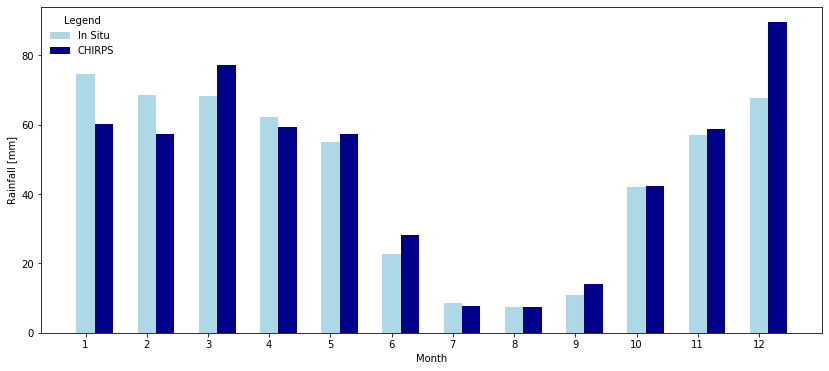

In [87]:
# plot and save graph: month comparison 

# Initialise the figure and axes.
fig, ax = plt.subplots(1, figsize=(14, 6))

# define axes 
y1 = months['insitu']
y2 = months['chirps'] 

x = months.index

ax.bar(x, y1, width=0.3, color="lightblue", label="In Situ")
ax.bar(x+0.3, y2, width=0.3,  color="darkblue", label="CHIRPS")

plt.legend(loc="upper left", title="Legend", frameon=False)


plt.xlabel("Month")
plt.ylabel("Rainfall [mm]")

plt.xticks(np.arange(min(x), max(x)+1, 1.0))

plt.show()

fig.savefig('monthly_comparison.png', dpi=100)


In [101]:
# calculate RMSE and save it to station file 

mse = sklearn.metrics.mean_squared_error(precipitation['insitu'], precipitation['chirps'])

rmse = math.sqrt(mse)

start = precipitation.index[0]

length = len(precipitation)

end = precipitation.index[length-1]


In [102]:
cols = ['station', 'rmse', 'start', 'end']
lst = []
df = pd.DataFrame(lst, columns=cols)

df.head()

,station,rmse,start,end


In [103]:

for i in test: 
    df = df.append(pd.DataFrame({'station': i, 'rmse': rmse , 'start':start, 'end':end}, index=[0]), ignore_index=True)
    

    
    

,station,rmse,start,end
0,1,21.059,1998-01,2012-12
1,2,21.059,1998-01,2012-12
2,3,21.059,1998-01,2012-12
3,4,21.059,1998-01,2012-12
